In [2]:
from joblib import Parallel, delayed
import os
os.environ['R_HOME'] = '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/R'
import rpy2
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.ipython.html
rpy2.ipython.html.init_printing()
from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re
from jpy_tools import loadPkl, toPkl
rBase = importr('base')
rUtils = importr('utils')
dplyr = importr('dplyr')
reticulate = importr('reticulate')
R = ro.r
T = Trl()
R("options(browser='firefox', shiny.port=6533, max.print=200)")
%load_ext rpy2.ipython

cannot import name 'VectorPlotter' from 'seaborn._core' (/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/python3.8/site-packages/seaborn/_core/__init__.py)


2023-11-22 21:41:39.284776: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.



    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

<Figure size 100x100 with 0 Axes>

In [3]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
import matplotlib as mpl
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
import marsilea as ma
import marsilea.plotter as mp
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"
sns.despine(top=True, right=True)
from itertools import product
from functools import reduce
import patchworklib as pw
from jpy_tools.otherTools import pwRecoverSeaborn, pwStack, F, pwShow
pw.show = pwShow
fc_recoverSns = pwRecoverSeaborn()
import seaborn.objects as so
from cycler import cycler
dt_snsStyle = {**sns.axes_style('ticks'), "legend.frameon": False, "axes.spines.top":False, "axes.spines.right":False, "axes.prop_cycle":cycler(color=['grey'])}
so.Plot.config.theme.update(dt_snsStyle)

<Figure size 640x480 with 0 Axes>

In [5]:
import scanpy as sc
import muon as mu
import pandas as pd
import numpy as np
import scipy.sparse as ss
from tqdm import tqdm
from loguru import logger

In [6]:
import pyranges as pr

In [7]:
from jpy_tools import singleCellTools

Global seed set to 0


In [8]:
import seaborn.objects as so

dt_snsStyle = {
    **sns.axes_style("ticks"),
    "axes.spines.top": False,
    "axes.spines.right": False,
}

In [9]:
dir_result = "/data/Zhaijx/liuzj/projects/circadian/03_analysis/"
dir_temp = "/data/Zhaijx/liuzj/projects/singleCell/02_jupyter/circadian/20221122/"

In [10]:
# md = loadPkl('md_20220829_after_diffxpy_marker', lambda **dt:mu.read_h5mu(**dt), arg_path='filename', dir_path=dir_temp)
# ad = md['all']

In [11]:
ls_sample = [8, 10, 12, 14, 16, 18, 20, 22, 24, 2, 4, 6] | F(map, str) | F(list)

In [12]:
dt_sample2Phase = {x: y for x, y in zip(ls_sample, range(0, 26, 2))}
dt_phase2Sample = {y: x for x, y in dt_sample2Phase.items()}

In [13]:
dt_sample2Ct = {x: y for x, y in zip(ls_sample, range(48, 72, 2))}

In [14]:
ad = loadPkl('ad_for_test_clustering_performance', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [ ]:
ad = sc.AnnData()

# split C1

In [13]:
sc.pl.umap(
    ad,
    color = 'leiden'
)

In [59]:
sc.tl.leiden(
    ad,
    restrict_to = ('leiden',['1']),
    key_added = 'leiden_subcluster',
    resolution = 0.1
)
ad

AnnData object with n_obs × n_vars = 131152 × 24503
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', '__group', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Batch_colors', 'CT_colors', 'Cluster_cellexES', 'Cluster_colors', 'Sample_colors', 'celltype_colors', 'hvg', 'leiden', 'leiden_0.15_colors', 'leiden_1.0_colors', 'leiden_co

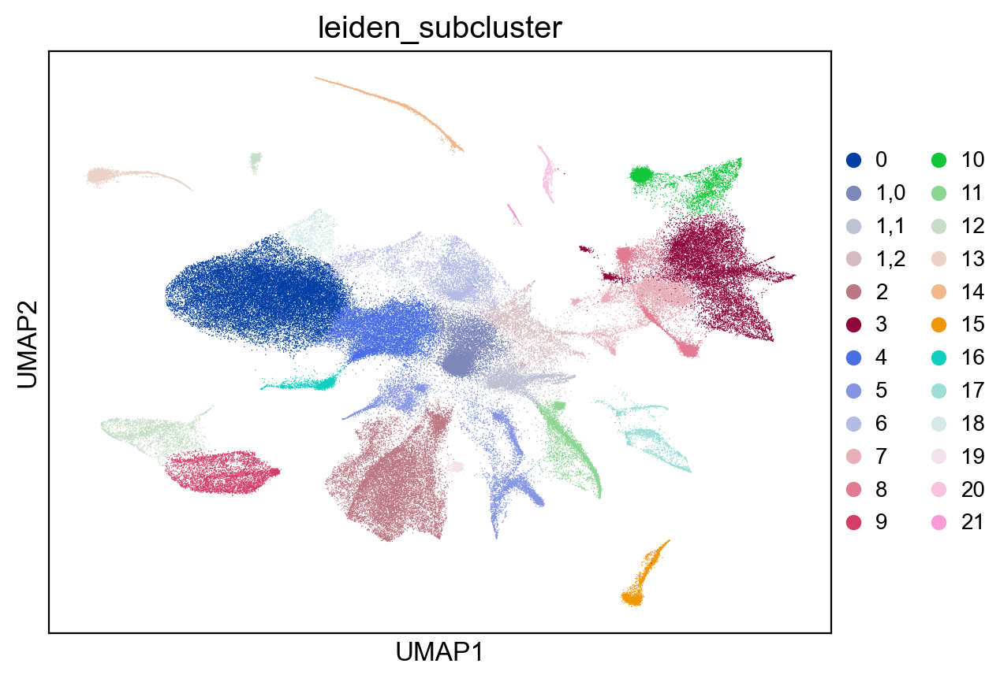

In [15]:
sc.pl.umap(
    ad,
    color = 'leiden_subcluster'
)

Text(0.5, 0, 'Cluster')

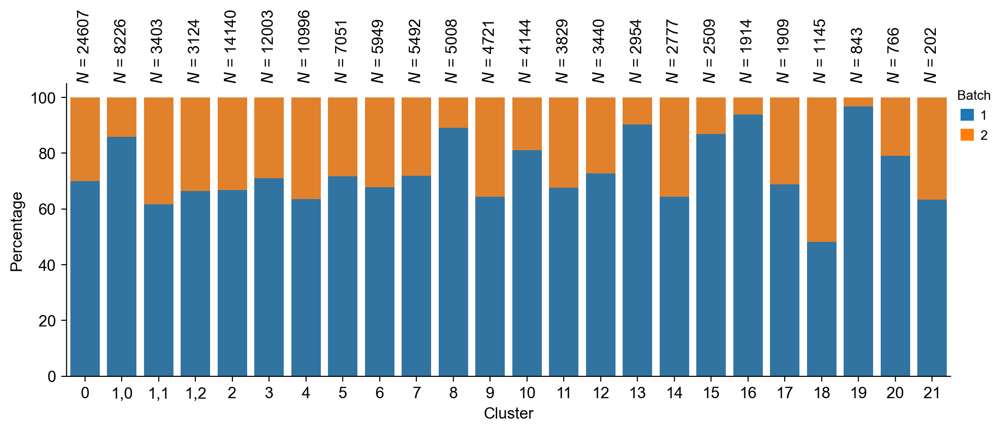

In [52]:
fig, ax = plt.subplots(figsize=(12, 4))
ax = singleCellTools.plotting.plotLabelPercentageInCluster(ad, "leiden_subcluster", "Batch", ax=ax)
ax.get_legend().set(title='Batch')
plt.xlabel("Cluster")

In [13]:
# ad_sct = loadPkl('ad_sct_20230628_after_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)
ad_sct = loadPkl('ad_sct_20230628_after_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [14]:
ad = sc.read_h5ad(f"{dir_result}/0908_c1_split_anno.h5ad")

In [15]:
import importlib
importlib.reload(singleCellTools.others)

<module 'jpy_tools.singleCellTools.others' from '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/python3.8/site-packages/jpy_tools/singleCellTools/others.py'>

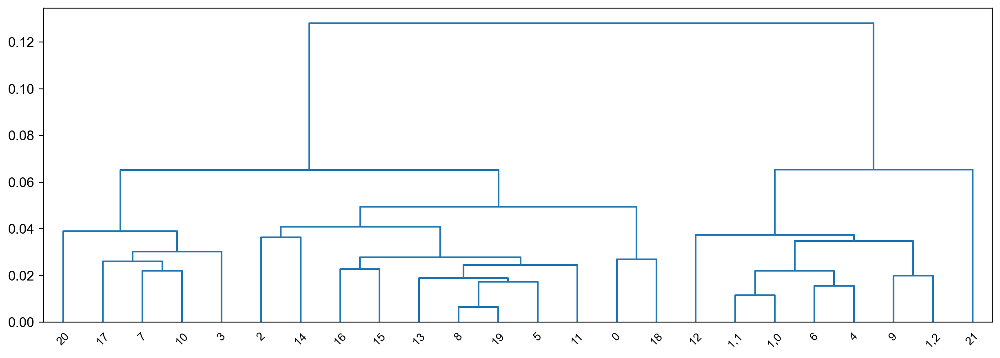

R[write to console]: Warning messages:

R[write to console]: 1: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[write to console]:  sparse->dense coercion: allocating vector of size 1.5 GiB

R[write to console]: 2: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[write to console]:  sparse->dense coercion: allocating vector of size 1.5 GiB

R[write to console]: 3: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[write to console]:  sparse->dense coercion: allocating vector of size 1.5 GiB

R[write to console]: 4: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[write to console]:  sparse->dense coercion: allocating vector of size 1.5 GiB

R[write to console]: 5: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[write to console]:  sparse->dense coercion: allocating vector of size 2.0 GiB

R[write to console]: 6: 
R[write to console]: In asMethod(object) :
R[write to console]: 
 
R[w

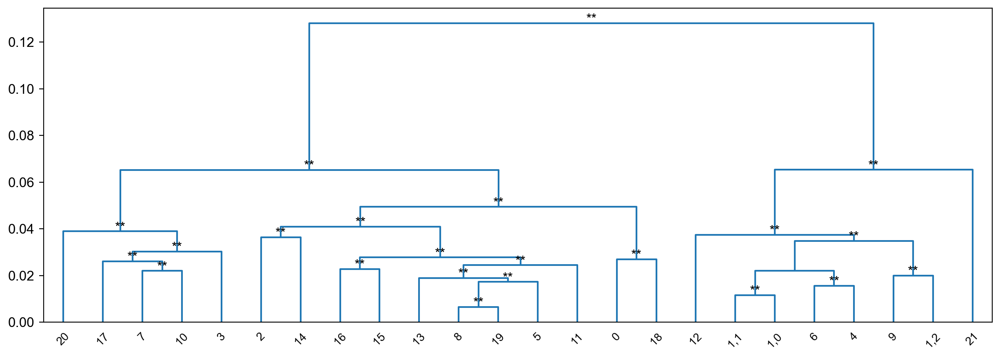

In [16]:
a = singleCellTools.others.calucatePvalueForEachSplitUseScshc(
    ad, ad_sct.var.index.to_list(), 'leiden_subcluster', batchKey='Batch', cores=5
)

In [29]:
import pickle
ad.uns['scshc'] = str(pickle.dumps(a))

In [33]:
toPkl(ad, 'ad_scshc', 'ipf', dir_path=dir_temp)

2023-11-20 15:41:33.572 | INFO     | jpy_tools.otherTools:toPkl:477 - please run `loadPkl('ad_scshc', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


View of AnnData object with n_obs × n_vars = 14753 × 24503
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', '__group', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster', 'recluster_ct', 'temp_batch', 'temp_split'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Batch_colors', 'CT_colors', 'Cluster_cellexES', 'Cluster_colors', 'Sample_colors', 'celltype_colors', 'hvg', 'leiden', 'l

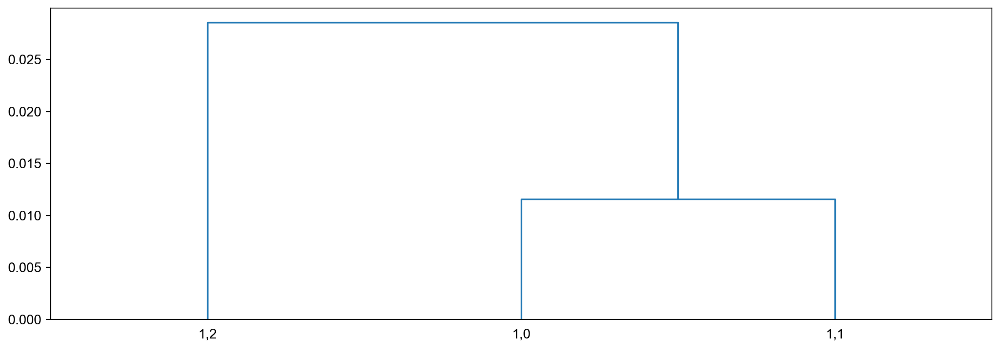

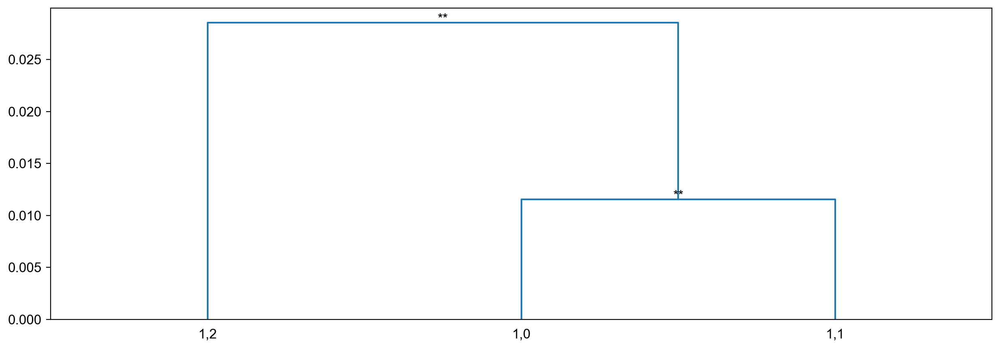

In [41]:
_ls = ['1,0', '1,1', '1,2']
b = singleCellTools.others.calucatePvalueForEachSplitUseScshc(
    ad[ad.obs.eval("leiden_subcluster in @_ls")], ad_sct.var.index.to_list(), 'leiden_subcluster', batchKey='Batch', cores=5
)

In [61]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, "raw", "leiden_subcluster")

In [63]:
def _cutSpecGenes(df, cutoff):
    df = df.query("enrichScore > @cutoff")
    return df.value_counts("leiden_subcluster", sort=False).rename(cutoff)


pd.concat(
    [
        _cutSpecGenes(ad.uns["leiden_subcluster_cellexES"], x)
        for x in (0.8, 0.85, 0.9, 0.95, 0.98, 0.99)
    ],
    axis=1,
)

,0.80,0.85,0.90,0.95,0.98,0.99
leiden_subcluster,,,,,,
0,818,558,315,82,13,2
"1,0",136,72,43,12,3,1
"1,1",421,314,205,81,17,1
"1,2",611,440,274,119,33,10
2,623,437,282,113,22,2
3,846,566,284,84,12,0
4,455,309,177,70,29,13
5,318,249,149,67,14,1
6,336,277,201,109,43,14


In [30]:
ad.uns["leiden_subcluster_cellexES"].to_feather(f"{dir_result}/splitC1_cellex_result.feather")

In [222]:
dt_specGenes = (
    ad.uns["leiden_subcluster_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["leiden_subcluster", "enrichScore"], ascending=[True, False])
    .groupby("leiden_subcluster")["gene"]
    .agg(list)
    .to_dict()
)

In [220]:
ad.uns["leiden_subcluster_cellexES"]\
.query("enrichScore > 0.9")\
.sort_values(["leiden_subcluster", "enrichScore"], ascending=[True, False]).to_csv("/data/Zhaijx/liuzj/projects/circadian/03_analysis/20230906_splitc1_sepc_genes.csv")

In [223]:
dt_geneSetCounts = {x:len(y) for x,y in dt_specGenes.items()}
ls_cluster = dt_specGenes.keys()
ls_genes = sum([dt_specGenes[x] for x in ls_cluster], [])
ls_geneCategory = [[x] * dt_geneSetCounts[x] for x in ls_cluster] >> F(lambda _: sum(_, []))
# _ad = sc.pp.subsample(ad, n_obs=10000, copy=True)
_ad = ad

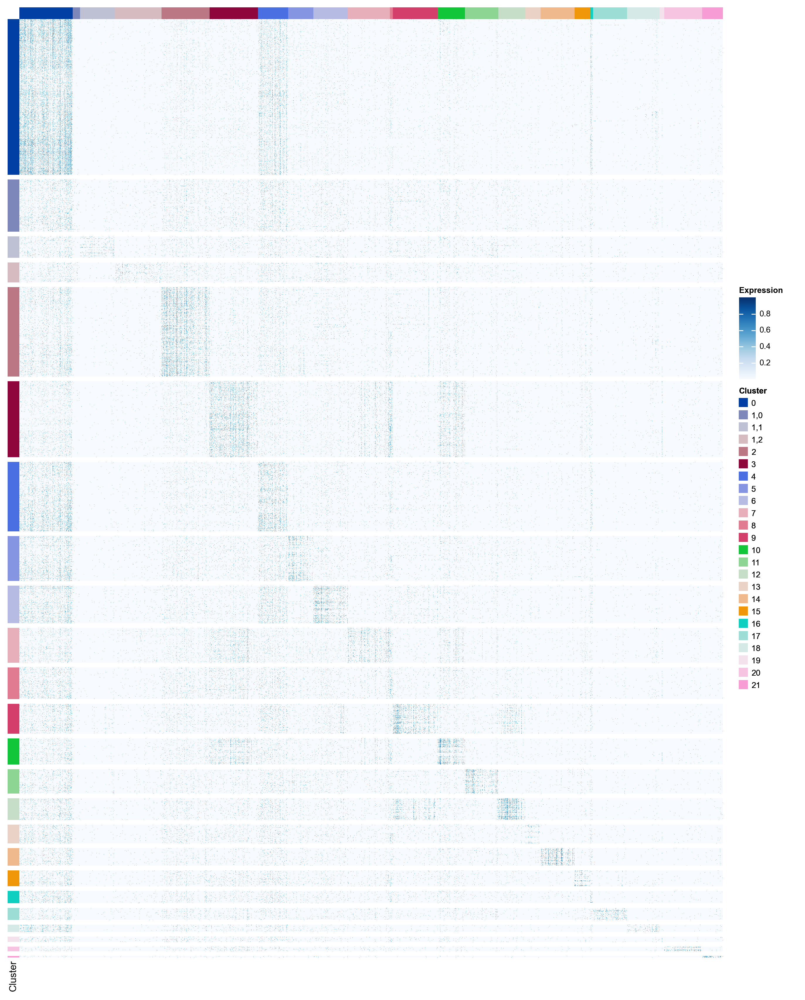

In [224]:

df_mtx = _ad[:, ls_genes].to_df('normalize_log')
df_mtx = df_mtx.pipe(lambda _: (_ - _.min(0)) / (_.max(0) - _.min(0))).fillna(0)
m = ma.Heatmap(df_mtx.values, cmap='Blues', width=12, height=16, label='Expression')
m.hsplit(labels=_ad.obs['leiden_subcluster'], order=_ad.obs['leiden_subcluster'].cat.categories, spacing=0.005)
m.add_left(mp.Colors(data=_ad.obs['leiden_subcluster'], palette=singleCellTools.basic.getadataColor(_ad, 'leiden_subcluster'), label='Cluster'), size=0.2)
m.add_top(mp.Colors(data=ls_geneCategory, palette=singleCellTools.basic.getadataColor(_ad, 'leiden_subcluster')), size=0.2, legend=False)
m.add_legends()
m.render()

In [329]:
ad_pub = sc.read_h5ad(f"{dir_result}/ad_pub_after_calc_sn_auc.h5ad")

In [69]:
dt_pubSpecGenes = (
    ad_pub.uns["pub_cellex_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["celltype", "enrichScore"], ascending=[True, False])
    .groupby("celltype")["gene"]
    .agg(list)
    .to_dict()
)

In [70]:
df_specGeneJarccard = pd.DataFrame(
    index=dt_pubSpecGenes.keys(), columns=dt_specGenes.keys()
)
for k1, v1 in dt_pubSpecGenes.items():
    for k2, v2 in dt_specGenes.items():
        df_specGeneJarccard.loc[k1, k2] = len(set(v1) & set(v2)) / len(
            set(v1) | set(v2)
        )
df_specGeneJarccard = df_specGeneJarccard.astype(float)

In [71]:
ls_geneCat = np.where(df_specGeneJarccard.index.str.contains(":"), "Shoot", "Root")

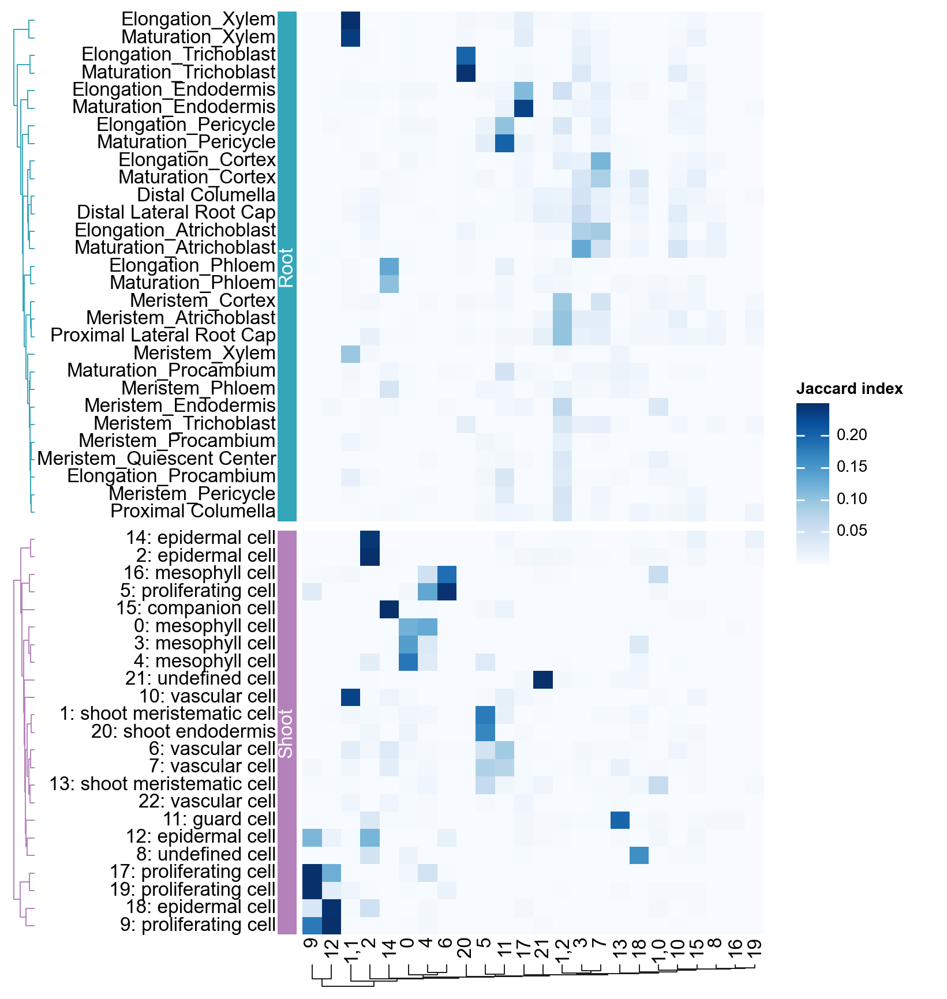

In [305]:
g = ma.Heatmap(
    df_specGeneJarccard.values,
    cmap="Blues",
    width=4,
    height=8,
    vmax=0.25,
    label="Jaccard index",
)

g.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

g.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)
g.add_left(mp.Labels(df_specGeneJarccard.index))

g.add_dendrogram(
    "left",
    colors=["#33A6B8", "#B481BB"],
    method="ward",
    metric="euclidean",
    add_meta=False,
    size=0.2,
)
g.add_bottom(mp.Labels(df_specGeneJarccard.columns))
g.add_dendrogram("bottom", method="ward", metric="euclidean", size=0.2)
g.add_legends(pad=-0.5)

g.render()

In [57]:
dt_anno = {'0': '0: Mesophyll cell (Shoot)',
 '1,0': '1,0: Unknown (Shoot)',
 '1,1': '1,1: Vascular cell (Unknown)',
 '1,2': '1,2: Unknown (Root)',
 '2': '2: Epidermal cell (Shoot)',
 '3': '3: Atrichoblast (Root)',
 '4': '4: Proliferating cell & Mesophyll cell (Shoot)',
 '5': '5: Meristem & Endodermis (Shoot)',
 '6': '6: Proliferating cell & Mesophyll cell (Shoot)',
 '7': '7: Cortex (Root)',
 '8': '8: Unknown (Root)',
 '9': '9: Proliferating cell (Shoot)',
 '10': '10: Unknown (Root)',
 '11': '11: Vascular cell (Unknown)',
 '12': '12: Proliferating cell & Epidermal cell (Shoot)',
 '13': '13: Guard cell (Shoot)',
 '14': '14: Phloem (Unknown)',
 '15': '15: Unknown (Root)',
 '16': '16: Unknown (Shoot)',
 '17': '17: Endodermis (Root)',
 '18': '18: Unknown (Shoot)',
 '19': '19: Epidermal cell (Shoot)',
 '20': '20: Trichoblast (Root)',
 '21': '21: Unknown (Shoot)'}
ad.obs['recluster_ct'] = ad.obs['leiden_subcluster'].map(dt_anno)

In [20]:
dt_annoForPlot = {}
for k, v in dt_anno.items():
    v = v.split(": ")[1]
    _ls = dt_annoForPlot.get(v, [])
    _ls.append(k)
    dt_annoForPlot[v] = _ls

In [21]:
# extract content within "()" in the string
import re
def extract_bracket(s):
    return re.findall('\((.*?)\)', s)[0]
extract_bracket("Proliferating cell & Epidermal cell (Shoot)")

'Shoot'

In [22]:
dt_annoForPlot = {
 'Mesophyll cell (Shoot)': ['0'],
 'Unknown (Shoot)': ['1,0', '16', '18', '21'],
 'Epidermal cell (Shoot)': ['2', '19'],
 'Proliferating cell & Mesophyll cell (Shoot)': ['4', '6'],
 'Meristem & Endodermis (Shoot)': ['5'],
 'Proliferating cell (Shoot)': ['9'],
 'Proliferating cell & Epidermal cell (Shoot)': ['12'],
 'Guard cell (Shoot)': ['13'],
 'Atrichoblast (Root)': ['3'],
 'Cortex (Root)': ['7'],
 'Endodermis (Root)': ['17'],
 'Trichoblast (Root)': ['20'],
  'Unknown (Root)': ['1,2', '8', '10', '15'],
 'Vascular cell (Unknown)': ['1,1', '11', '14']}

In [23]:
import adjustText

In [505]:
dt_colors = singleCellTools.basic.getadataColor(ad, "leiden_subcluster")

In [26]:
import legendkit

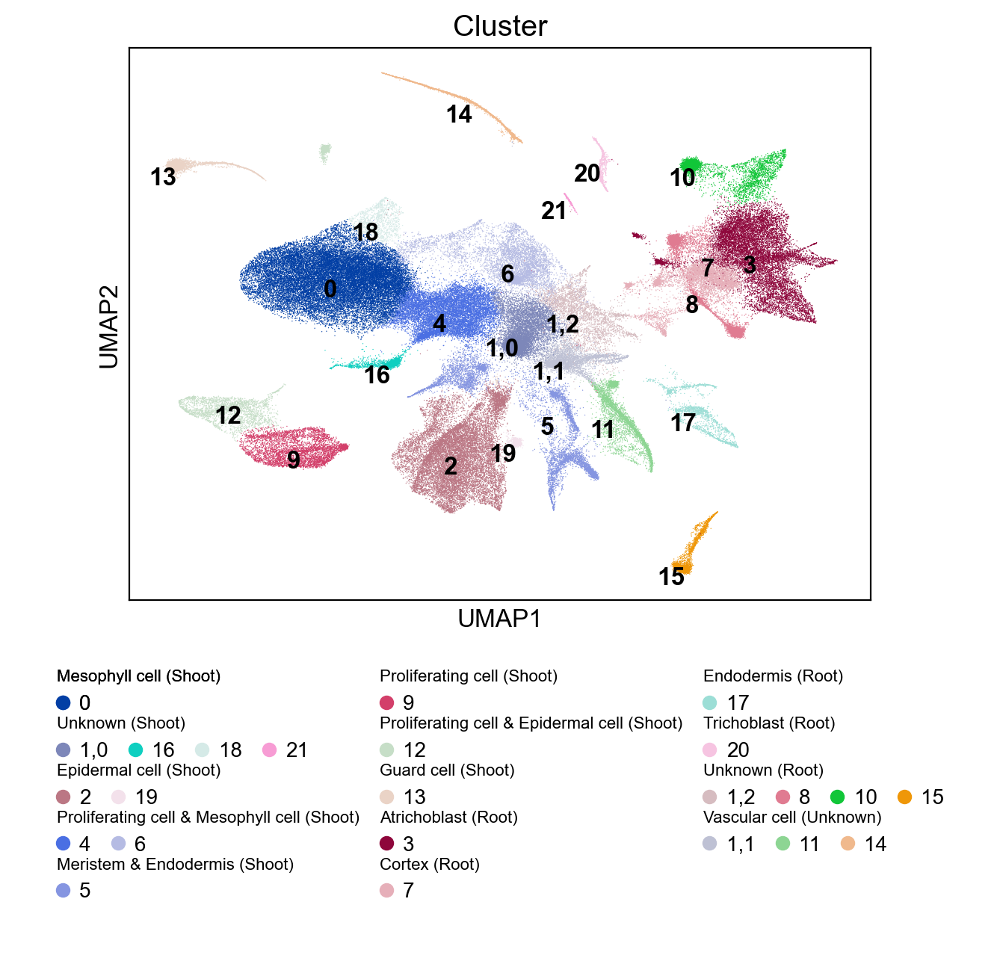

In [27]:
ax = sc.pl.umap(ad, color="leiden_subcluster", title="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color='celltype', title='Cluster', ax=ax, show=False)
# ax.get_legend().remove()

adjustText.adjust_text(ax.texts)
ls_legends = []
for celltype, ls_clusters in dt_annoForPlot.items():
    # ls_legendArgs = [('circle', x, dict(color=dt_colors[x])) for x in ls_clusters]
    # ls_legendArgs = [
    #     ('circle', x, dict(color=dt_colors[x])) for x in ls_clusters
    # ]
    ls_legends.append(
        legendkit.cat_legend(
            colors=[dt_colors[x] for x in ls_clusters],
            labels=ls_clusters,
            size=0.6,
            handle="circle",
            title=celltype,
            ncol=len(ls_clusters),
            title_fontproperties={"size": 8},
        )
    )

    # ls_legends.append(legendkit.cat_legend(legend_items=ls_legendArgs, title=celltype, ncol=len(ls_clusters)))
ls_meteLegends = []
j = 0
for i in [5, 5, 5]:
    ls_meteLegends.append(
        legendkit.vstack(ls_legends[j : i + j], spacing=1, padding=-1)
    )
    j += i

legendkit.hstack(
    ls_meteLegends, loc="out lower center", spacing=10, frameon=False, ax=ax
)

# plot some gene in different cluster

In [228]:
ad_merge = singleCellTools.geneEnrichInfo._mergeData(ad, ["CT", "recluster_ct"], layer="sx")

In [229]:
ad_merge.obs["Batch"] = np.where(ad_merge.obs["CT"].astype(int) % 4, "2", "1")

In [230]:
ad_merge.obs["Cluster"] = ad_merge.obs["recluster_ct"].str.split(":").str[0]

In [231]:
singleCellTools.basic.initLayer(ad_merge, total=1e6, logbase=2)

In [232]:
ad_merge.layers["normalize"] = np.exp2(ad_merge.to_df("normalize_log")) - 1

In [ ]:
ls_fig = []
for name, gene in {'CCA1': 'AT2G46830',
 'PRR9': 'AT2G46790',
 'PRR5': 'AT5G24470',
 'TOC1': 'AT5G61380',
 'ELF3': 'AT2G25930'}.items():
    h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
    # h.add_dendrogram('left', method='ward', add_divider=False)

    _df = (
        ad_mergeAllCt[:, [gene]]
        .to_df("normalize_log")
        .join(ad_mergeAllCt.obs[["CT"]])
    )

    _df = _df.melt("CT", var_name="gene", value_name="CPM")
    _df["name"] = name


    h.add_top(
        utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
    )

    h.add_legends(side="bottom")
    # fig = plt.figure(figsize=(3.3, 6))
    h.add_top(mp.Title(name, fontsize=16))
    h.render()
    plt.close()
    h._legend_box.loc = 8
    ls_fig.append(h.figure)

In [535]:
from jpy_tools.otherTools import FigConcate

In [536]:
ls_fig = [FigConcate(x) for x in ls_fig]

In [537]:
a = reduce(lambda x, y: x | y, ls_fig)

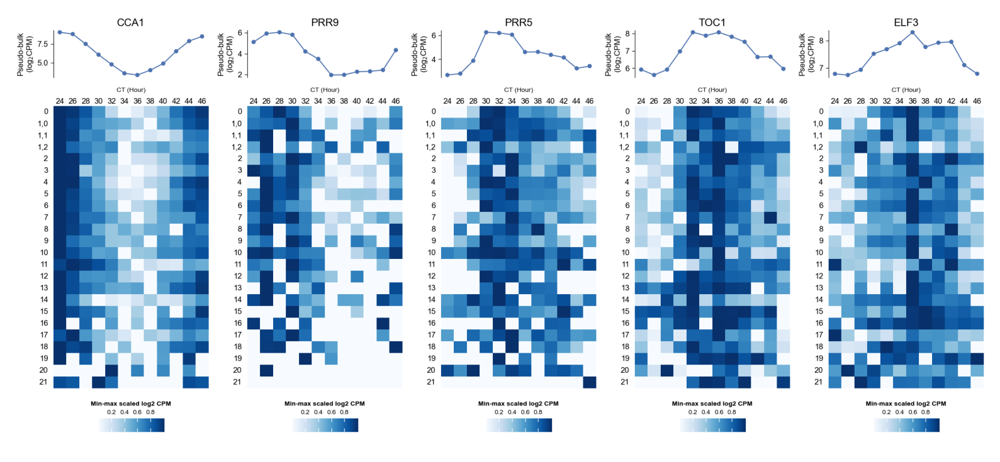

In [538]:
display(a.show())

2023-09-13 18:59:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 18:59:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 18:59:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 18:59:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


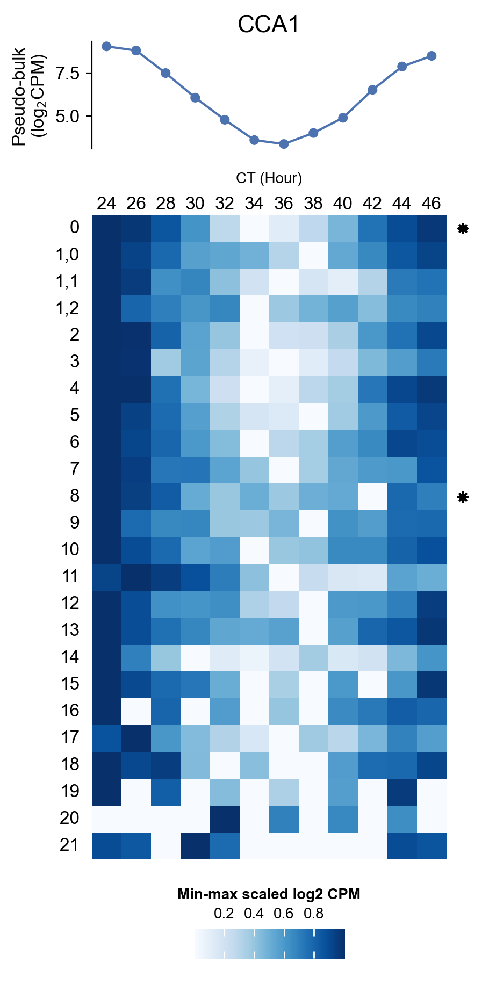

In [250]:
_ad = sc.read_h5ad("/data/Zhaijx/liuzj/projects/singleCell/clock/02_web/20230706/count.h5ad")
_ad.obs['Cluster'] = ad.obs['leiden_subcluster']
_ad.obs['celltype'] = ad.obs['recluster_ct']
_ad.write_h5ad("/data/Zhaijx/liuzj/projects/singleCell/clock/02_web/20230706/count.h5ad")

<Axes: title={'center': 'Cluster'}, xlabel='UMAP1', ylabel='UMAP2'>

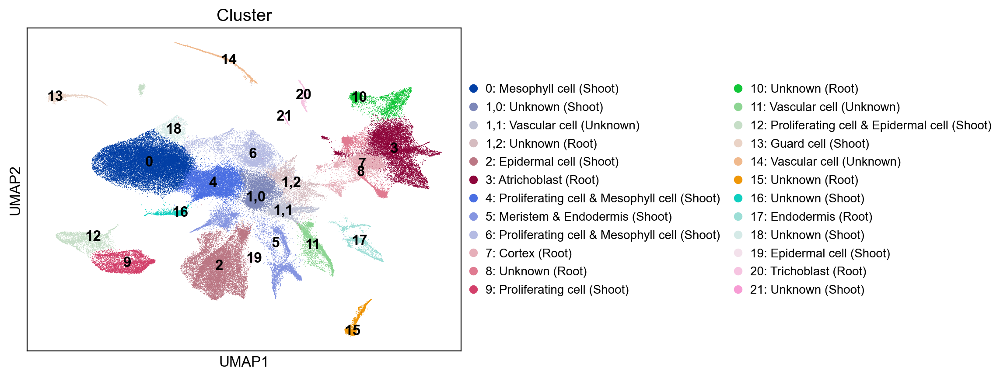

In [239]:
ax = sc.pl.umap(ad, color='leiden_subcluster', show=False, legend_loc='on data')
sc.pl.umap(ad, color='recluster_ct', title='Cluster', show=False, ax=ax)

<Axes: title={'center': 'Cluster'}, xlabel='UMAP1', ylabel='UMAP2'>

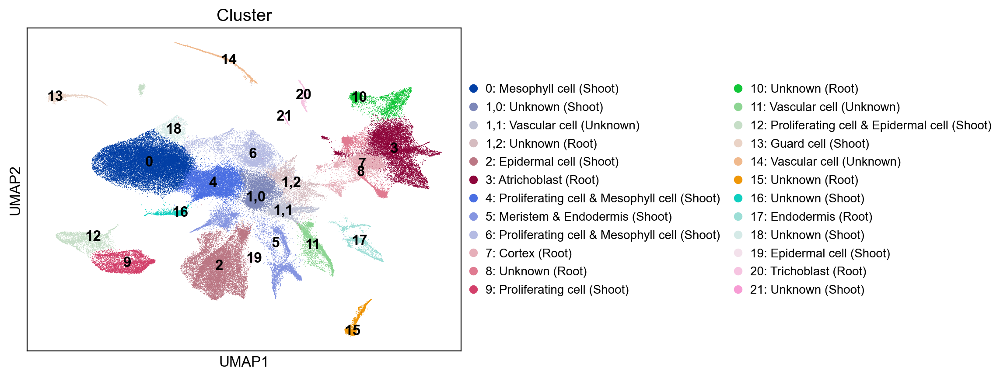

In [17]:
ax = sc.pl.umap(ad, color='leiden_subcluster', show=False, legend_loc='on data')
sc.pl.umap(ad, color='recluster_ct', title='Cluster', show=False, ax=ax)

In [58]:
# import importlib
# importlib.reload(singleCellTools.plotting)

In [240]:
# ad.write_h5ad(f"{dir_result}/0908_c1_split_anno.h5ad")

In [14]:
ad = sc.read_h5ad(f"{dir_result}/0908_c1_split_anno.h5ad")

In [10]:
pad = singleCellTools.plotting.PlotAnndata(ad, 'raw')

In [11]:
pad.getPb('CT')

AnnData object with n_obs × n_vars = 12 × 24503
    obs: 'CT'
    uns: 'log1p'
    layers: 'raw', 'normalize_log', 'normalize'

In [18]:
pad.getPb(['leiden_subcluster', 'CT'])

AnnData object with n_obs × n_vars = 288 × 24503
    obs: 'CT', 'leiden_subcluster'
    uns: 'log1p'
    layers: 'raw', 'normalize_log', 'normalize'

In [66]:
# pad.getPb('CT').write_h5ad("/data/Zhaijx/qinyw/data/flsnRNA/illumina_lib/circadian/20231110/ct_merged.h5ad")

In [72]:
ad.obs.groupby("CT")['n_counts'].agg(['mean', 'median'])

,mean,median
CT,,
24,1286.979126,1139.0
26,1149.671631,1030.0
28,1101.712158,964.0
30,1192.465454,1088.0
32,842.283813,741.0
34,1221.556763,1052.0
36,914.204773,808.0
38,1041.128540,885.0
40,987.612244,876.0


# call jtk

In [101]:
ls_pubCircadianGenes = []
dt_pubCircadianGenes = {}

## Michael

In [102]:
df_michael = pd.read_excel(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/13059_2008_1992_MOESM2_ESM.xls",
    skiprows=2,
    header=[0, 1],
)

In [103]:
_ls = []
for x, y in df_michael.columns:
    _ls.append(f"{x}_{y}")
df_michael.columns = _ls

In [104]:
df_michael = pd.concat(
    [df_michael.loc[:, ["Identifiers_AGI"]], df_michael.filter(like="circadian")],
    axis=1,
)

In [105]:
df_michael = df_michael.loc[lambda df: df.iloc[:, 1:].sum(axis=1) > 0]

In [106]:
ls_pubCircadianGenes.extend(df_michael["Identifiers_AGI"].to_list())

In [107]:
dt_pubCircadianGenes["Michael et al."] = (
    df_michael["Identifiers_AGI"].to_list() >> F(set) >> F(list)
)

## Andres

In [108]:
df_andres = pd.read_excel(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/tpj14776-sup-0013-tables5.xlsx"
)

In [109]:
ls_andres = df_andres["Combined circadian datasets (ALL)"].to_list()

In [110]:
ls_pubCircadianGenes.extend(ls_andres)

In [111]:
dt_pubCircadianGenes["Andres et al."] = ls_andres >> F(set) >> F(list)

## Polly

In [112]:
df_pollyCosopt = pd.read_csv(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/pone.0049853.s006.csv",
    skiprows=2,
)

In [113]:
df_pollyCosopt = df_pollyCosopt.query("`pMMC.Beta` < 0.05 & expressed == 'expressed'")

In [114]:
df_pollyJtk = pd.read_csv(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/pone.0049853.s007.csv",
    skiprows=1,
)

In [115]:
df_pollyJtk = df_pollyJtk.query("`ADJ.P` < 0.05 & expressed == 'expressed'")

In [116]:
ls_pubCircadianGenes.extend(
    list(set(df_pollyCosopt["GeneID"]) & set(df_pollyJtk["GeneID"]))
)

In [117]:
ls_pubCircadianGenes = list(set(ls_pubCircadianGenes))

In [118]:
dt_pubCircadianGenes["Polly et al."] = list(
    set(df_pollyCosopt["GeneID"]) & set(df_pollyJtk["GeneID"])
)

## call

In [218]:
def getPhase(x, y):
    def _cos(x, a, b, c):
        return a * np.cos((np.pi / 12) * x - (np.pi / 12) * b) + c

    from scipy.optimize import curve_fit

    popt, pcov = curve_fit(_cos, x, y, bounds=([0, 0, 0], [np.inf, 24, np.inf]))
    std = np.sqrt(np.diag(pcov))
    return (*popt, *std)


def getJtkGene(ad_merge, celltype, layer):
    MetaCycle = importr("MetaCycle")
    ad_test = ad_merge[ad_merge.obs.eval(f"leiden_subcluster == @celltype")]
    sc.pp.filter_genes(ad_test, min_cells=10)
    sr_idxMax = (
        ad_test.to_df(layer).idxmax(axis=0).str.split(f"\|\|").str[-1].rename("idxMax")
    )
    _df = ad_test.to_df(layer).join(ad_test.obs["CT"]).pivot_table(columns=["CT"])
    _df = _df[sorted(_df.columns, key=int)]
    _df.columns = _df.columns.astype(int)
    _df = _df.rename_axis(index="geneName").reset_index()
    outD = MetaCycle.meta2d(
        infile="csv",
        filestyle="csv",
        cycMethod=R.c("JTK"),
        timepoints=R.seq(0, 22, 2),
        outputFile=False,
        inDF=_df >> F(py2r),
        minper=24,
        maxper=24,
    )
    df_jtk = (
        r2py(outD[1])
        .assign(celltype=celltype)
        .merge(sr_idxMax, left_on="CycID", right_index=True)
    )

    _df_mtx = ad_test[ad_test.obs.eval(f"leiden_subcluster == @celltype")].to_df(layer)
    _ls = []
    for gene in df_jtk["CycID"]:
        res = getPhase(np.linspace(0, 22, 12), _df_mtx[gene].values)
        _ls.append(res)
    
    df_jtk["phase"] = [x[1] for x in _ls]
    df_jtk["phase"] = (np.round(df_jtk["phase"] / 2) * 2).astype(int)
    df_jtk["phase"] = np.where(df_jtk["phase"] == 24, 0, df_jtk["phase"])

    df_jtk["orgPhase"] = [x[1] for x in _ls]
    df_jtk["stdPhase"] = [x[4] for x in _ls]

    df_jtk["orgAmpli"] = [x[0] for x in _ls]
    df_jtk["stdAmpli"] = [x[3] for x in _ls]

    df_jtk["orgBase"] = [x[2] for x in _ls]
    df_jtk["stdBase"] = [x[5] for x in _ls]
    return df_jtk

In [200]:
ad_mergeSoupx = singleCellTools.geneEnrichInfo._mergeData(
    ad, ["leiden_subcluster", "CT"], layer="sx"
)

In [201]:
singleCellTools.basic.initLayer(ad_mergeSoupx, total=1e6, logbase=2)

In [202]:
ad_mergeSoupx.layers["normalize"] = np.exp2(ad_mergeSoupx.layers["normalize_log"]) - 1

In [203]:
from joblib import Parallel, delayed

In [219]:
lsDf = Parallel(n_jobs=30, backend="multiprocessing")(
    delayed(getJtkGene)(ad_mergeSoupx, celltype, "normalize_log")
    for celltype in ad_mergeSoupx.obs["leiden_subcluster"].unique()
)

The JTK is in process from  10:32:44 AM 10-16-2023 
The JTK is in process from  10:32:44 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The analysis by JTK is finished at  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:45 AM 10-16-2023 
The JTK is in process from  10:32:46 AM 10-16-2023 
The JTK is in process from  10:32:46 AM 10-16-2023 
The JTK is in process from  10:32:46 AM 10-16-2023 
The JTK is in process from  10:32:46 AM 10-16-2023 
The 

In [189]:
df_jtkCpmOrg = pd.concat(lsDf)

In [190]:
ad.uns["soupx_jtkCycleCpmLog_leidenSub"] = df_jtkCpmOrg

In [188]:
# ad.uns["soupx_jtkCycleCpmLog_leidenSub_bc"] = ad.uns["soupx_jtkCycleCpmLog_leidenSub"]

In [191]:
df_jtkCpmOrg = ad.uns["soupx_jtkCycleCpmLog_leidenSub"].query("`ADJ.P` < 0.05")

<Axes: >

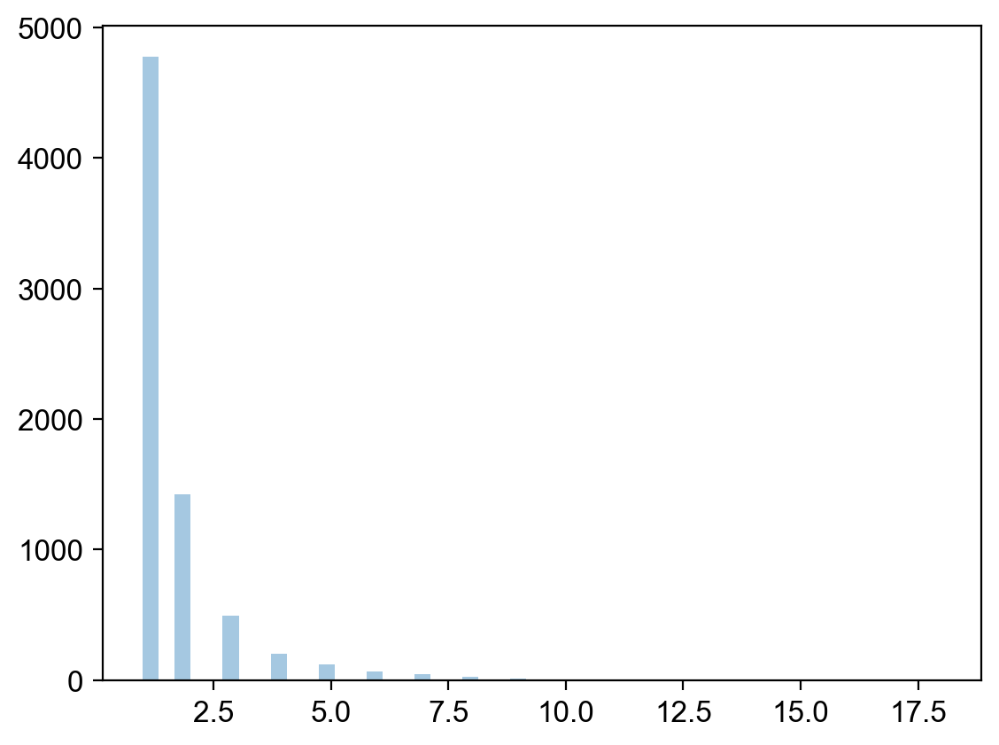

In [120]:
sns.distplot(
    pd.notna(
        df_jtkCpmOrg.pivot_table(columns="celltype", index="CycID", values=["LAG"])
    ).sum(1),
    kde=False,
)

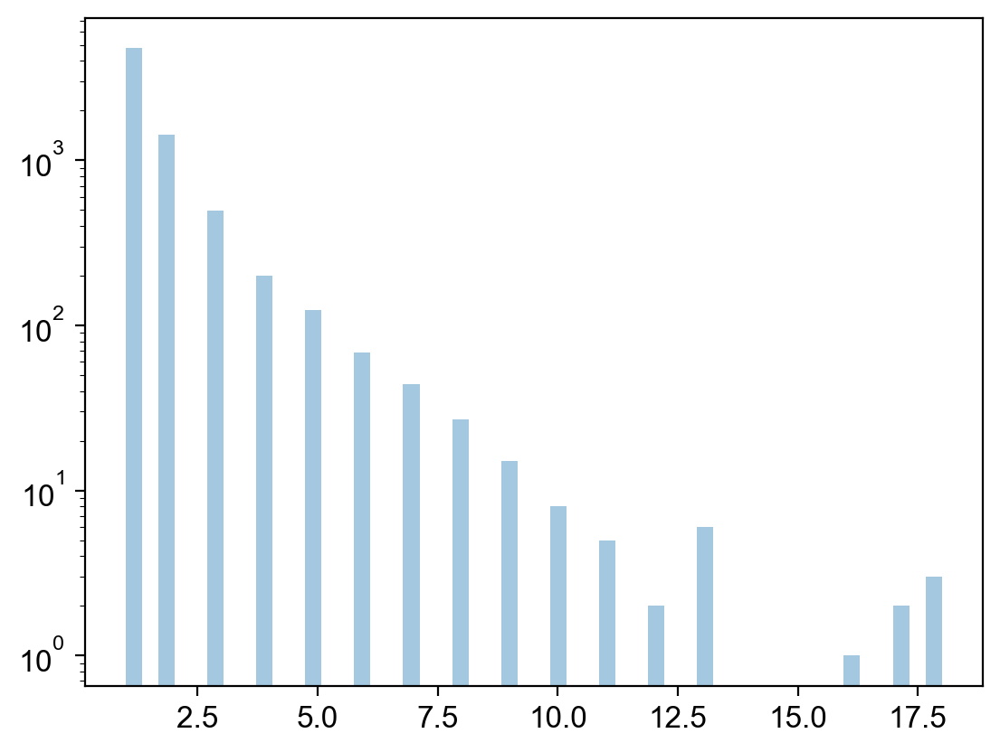

In [121]:
sns.distplot(
    pd.notna(
        df_jtkCpmOrg.pivot_table(columns="celltype", index="CycID", values=["LAG"])
    ).sum(1),
    kde=False,
)
plt.yscale("log")

### call with combat

In [638]:
ad_mergeSoupx.X = ad_mergeSoupx.layers["normalize_log"].copy()

In [639]:
ad_mergeSoupx.obs = ad_mergeSoupx.obs.assign(batch = lambda _: np.where(_["CT"].astype(int) % 4 == 0, '1', '2'))

In [640]:
_ls = []
for cluster, _ad in singleCellTools.basic.splitAdata(ad_mergeSoupx, 'leiden_subcluster', needName=True):
    sc.pp.combat(_ad, key="batch")
    _ls.append(_ad)

  4%|▍         | 1/24 [00:00<00:09,  2.55it/s]

Found 603 genes with zero variance.


... storing 'batch' as categorical
  8%|▊         | 2/24 [00:00<00:07,  2.98it/s]

Found 1239 genes with zero variance.


... storing 'batch' as categorical
 12%|█▎        | 3/24 [00:00<00:06,  3.38it/s]

Found 2127 genes with zero variance.


... storing 'batch' as categorical
 17%|█▋        | 4/24 [00:01<00:05,  3.87it/s]

Found 2022 genes with zero variance.


... storing 'batch' as categorical
 21%|██        | 5/24 [00:01<00:05,  3.24it/s]

Found 613 genes with zero variance.


... storing 'batch' as categorical
 25%|██▌       | 6/24 [00:01<00:05,  3.48it/s]

Found 812 genes with zero variance.


... storing 'batch' as categorical
 29%|██▉       | 7/24 [00:02<00:04,  3.65it/s]

Found 1034 genes with zero variance.


... storing 'batch' as categorical
 33%|███▎      | 8/24 [00:02<00:04,  3.57it/s]

Found 1218 genes with zero variance.


... storing 'batch' as categorical
 38%|███▊      | 9/24 [00:02<00:04,  3.48it/s]

Found 1446 genes with zero variance.


... storing 'batch' as categorical
 42%|████▏     | 10/24 [00:02<00:04,  3.23it/s]

Found 1430 genes with zero variance.


... storing 'batch' as categorical
 46%|████▌     | 11/24 [00:03<00:03,  3.30it/s]

Found 2093 genes with zero variance.


... storing 'batch' as categorical
 50%|█████     | 12/24 [00:03<00:03,  3.20it/s]

Found 1735 genes with zero variance.


... storing 'batch' as categorical
 54%|█████▍    | 13/24 [00:03<00:03,  3.07it/s]

Found 2129 genes with zero variance.


... storing 'batch' as categorical
 58%|█████▊    | 14/24 [00:04<00:03,  2.85it/s]

Found 1991 genes with zero variance.


... storing 'batch' as categorical
 62%|██████▎   | 15/24 [00:04<00:02,  3.12it/s]

Found 2241 genes with zero variance.


... storing 'batch' as categorical
 67%|██████▋   | 16/24 [00:04<00:02,  3.11it/s]

Found 2596 genes with zero variance.


... storing 'batch' as categorical
 71%|███████   | 17/24 [00:05<00:02,  2.95it/s]

Found 2397 genes with zero variance.


... storing 'batch' as categorical
 75%|███████▌  | 18/24 [00:05<00:02,  2.94it/s]

Found 2919 genes with zero variance.


... storing 'batch' as categorical
 79%|███████▉  | 19/24 [00:05<00:01,  3.02it/s]

Found 3566 genes with zero variance.


... storing 'batch' as categorical
 83%|████████▎ | 20/24 [00:06<00:01,  3.05it/s]

Found 2876 genes with zero variance.


... storing 'batch' as categorical
 88%|████████▊ | 21/24 [00:06<00:00,  3.13it/s]

Found 3871 genes with zero variance.


... storing 'batch' as categorical
 92%|█████████▏| 22/24 [00:06<00:00,  3.19it/s]

Found 5121 genes with zero variance.


... storing 'batch' as categorical
 96%|█████████▌| 23/24 [00:07<00:00,  3.16it/s]

Found 4658 genes with zero variance.


... storing 'batch' as categorical
100%|██████████| 24/24 [00:07<00:00,  3.16it/s]

Found 9144 genes with zero variance.


In [643]:
ad_mergeSoupx = sc.concat(_ls)

In [644]:
ad_mergeSoupx.layers['normalize_log_combat'] = ad_mergeSoupx.X.copy()

# filter by bulk data

In [122]:
import matplotlib_venn

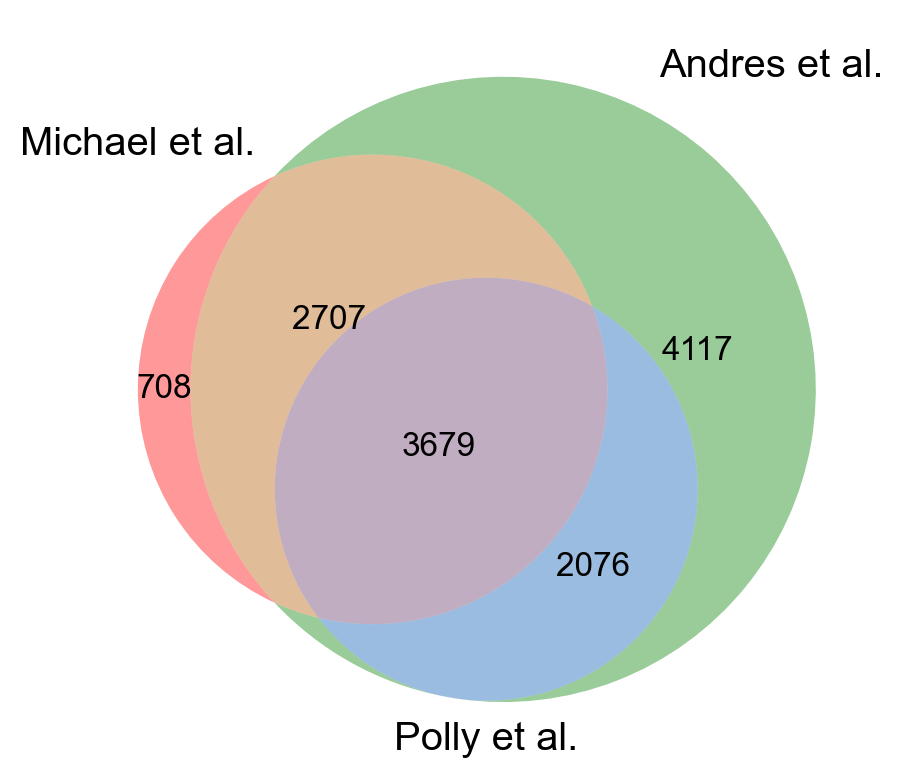

In [123]:
matplotlib_venn.venn3(
    dt_pubCircadianGenes.values() >> F(map, set) >> F(list), dt_pubCircadianGenes.keys()
)

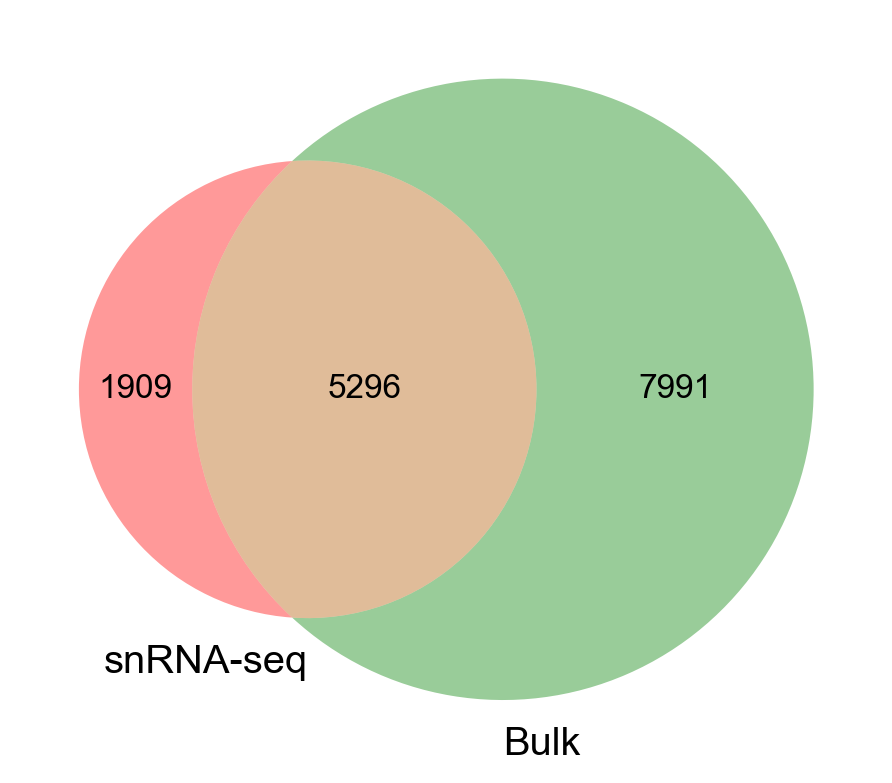

In [124]:
matplotlib_venn.venn2(
    [set(df_jtkCpmOrg["CycID"]), set(ls_pubCircadianGenes)],
    set_labels=["snRNA-seq", "Bulk"],
)

In [170]:
df_jtkCpm = df_jtkCpmOrg.query("CycID in @ls_pubCircadianGenes")

In [171]:
df_jtkCpm = df_jtkCpm.assign(cluster=lambda _: _.celltype)

In [93]:
# df_jtkCpm.to_csv("/data/Zhaijx/liuzj/projects/circadian/03_analysis/20230906_jtk_intersect_with_bulk.csv")

In [56]:
df_jtkCpm.pivot_table('phase', 'CycID', 'cluster').fillna('').assign(counts = lambda _: _.apply(lambda _: len([x for x in _ if x != '']), axis=1)).sort_values('counts', ascending=False)

cluster,0,"1,0","1,1","1,2",10,11,12,13,14,15,...,20,21,3,4,5,6,7,8,9,counts
CycID,,,,,,,,,,,,,,,,,,,,,
AT2G21660,,10.0,12.0,10.0,,14.0,10.0,10.0,,12.0,...,,12.0,,10.0,12.0,10.0,12.0,,10.0,18
AT3G54500,0.0,2.0,2.0,0.0,2.0,,0.0,0.0,22.0,2.0,...,,,,0.0,2.0,0.0,2.0,2.0,0.0,18
AT2G46830,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,,...,,,0.0,0.0,0.0,0.0,0.0,2.0,0.0,18
AT3G09600,22.0,22.0,22.0,22.0,22.0,,22.0,20.0,,0.0,...,,,0.0,22.0,22.0,22.0,0.0,22.0,,17
AT5G02810,4.0,6.0,6.0,,6.0,10.0,4.0,4.0,2.0,8.0,...,,,,4.0,6.0,4.0,8.0,6.0,4.0,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT2G47990,6.0,,,,,,,,,,...,,,,,,,,,,1
AT2G48120,6.0,,,,,,,,,,...,,,,,,,,,,1
AT3G01120,,,,,,6.0,,,,,...,,,,,,,,,,1


In [ ]:
# df_jtkCpm.pivot_table('phase', 'CycID', 'cluster').fillna('').assign(counts = lambda _: _.apply(lambda _: len([x for x in _ if x != '']), axis=1)).sort_values('counts', ascending=False).to_csv("/data/Zhaijx/liuzj/projects/circadian/03_analysis/20230906_jtk_intersect_with_bulk_transfmormed.csv")

cluster,0,"1,0","1,1","1,2",10,11,12,13,14,15,...,20,21,3,4,5,6,7,8,9,counts
CycID,,,,,,,,,,,,,,,,,,,,,
AT2G21660,,10.0,12.0,10.0,,14.0,10.0,10.0,,12.0,...,,12.0,,10.0,12.0,10.0,12.0,,10.0,18
AT3G54500,0.0,2.0,2.0,0.0,2.0,,0.0,0.0,22.0,2.0,...,,,,0.0,2.0,0.0,2.0,2.0,0.0,18
AT2G46830,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,,...,,,0.0,0.0,0.0,0.0,0.0,2.0,0.0,18
AT3G09600,22.0,22.0,22.0,22.0,22.0,,22.0,20.0,,0.0,...,,,0.0,22.0,22.0,22.0,0.0,22.0,,17
AT5G02810,4.0,6.0,6.0,,6.0,10.0,4.0,4.0,2.0,8.0,...,,,,4.0,6.0,4.0,8.0,6.0,4.0,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT2G47990,6.0,,,,,,,,,,...,,,,,,,,,,1
AT2G48120,6.0,,,,,,,,,,...,,,,,,,,,,1
AT3G01120,,,,,,6.0,,,,,...,,,,,,,,,,1


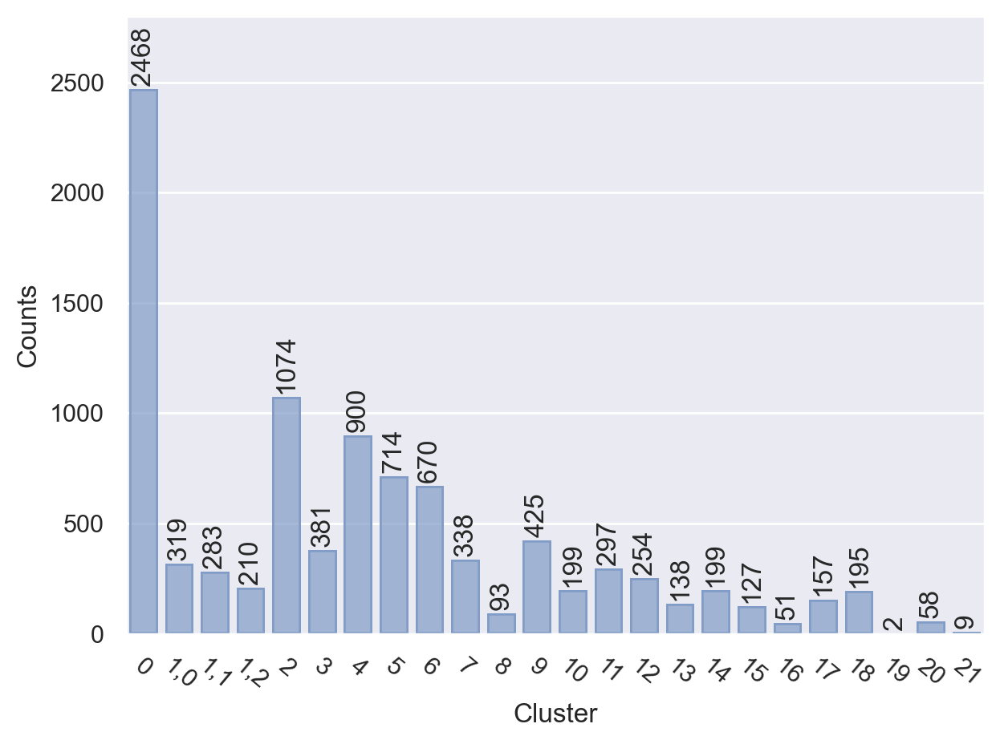

In [57]:
p = df_jtkCpm.value_counts("cluster").sort_index().loc[
    lambda _: sorted(
        _.index, 
        key=lambda _: int(_.split(',')[0])
    )
] >> F(
    lambda _: so.Plot(x=_.index, y=_)
    .add(so.Bar(color='#819cc7'), )
    .add(so.Text(valign='baseline'), text=_)
    .label(x='Cluster', y='Counts')
    .limit(y=(0, 2800))
)
fig = p.plot()._figure
ax = fig.axes[0]
# rotate xlabel
ax.get_xticklabels() >> F(map, lambda _: _.set(rotation=-40)) >> F(list)
ax.texts >> F(map, lambda _: _.set(rotation=90)) >> F(list)
fig

<Axes: >

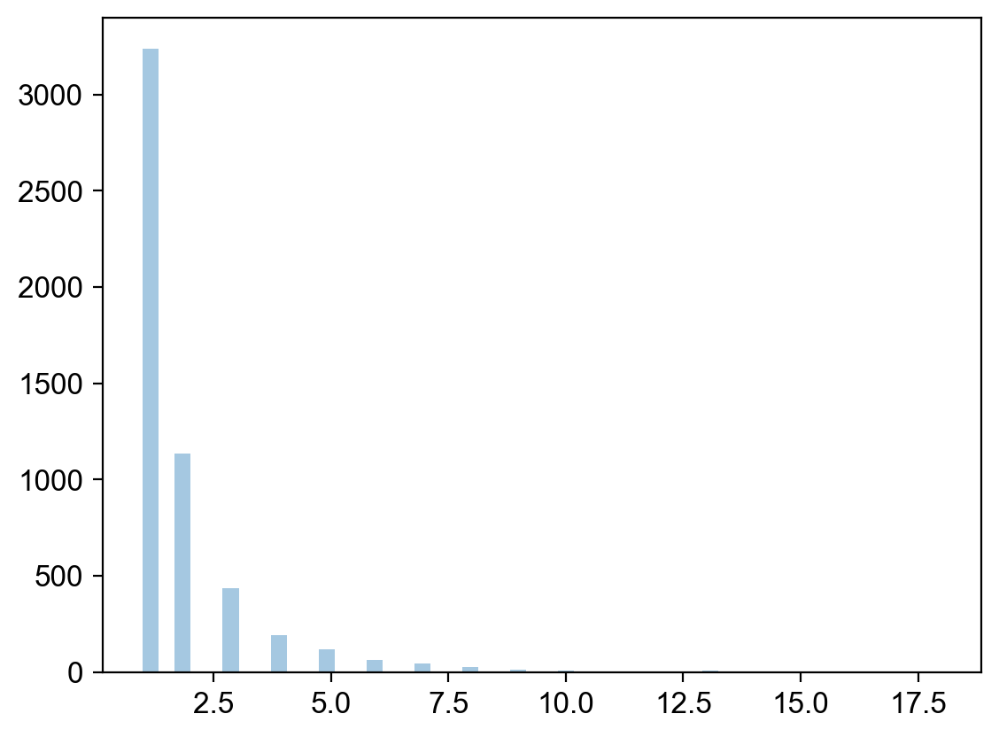

In [58]:
sns.distplot(
    pd.notna(
        df_jtkCpm.pivot_table(columns="celltype", index="CycID", values=["LAG"])
    ).sum(1),
    kde=False,
)

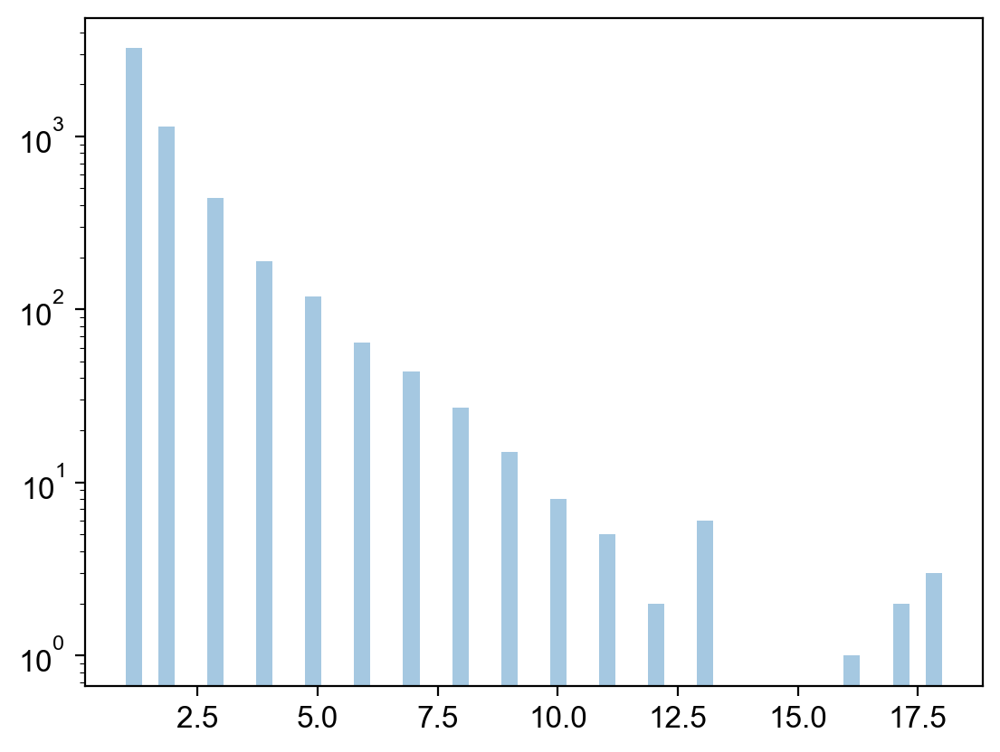

In [244]:
sns.distplot(
    pd.notna(
        df_jtkCpm.pivot_table(columns="celltype", index="CycID", values=["LAG"])
    ).sum(1),
    kde=False,
)
plt.yscale("log")

In [59]:
ls_coreGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT1G12910",
    "AT3G26640",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT5G08330",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
]
ls_coreGeneNames = [
    "CCA1",
    "LHY",
    "LWD1",
    "LWD2",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "CHE",
    "GI",
    "NOX",
    "LUX",
    "ELF4",
    "ELF3",
]
dt_coreGene = dict(zip(ls_coreGenes, ls_coreGeneNames))
dt_coreGene

{'AT2G46830': 'CCA1',
 'AT1G01060': 'LHY',
 'AT1G12910': 'LWD1',
 'AT3G26640': 'LWD2',
 'AT2G46790': 'PRR9',
 'AT5G02810': 'PRR7',
 'AT3G09600': 'RVE8',
 'AT5G52660': 'RVE6',
 'AT5G02840': 'RVE4',
 'AT5G64170': 'LNK1',
 'AT3G54500': 'LNK2',
 'AT5G24470': 'PRR5',
 'AT5G60100': 'PRR3',
 'AT5G61380': 'TOC1',
 'AT5G08330': 'CHE',
 'AT1G22770': 'GI',
 'AT5G59570': 'NOX',
 'AT3G46640': 'LUX',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3'}

In [60]:
df_cpmJtkCounts = (
    pd.notna(df_jtkCpm.pivot_table(columns="celltype", index="CycID", values=["LAG"]))
    .sum(1)
    .to_frame("Count")
    .reset_index()
    .assign(
        pseudoCpm=lambda x: ad[:, x.CycID].layers["raw"].sum(0).A1
        * 1e6
        / ad.layers["raw"].sum(),
        coreDriver=lambda x: x["CycID"].isin(ls_coreGenes),
    )
)
df_cpmJtkCounts

,CycID,Count,pseudoCpm,coreDriver
0,AT1G01020,1,79.987473,False
1,AT1G01040,1,244.667572,False
2,AT1G01060,16,182.052399,True
3,AT1G01070,1,5.267169,False
4,AT1G01090,1,36.726074,False
...,...,...,...,...
5291,AT5G67370,7,111.871506,False
5292,AT5G67390,4,33.231441,False
5293,AT5G67440,1,31.833588,False
5294,AT5G67480,6,93.454430,False


In [61]:
import adjustText

In [62]:
class SoBarForMa(mp.base.StatsBase):
    # class SoBarForMa(mp.base.RenderPlan):

    def __init__(self, data, label, yup=22.5, xup=5000):
        self.set_data(data)
        self.label = label
        self.yup = yup
        self.xup = xup

    def render_ax(self, spec):
        ax = spec.ax
        data = spec.data
        g = (
            so.Plot(_df, y="times", x="counts", text="counts")
            .add(so.Bar(color="#1F77B4"), orient="y")
            .add(so.Text(halign="right"))
            .limit(x=(self.xup, 0), y=(0, self.yup))
            .label(y="", x="Gene counts")
            .theme(dt_snsStyle)
            .on(ax)
            .plot()
        )
        ax.get_yaxis().set_visible(False)
        g._repr_png_()
        ax.set_xbound(self.xup + 2000, 0)
        plt.close()

In [63]:
import legendkit

In [65]:
df_gff3 = (
    pr.read_gff3("/data/Zhaijx/liuzj/data/Araport11/gene.gff", as_df=True)
    .query("Feature == 'gene'")
    .set_index("ID")
)

In [66]:
dt_locus2Name = df_gff3["Alias"].dropna().to_dict()
dt_locus2Name.update(df_gff3["symbol"].dropna().to_dict())

In [67]:
df_cpmJtkCountsForWrite = (
    df_cpmJtkCounts.sort_values("Count", ascending=False)
    .assign(
        name=lambda x: x["CycID"].map(dt_locus2Name),
        coreDriver=lambda x: np.where(x["CycID"].isin(ls_coreGenes), "True", ""),
    )
    .fillna("")
    .reset_index(drop=True)
)

In [251]:
_df = (
    pd.notna(df_jtkCpm.pivot_table(columns="celltype", index="CycID", values=["LAG"]))
    .sum(1)
    .value_counts()
    .rename("counts")
    .to_frame()
    .reindex(range(1, 25) >> F(list))
    .reset_index()
    .rename(columns={"index": "times"})
    .fillna(0)
    .astype(int)
)
_df

,times,counts
0,1,3238
1,2,1133
2,3,438
3,4,191
4,5,119
5,6,64
6,7,44
7,8,27
8,9,15
9,10,8


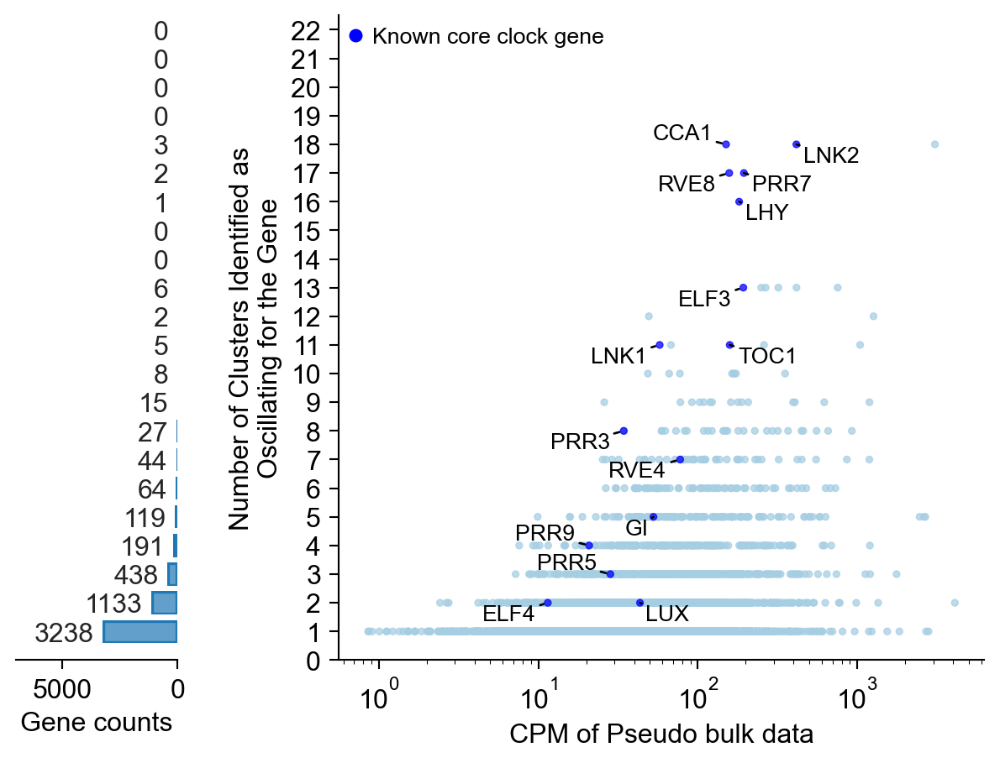

In [68]:
m = ma.base.WhiteBoard()
_df = (
    pd.notna(df_jtkCpm.pivot_table(columns="celltype", index="CycID", values=["LAG"]))
    .sum(1)
    .value_counts()
    .rename("counts")
    .to_frame()
    .reindex(range(1, 23) >> F(list))
    .reset_index()
    .rename(columns={"index": "times"})
    .fillna(0)
    .astype(int)
)
m.add_left(SoBarForMa(_df, "Gene counts"), pad=1, name="bar")
m.render()
ax = m.get_main_ax()
g = (
    so.Plot(
        df_cpmJtkCounts.sort_values("coreDriver"),
        x="pseudoCpm",
        y="Count",
        color="coreDriver",
    )
    .add(so.Dot(alpha=0.75, pointsize=3), legend=False)
    .scale(x="log", color=["#0000FF", "#A6CEE3"], y=so.Continuous().tick(every=1))
    .theme(dt_snsStyle)
    .label(
        color="Core clock gene",
        x="CPM of Pseudo bulk data",
        y="Number of Clusters Identified as\nOscillating for the Gene",
    )
    .on(ax)
    .plot()
)
g._repr_png_()
fig = g._figure
legendkit.cat_legend(
    ax,
    ["#0000FF"],
    ["Known core clock gene"],
    handle="circle",
    loc="upper left",
    size=0.5,
    frameon=False,
)
# ax = fig.axes[0]
for tp_line in df_cpmJtkCounts.query("coreDriver == @True").itertuples():
    ax.text(
        tp_line.pseudoCpm,
        tp_line.Count,
        dt_coreGene[tp_line.CycID],
        ha="center",
        va="center",
        fontsize=10,
    )
adjustText.adjust_text(
    ax.texts,
    arrowprops=dict(arrowstyle="-", color="black"),
    ax=ax,
    min_arrow_len=0,
    expand=(1.5, 1.5),
)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
plt.close()
m.get_main_ax().set_ylim(0, 22.5)
g

In [78]:
df_cpmJtkCountsOver10 = df_cpmJtkCounts.query("Count > 10")

In [79]:
dt_extendedClockGenes = {
    'AT2G21660': 'GRP7',
    'AT3G20810': 'JMJD5',
    'AT5G37260': 'RVE2',
    'AT3G17609': 'HYH'
}

In [80]:
df_cpmJtkCountsOver10 = df_cpmJtkCountsOver10.assign(
    GeneCate = lambda _: np.select([
        _.CycID.isin(dt_coreGene.keys()),
        _.CycID.isin(dt_extendedClockGenes.keys()),
    ],[
    "Known core clock gene",
    "Other circadian regulator"
], "Other gene",
))

In [81]:
df_cpmJtkCountsOver10['GeneCate'].astype('category').cat.reorder_categories(['Known core clock gene', 'Other circadian regulator', 'Other gene'], inplace=True)

In [82]:
dt_extendedClockGenes.update(dt_coreGene)

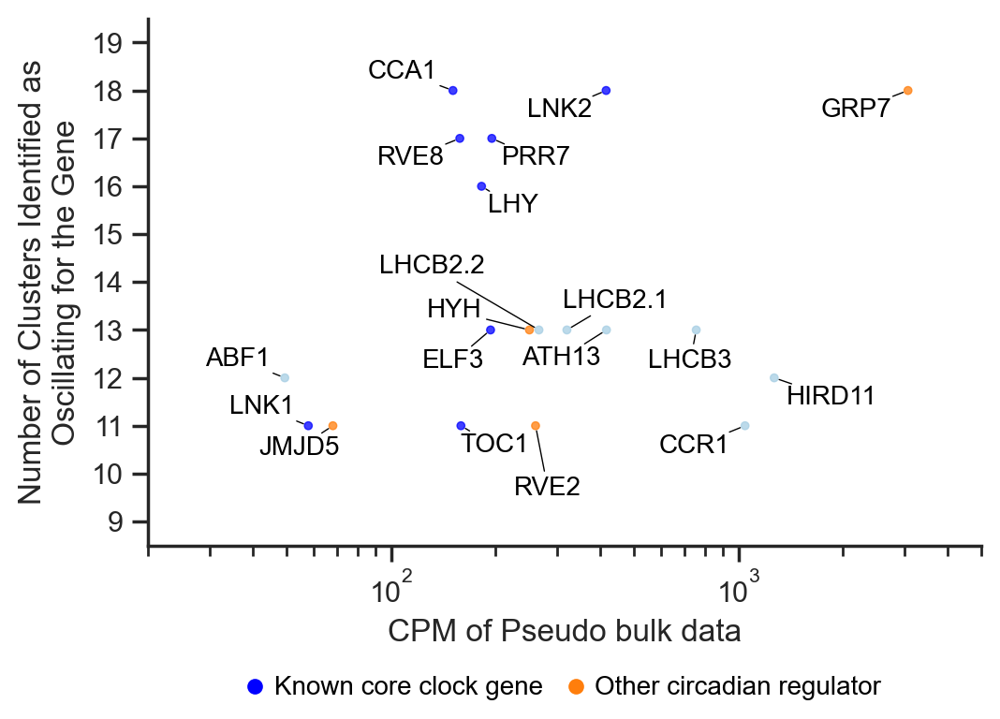

In [132]:
g = (
    so.Plot(
        df_cpmJtkCountsOver10.sort_values("coreDriver"),
        x="pseudoCpm",
        y="Count",
        color="GeneCate",
    )
    .add(so.Dot(alpha=0.75, pointsize=3), legend=False)
    .scale(x="log", color=["#FF7E0C","#A6CEE3",  "#0000FF" ], y=so.Continuous().tick(every=1))
    .layout(size=(5.5,4))
    .theme(dt_snsStyle)
    .label(
        color="Core clock gene",
        x="CPM of Pseudo bulk data",
        y="Number of Clusters Identified as\nOscillating for the Gene",
    )
    .limit(y=(8.5, 19.5), x=(20, 5000),)
)
gp = g.plot()
gp._repr_png_()
fig = gp._figure
ax = fig.axes[0]
legendkit.cat_legend(
    ax,
    ["#0000FF",  "#FF7E0C"],
    ["Known core clock gene", "Other circadian regulator"],
    handle="circle",
    loc="out lower center",
    size=0.5,
    frameon=False,
    ncol=2, borderaxespad=4
)

dt_extendedClockGenes.update({'AT1G49720': 'ABF1',
 'AT1G54410': 'HIRD11',
 'AT2G05070': 'LHCB2.2',
 'AT2G05100': 'LHCB2.1',
 'AT3G51240': 'F3H',
 'AT4G39260': 'CCR1',
 'AT5G54270': 'LHCB3',
 'AT5G64940': 'ATH13'})

for tp_line in df_cpmJtkCountsOver10.itertuples():
    ax.text(
        tp_line.pseudoCpm,
        tp_line.Count,
        dt_extendedClockGenes[tp_line.CycID],
        ha="center",
        va="center",
        fontsize=10,
    )
adjustText.adjust_text(
    ax.texts,
    arrowprops=dict(arrowstyle="-", color='k', lw=0.5),
    ax=ax,
    min_arrow_len=0,
    time_lim=1, expand=(1.5, 1.8)
)

fig

In [253]:
_ls = df_jtkCpm.value_counts("CycID").iloc[:50].index.to_list()

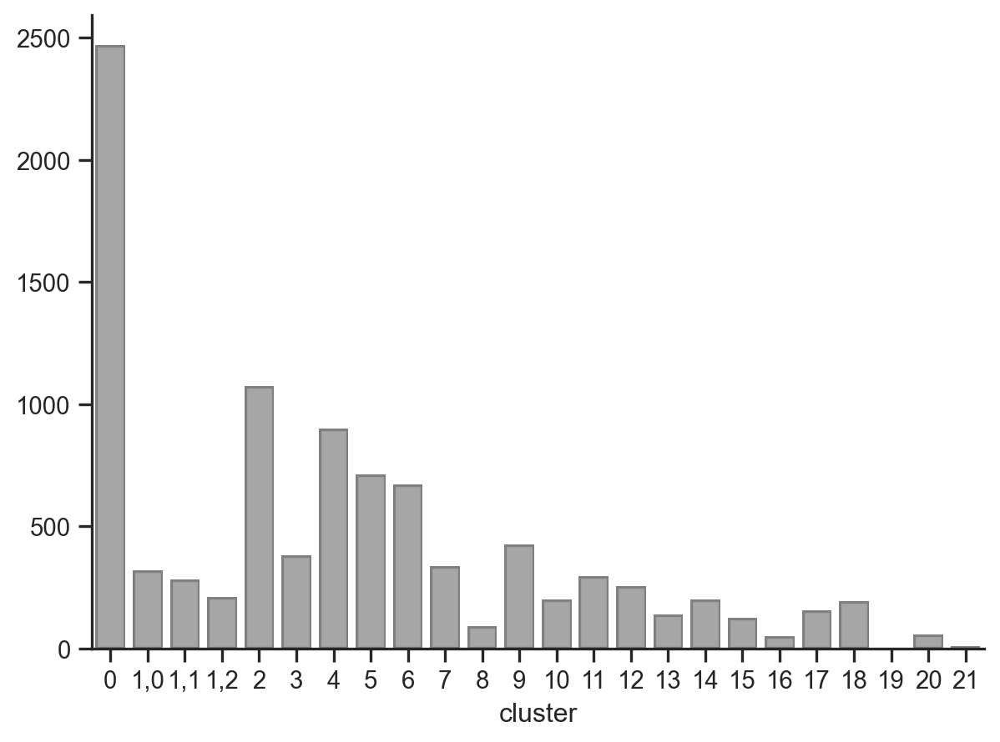

In [254]:
(
    so.Plot(df_jtkCpm, x='cluster')
    .add(so.Bar(), so.Count())
    .theme(dt_snsStyle)
)

<Axes: xlabel='phase', ylabel='celltype'>

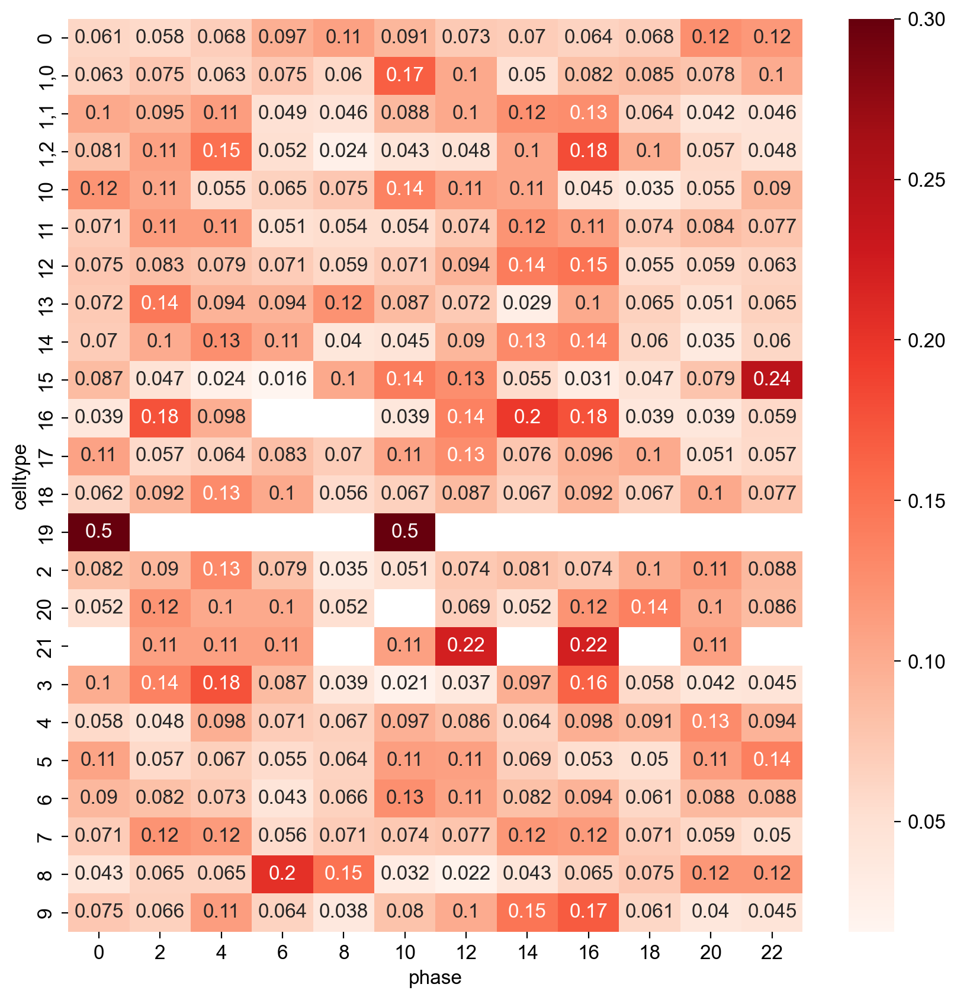

In [255]:
fig, ax = plt.subplots(figsize=(10, 10))
(
df_jtkCpm.pivot_table(values='CycID', index='celltype', columns='phase', aggfunc='count').pipe(lambda _: _.T/_.sum(1)).T
  >> F(lambda _: sns.heatmap(_, cmap='Reds', vmax=0.3, annot=True))
)

## jtk GO

In [133]:
import gseapy

In [451]:
df_jtkCpm.value_counts('cluster')

cluster
0      2468
2      1074
4       900
5       714
6       670
9       425
3       381
7       338
1,0     319
11      297
1,1     283
12      254
1,2     210
14      199
10      199
18      195
17      157
13      138
15      127
8        93
20       58
16       51
21        9
19        2
dtype: int64

In [186]:
lsDf = []
from itertools import product
for phase, celltype in product(sorted(df_jtkCpm['phase'].unique()), sorted(df_jtkCpm['celltype'].unique(), key=lambda x:int(x.split(':')[0].split(',')[0]))):
    ls_queryGenes = df_jtkCpm.query("phase == @phase & celltype == @celltype")['CycID'].to_list()
    if len(ls_queryGenes) == 0:
        continue

    goRes = gseapy.enrichr(
        ls_queryGenes,
        gene_sets=df_termGene.groupby("GO term accession")['Gene stable ID'].agg(list).to_dict(),
        background=ad.var.index.to_list())
    goRes.results['Gene_set'] = goRes.results['Term'].map(dt_goToCat)
    goRes.results['Term'] = goRes.results['Term'].map(df_termName.set_index('GO term accession')['GO term name'].to_dict())
    goRes.results['phase'] = phase
    goRes.results['celltype'] = celltype
    lsDf.append(goRes.results)
df_jtkCpmGoRes = pd.concat(lsDf)
df_jtkCpmGoRes['-logQ'] = -np.log10(df_jtkCpmGoRes['Adjusted P-value'])

In [187]:
df_jtkCpmGoRes['-log10(p)'] = -np.log10(df_jtkCpmGoRes['P-value'])

In [196]:
df_jtkCpmGoRes['cluster'] = df_jtkCpmGoRes['celltype']

In [201]:
df_jtkCpmGoRes.reset_index(drop=True).to_csv('/data/Zhaijx/liuzj/projects/circadian/03_analysis/20230906_go_soupx_enrichment_jtk_cluster_phase_separate.csv')

In [160]:
df_jtkCpmOnlyUnique = df_jtkCpm.drop_duplicates("CycID", keep=False)

In [161]:
lsDf = []
from itertools import product
for phase, celltype in product(sorted(df_jtkCpmOnlyUnique['phase'].unique()), sorted(df_jtkCpmOnlyUnique['celltype'].unique(), key=lambda x:int(x.split(':')[0].split(',')[0]))):
    ls_queryGenes = df_jtkCpmOnlyUnique.query("phase == @phase & celltype == @celltype")['CycID'].to_list()
    if len(ls_queryGenes) == 0:
        continue

    goRes = gseapy.enrichr(
        ls_queryGenes,
        gene_sets=df_termGene.groupby("GO term accession")['Gene stable ID'].agg(list).to_dict(),
        background=ad.var.index.to_list())
    goRes.results['Gene_set'] = goRes.results['Term'].map(dt_goToCat)
    goRes.results['Term'] = goRes.results['Term'].map(df_termName.set_index('GO term accession')['GO term name'].to_dict())
    goRes.results['phase'] = phase
    goRes.results['celltype'] = celltype
    lsDf.append(goRes.results)
df_jtkCpmOnlyUniqueGoRes = pd.concat(lsDf)
df_jtkCpmOnlyUniqueGoRes['-logQ'] = -np.log10(df_jtkCpmOnlyUniqueGoRes['Adjusted P-value'])

In [162]:
df_jtkCpmOnlyUniqueGoRes.reset_index(drop=True).to_csv('/data/Zhaijx/liuzj/projects/circadian/03_analysis/20230906_go_soupx_enrichment_jtk_cluster_phase_separate_uniqueOnly.csv')

In [ ]:
# df_jtkCpmGoRes.reset_index(drop=True).to_csv('/data/Zhaijx/liuzj/projects/circadian/03_analysis/go_soupx_enrichment_jtk_cluster_phase_separate.csv')

In [ ]:
# df_jtkCpmGoRes = pd.read_csv('/data/Zhaijx/liuzj/projects/circadian/03_analysis/go_soupx_enrichment_jtk_cluster_phase_separate.csv', index_col=0)

In [ ]:
singleCellTools.normalize.normalizeBySCT_r

# plot some genes in different cluster (with jtk mark)

In [129]:
df_jtkCpm.query("CycID == 'AT2G46830'")['cluster']

6469      0
6198    1,0
5835    1,1
5701    1,2
6978      2
6468      3
6764      4
6624      5
6471      6
5997      7
2950      8
5898      9
4524     10
5358     11
4974     12
3423     13
4409     14
3950     17
Name: cluster, dtype: object

In [148]:
import importlib

In [167]:
importlib.reload(utils)

<module 'utils' from '/public/home/liuzj/notebooks/circadian/20221122/soupX/utils.py'>

<Figure size 640x480 with 0 Axes>

In [168]:
ls_fig = []
for name, gene in {'CCA1': 'AT2G46830',
 'PRR9': 'AT2G46790',
 'PRR5': 'AT5G24470',
 'TOC1': 'AT5G61380',
 'ELF3': 'AT2G25930'}.items():
    h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
    # h.add_dendrogram('left', method='ward', add_divider=False)
    ar_linkage = scipy.cluster.hierarchy.linkage(h.get_deform().data, method='ward', optimal_ordering=True)
    h.add_dendrogram('left', linkage=ar_linkage, add_divider=False)
    _df = (
        ad_mergeAllCt[:, [gene]]
        .to_df("normalize_log")
        .join(ad_mergeAllCt.obs[["CT"]])
    )

    _df = _df.melt("CT", var_name="gene", value_name="CPM")
    _df["name"] = name


    h.add_top(
        utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
    )

    h.add_legends(side="bottom")
    # fig = plt.figure(figsize=(3.3, 6))
    h.add_top(mp.Title(name, fontsize=16))
    plt.close()
    h.add_right(
    utils.SoMarkForJtkAnno(
            np.array([ad.obs['leiden_subcluster'].cat.categories,]), 
            'jtkAnno',df_jtkCpm.query("CycID == @gene")['cluster'].to_list(),
        ), size=0.3
    )
    h.render()
    h._legend_box.loc = 8
    ls_fig.append(h.figure)
    plt.close()

[Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]
[Text(0, 11.0, '11'), Text(0, 12.0, '12'), Text(0, 13.0, '13'), Text(0, 14.0, '14'), Text(0, 15.0, '15'), Text(0, 16.0, '16'), Text(0, 17.0, '17'), Text(0, 18.0, '18'), Text(0, 19.0, '19'), Text(0, 20.0, '20')]
[Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18'), Text(0, 20.0, '20'), Text(0, 22.0, '22')]
[Text(0, 4.0, '4'), Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18')]
[Text(0, 0.0, '0.0'), Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]


In [169]:
from jpy_tools.otherTools import FigConcate

In [170]:
ls_fig = [FigConcate(x) for x in ls_fig]

In [171]:
a = reduce(lambda x, y: x | y, ls_fig)

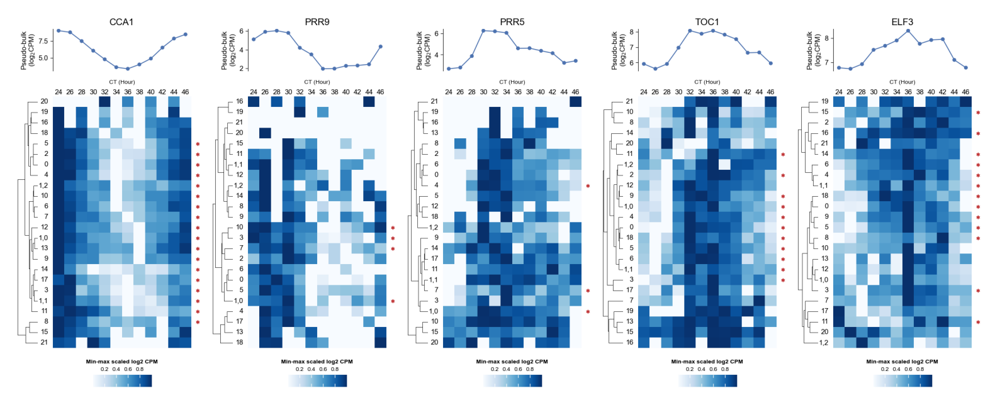

In [172]:
display(a.show())

In [173]:
ls_plotGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
    'AT5G57360',
    'AT3G02780'
]
ls_plotNames = [
    "CCA1",
    "LHY",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "GI",
    "BOA",
    "LUX",
    "ELF4",
    "ELF3",
    'ZTL',
    'IPP2'
]
dt_plotGenes = dict(zip(ls_plotNames, ls_plotGenes))
dt_plotGenes

{'CCA1': 'AT2G46830',
 'LHY': 'AT1G01060',
 'PRR9': 'AT2G46790',
 'PRR7': 'AT5G02810',
 'RVE8': 'AT3G09600',
 'RVE6': 'AT5G52660',
 'RVE4': 'AT5G02840',
 'LNK1': 'AT5G64170',
 'LNK2': 'AT3G54500',
 'PRR5': 'AT5G24470',
 'PRR3': 'AT5G60100',
 'TOC1': 'AT5G61380',
 'GI': 'AT1G22770',
 'BOA': 'AT5G59570',
 'LUX': 'AT3G46640',
 'ELF4': 'AT2G40080',
 'ELF3': 'AT2G25930',
 'ZTL': 'AT5G57360',
 'IPP2': 'AT3G02780'}

In [233]:
# ls_symOrder = ['CCA1', 'RVE4', 'RVE8', 'LHY', 'LNK1', 'LNK2', 'PRR9', 'PRR7', 'PRR5', 'PRR3', 'TOC1', 'GI', 'LUX', 'ELF4', 'ELF3', 'BOA', 'ZTL', 'RVE6', 'IPP2']
# dt_plotGenes = {k:dt_plotGenes[k] for k in ls_symOrder}

ls_symOrder = "CCA1, LHY, RVE4, RVE8, RVE6, LNK1, LNK2, PRR9, PRR7, PRR5, PRR3, TOC1, GI, LUX, ELF4, ELF3, ZTL".split(', ')
dt_plotGenes = {k:dt_plotGenes[k] for k in ls_symOrder}

In [234]:
import scipy

In [252]:
ls_fig = []
for name, gene in dt_plotGenes.items():
    h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
    # h.add_dendrogram('left', method='ward', add_divider=False)
    ar_linkage = scipy.cluster.hierarchy.linkage(h.get_deform().data, method='ward', optimal_ordering=True)
    h.add_dendrogram('left', linkage=ar_linkage, add_divider=False)
    _df = (
        ad_mergeAllCt[:, [gene]]
        .to_df("normalize_log")
        .join(ad_mergeAllCt.obs[["CT"]])
    )

    _df = _df.melt("CT", var_name="gene", value_name="CPM")
    _df["name"] = name


    h.add_top(
        utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
    )

    h.add_legends(side="bottom")
    # fig = plt.figure(figsize=(3.3, 6))
    h.add_top(mp.Title(name, fontsize=16))
    plt.close()
    h.add_right(
    utils.SoMarkForJtkAnno(
            np.array([ad.obs['leiden_subcluster'].cat.categories,]), 
            'jtkAnno',df_jtkCpm.query("CycID == @gene")['cluster'].to_list(),
        ), size=0.3
    )
    h.render()
    h._legend_box.loc = 8
    ls_fig.append(h.figure)
    plt.close()

[Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]
[Text(0, 0.0, '0.0'), Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]
[Text(0, 2.0, '2'), Text(0, 3.0, '3'), Text(0, 4.0, '4'), Text(0, 5.0, '5'), Text(0, 6.0, '6'), Text(0, 7.0, '7'), Text(0, 8.0, '8'), Text(0, 9.0, '9'), Text(0, 10.0, '10'), Text(0, 11.0, '11')]
[Text(0, 0.0, '0'), Text(0, 2.0, '2'), Text(0, 4.0, '4'), Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18'), Text(0, 20.0, '20')]
[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]
[Text(0, 2.0, '2

In [253]:
from jpy_tools.otherTools import FigConcate

In [264]:
len(ls_fig)

17

In [263]:
ls_fig = [FigConcate(x) for x in ls_fig]

In [265]:
_ls = []
for i in range(0, len(ls_fig), 6):
    _ls.append(reduce(lambda x, y: x | y, ls_fig[i:i+6]))
fig = reduce(lambda x, y: x / y, _ls)

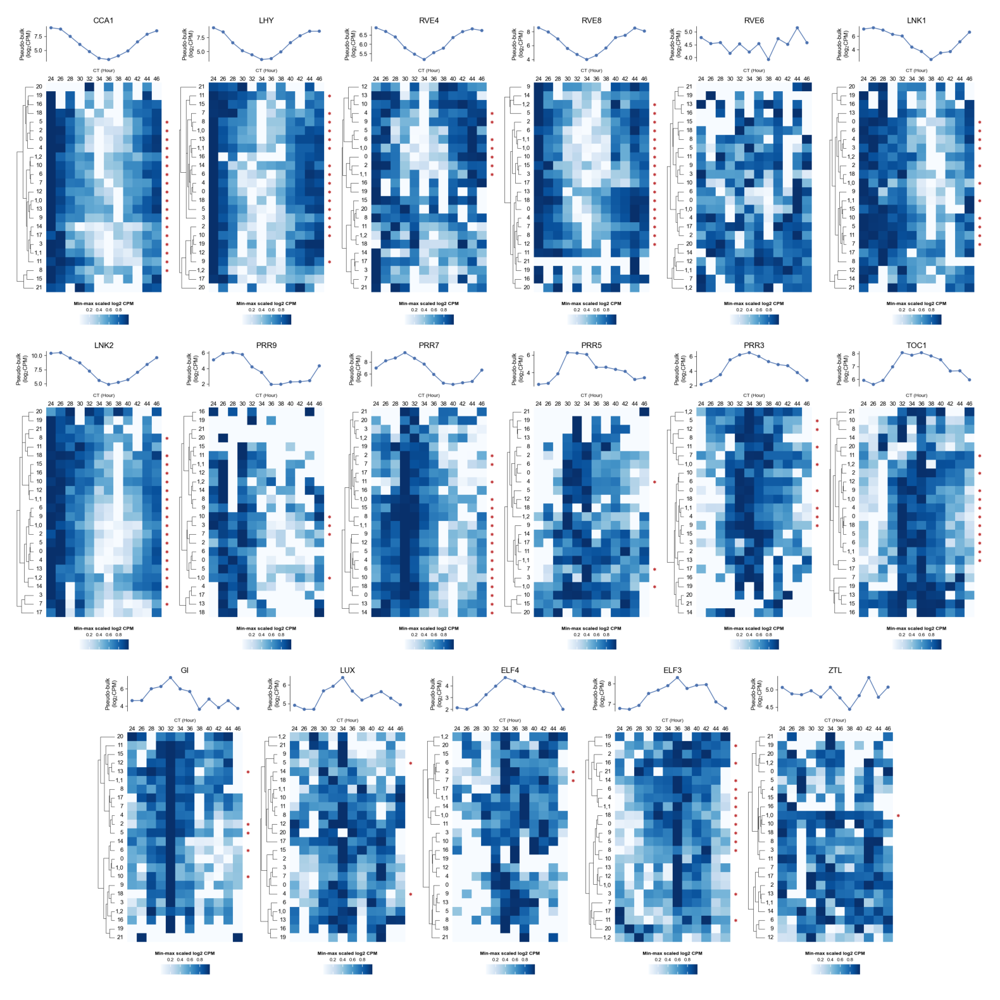

In [266]:
fig.show(figsize=(20, 10))

In [257]:
np.median(ad.layers['raw'].sum(1), axis=0)

matrix([[910.]], dtype=float32)

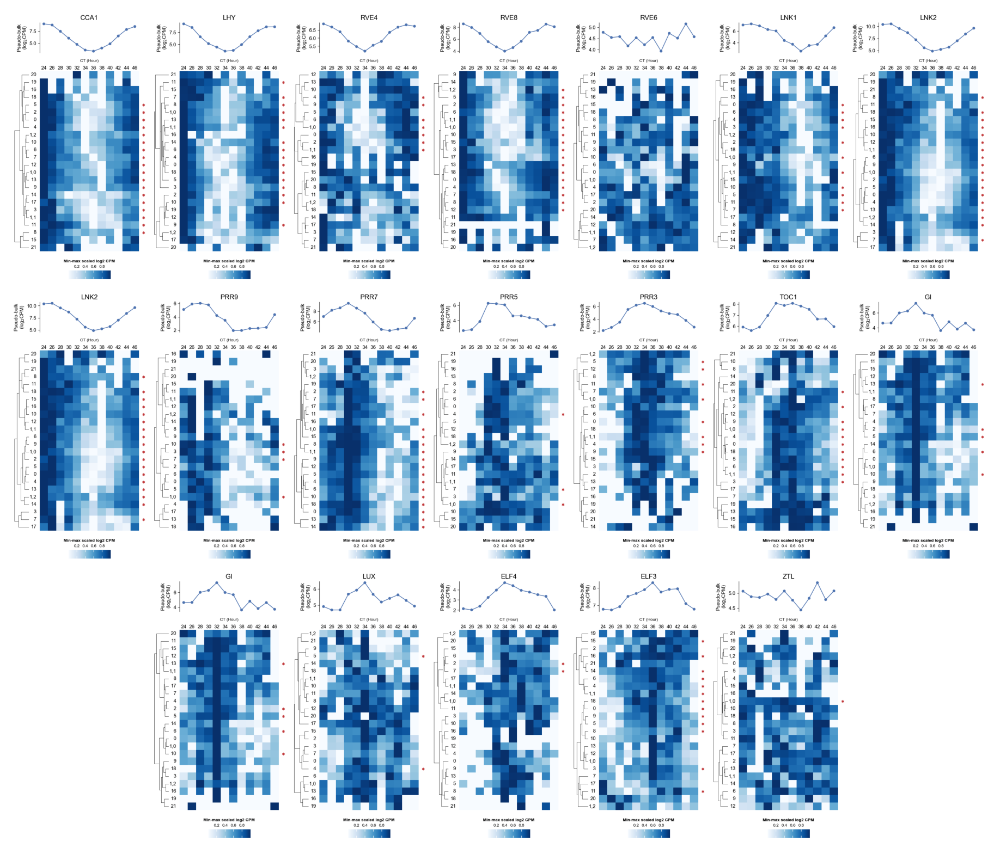

In [258]:
fig.show(figsize=(20, 10))

In [ ]:
for sample, _ad in singleCellTools.basic.splitAdata(ad, 'CT', copy=False, needName=True, disableBar=True):
    a = np.mean(_ad.layers['raw'].sum(1), axis=0)
    print(sample, a)

24 [[1286.9791]]
26 [[1149.6716]]
28 [[1101.7122]]
30 [[1192.4655]]
32 [[842.2838]]
34 [[1221.5568]]
36 [[914.2048]]
38 [[1041.1285]]
40 [[987.61224]]
42 [[951.6565]]
44 [[1365.4025]]
46 [[1052.6747]]


In [513]:
import scipy

<Axes: >

<Axes: >

In [560]:
h.get_ax('clusterLabel').get_ylim()

(0.0, 1.0)

In [ ]:
h.get_ax('clusterLabel')

In [543]:
h.get_ax('clusterLabel').texts[0]

Text(0.9463806970509383, 0.9791666666666666, '19')

In [561]:
h.get_ax('clusterLabel').texts[-1]

Text(0.9463806970509383, 0.020833333333333332, '1,2')

2023-09-13 19:48:52 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:48:52 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:48:52 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:48:52 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]


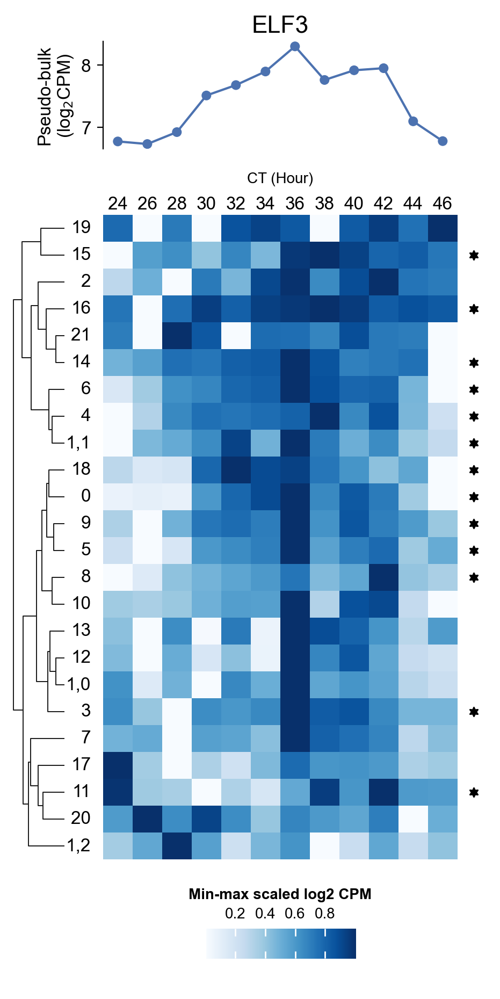

In [535]:
h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
# h.add_dendrogram('left', method='ward', add_divider=False)
ar_linkage = scipy.cluster.hierarchy.linkage(h.get_deform().data, method='ward', optimal_ordering=True)
h.add_dendrogram('left', linkage=ar_linkage, add_divider=False, name='dendro')
_df = (
    ad_mergeAllCt[:, [gene]]
    .to_df("normalize_log")
    .join(ad_mergeAllCt.obs[["CT"]])
)

_df = _df.melt("CT", var_name="gene", value_name="CPM")
_df["name"] = name


h.add_top(
    utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
)

h.add_legends(side="bottom")
# fig = plt.figure(figsize=(3.3, 6))
h.add_top(mp.Title(name, fontsize=16))
plt.close()
h.add_right(
utils.SoMarkForJtkAnno(
        np.array([ad.obs['leiden_subcluster'].cat.categories,]), 
        'jtkAnno',df_jtkCpm.query("CycID == @gene")['cluster'].to_list(),
    ), size=0.3, name='jtkAnno'
)
h.render()
h._legend_box.loc = 8
# h.get_main_ax().invert_yaxis()
h.get_ax('clusterLabel').invert_yaxis()
# h.get_ax("dendro").invert_yaxis()
# h.get_ax("jtkAnno").invert_yaxis()
ls_fig.append(h.figure)

2023-09-13 19:47:08 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:47:08 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:47:08 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-13 19:47:08 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 2.5, '2.5'), Text(0, 5.0, '5.0'), Text(0, 7.5, '7.5'), Text(0, 10.0, '10.0'), Text(0, 12.5, '12.5'), Text(0, 15.0, '15.0'), Text(0, 17.5, '17.5'), Text(0, 20.0, '20.0'), Text(0, 22.5, '22.5')]


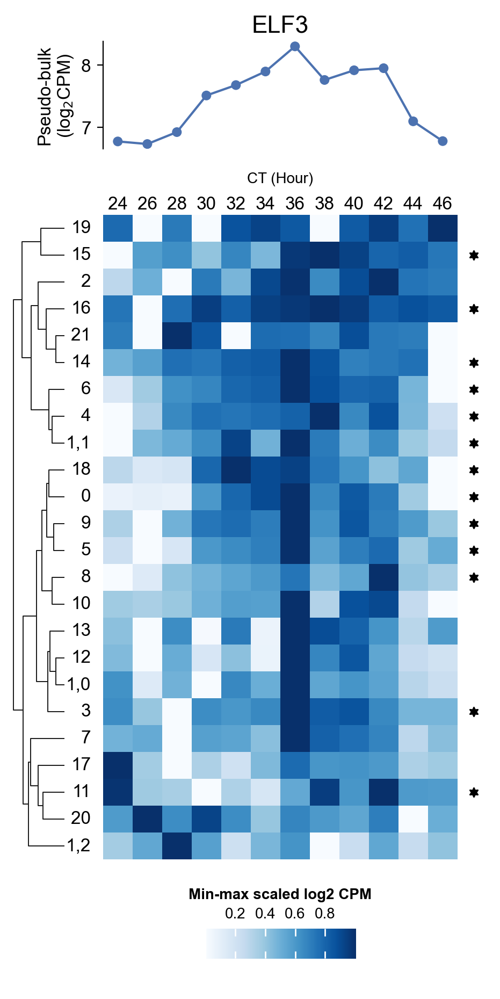

In [534]:
h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
# h.add_dendrogram('left', method='ward', add_divider=False)
ar_linkage = scipy.cluster.hierarchy.linkage(h.get_deform().data, method='ward', optimal_ordering=True)
h.add_dendrogram('left', linkage=ar_linkage, add_divider=False, name='dendro')
_df = (
    ad_mergeAllCt[:, [gene]]
    .to_df("normalize_log")
    .join(ad_mergeAllCt.obs[["CT"]])
)

_df = _df.melt("CT", var_name="gene", value_name="CPM")
_df["name"] = name


h.add_top(
    utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
)

h.add_legends(side="bottom")
# fig = plt.figure(figsize=(3.3, 6))
h.add_top(mp.Title(name, fontsize=16))
plt.close()
h.add_right(
utils.SoMarkForJtkAnno(
        np.array([ad.obs['leiden_subcluster'].cat.categories,]), 
        'jtkAnno',df_jtkCpm.query("CycID == @gene")['cluster'].to_list(),
    ), size=0.3, name='jtkAnno'
)
h.render()
h._legend_box.loc = 8
ls_fig.append(h.figure)

# S-MOD

In [156]:
def sMod(N, m, n1, n2):
    import math

    p = 0
    denominator = math.comb(N, n1) * math.comb(N, n2)
    for i in range(m, min(n1, n2) + 1):
        numerator = (
            math.comb(N, i) * math.comb(N - i, n1 - i) * math.comb(N - n1, n2 - i)
        )
        p += numerator / denominator
    return p

In [157]:
df_jtkCpm

,CycID,BH.Q,ADJ.P,PER,LAG,AMP,celltype,idxMax,phase,orgPhase,stdPhase,cluster
6,AT1G01060,0.017429,0.000530,24.0,22.0,4.364806,0,24,22,21.331633,0.332851,0
17,AT1G01220,0.144430,0.021639,24.0,9.0,0.314376,0,32,8,7.665633,1.013252,0
20,AT1G01240,0.028949,0.001289,24.0,6.0,1.879355,0,30,4,4.866908,0.505334,0
21,AT1G01260,0.201778,0.038180,24.0,4.0,0.440212,0,28,4,4.195647,1.061341,0
36,AT1G01500,0.100355,0.011694,24.0,8.0,1.176311,0,32,8,7.609895,0.689213,0
...,...,...,...,...,...,...,...,...,...,...,...,...
523,AT4G13940,1.000000,0.038180,24.0,7.0,1.367159,21,28,4,4.168002,1.612945,21
542,AT4G19160,1.000000,0.016667,24.0,16.0,0.714454,21,42,16,15.127476,1.339334,21
653,AT5G07350,1.000000,0.011694,24.0,3.0,0.716104,21,26,2,2.516495,0.705444,21
773,AT5G47430,1.000000,0.038180,24.0,6.0,1.212516,21,28,6,5.358547,0.827009,21


In [158]:
df_smod = pd.DataFrame(
    index=df_jtkCpm["cluster"].unique(), columns=df_jtkCpm["cluster"].unique()
)
df_smod = df_smod.melt(ignore_index=False).reset_index()
df_smod.columns = ["celltype1", "celltype2", "sMod_p"]

In [159]:
df_smod

,celltype1,celltype2,sMod_p
0,0,0,NaN
1,"1,0",0,NaN
2,"1,1",0,NaN
3,"1,2",0,NaN
4,2,0,NaN
...,...,...,...
571,17,21,NaN
572,18,21,NaN
573,19,21,NaN
574,20,21,NaN


In [161]:
from itertools import product

N = len(df_jtkCpm["CycID"].unique())
for tp_line in df_smod.itertuples():
    x = tp_line.celltype1
    y = tp_line.celltype2
    m = len(
        set(df_jtkCpm.query("cluster == @x")["CycID"])
        & set(df_jtkCpm.query("cluster == @y")["CycID"])
    )
    n1 = len(df_jtkCpm.query("cluster == @x")["CycID"].unique())
    n2 = len(df_jtkCpm.query("cluster == @y")["CycID"].unique())
    df_smod.loc[tp_line.Index, "N"] = N
    df_smod.loc[tp_line.Index, "m"] = m
    df_smod.loc[tp_line.Index, "n1"] = n1
    df_smod.loc[tp_line.Index, "n2"] = n2

In [162]:
df_smod["N"] = df_smod["N"].astype(int)
df_smod["m"] = df_smod["m"].astype(int)
df_smod["n1"] = df_smod["n1"].astype(int)
df_smod["n2"] = df_smod["n2"].astype(int)

In [163]:
from joblib import Parallel, delayed

ls_modP = Parallel(n_jobs=64)(
    delayed(sMod)(N, m, n1, n2)
    for (N, m, n1, n2) in df_smod[["N", "m", "n1", "n2"]].itertuples(index=False)
)

In [164]:
df_smod["sMod_p"] = ls_modP

In [165]:
df_smod.loc[df_smod["celltype1"] == df_smod["celltype2"], "sMod_p"] = 1

In [166]:
df_smod["sMod"] = -np.log10(df_smod["sMod_p"])

In [167]:
df_smod["qmod"] = df_smod["m"] / df_smod["n1"]

In [168]:
df_smod.loc[df_smod["celltype1"] == df_smod["celltype2"], "qmod"] = 0

In [169]:
import matplotlib as mpl

In [170]:
import scipy

In [171]:
_df = df_smod.pivot_table(columns="celltype2", index="celltype1", values="sMod")
_linkage = scipy.cluster.hierarchy.linkage(_df, method="ward")

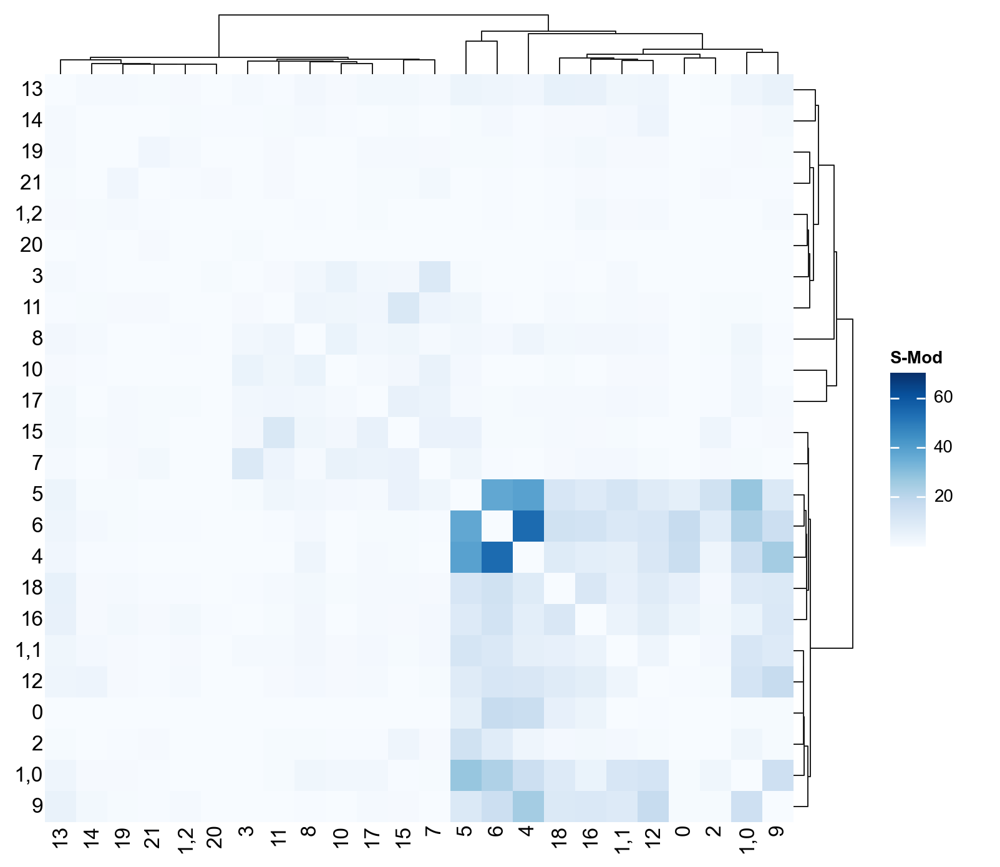

In [174]:
import scipy
import legendkit
import marsilea as ma
import marsilea.plotter as mp

_linkage = scipy.cluster.hierarchy.linkage(_df, method="ward")

g = ma.Heatmap(_df, cmap="Blues",  label="S-Mod", width=6, height=6, vmax=70)
g.add_left(mp.Labels(_df.index))
g.add_bottom(mp.Labels(_df.columns))
g.add_dendrogram("right", linkage=_linkage)
g.add_dendrogram("top", linkage=_linkage)
g.add_legends()
g.render()

## each phase

In [176]:
def sMod(N, m, n1, n2):
    import math

    p = 0
    denominator = math.comb(N, n1) * math.comb(N, n2)
    for i in range(m, min(n1, n2) + 1):
        numerator = (
            math.comb(N, i) * math.comb(N - i, n1 - i) * math.comb(N - n1, n2 - i)
        )
        p += numerator / denominator
    return p

In [178]:
df_jtkCpm["ct:phase"] = df_jtkCpm["cluster"] + ":" + df_jtkCpm["phase"].astype(str)

In [179]:
df_smodPhase = pd.DataFrame(
    index=df_jtkCpm["ct:phase"].unique(), columns=df_jtkCpm["ct:phase"].unique()
)
df_smodPhase = df_smodPhase.melt(ignore_index=False).reset_index()
df_smodPhase.columns = ["ctPhase1", "ctPhase2", "sMod_p"]

In [180]:
from itertools import product
from tqdm import tqdm

N = len(df_jtkCpm["CycID"].unique())
for tp_line in tqdm(df_smodPhase.itertuples(), total=len(df_smodPhase)):
    x = tp_line.ctPhase1
    y = tp_line.ctPhase2
    m = len(
        set(df_jtkCpm.query("`ct:phase` == @x")["CycID"])
        & set(df_jtkCpm.query("`ct:phase` == @y")["CycID"])
    )
    n1 = len(df_jtkCpm.query("`ct:phase` == @x")["CycID"].unique())
    n2 = len(df_jtkCpm.query("`ct:phase` == @y")["CycID"].unique())
    df_smodPhase.loc[tp_line.Index, "N"] = N
    df_smodPhase.loc[tp_line.Index, "m"] = m
    df_smodPhase.loc[tp_line.Index, "n1"] = n1
    df_smodPhase.loc[tp_line.Index, "n2"] = n2

  0%|          | 0/72900 [00:00<?, ?it/s]

100%|██████████| 72900/72900 [18:23<00:00, 66.09it/s]


In [181]:
df_smodPhase["N"] = df_smodPhase["N"].astype(int)
df_smodPhase["m"] = df_smodPhase["m"].astype(int)
df_smodPhase["n1"] = df_smodPhase["n1"].astype(int)
df_smodPhase["n2"] = df_smodPhase["n2"].astype(int)

In [182]:
from joblib import Parallel, delayed

ls_modP = Parallel(n_jobs=64)(
    delayed(sMod)(N, m, n1, n2)
    for (N, m, n1, n2) in tqdm(
        df_smodPhase[["N", "m", "n1", "n2"]].itertuples(index=False),
        total=len(df_smodPhase),
    )
)

  0%|          | 0/72900 [00:00<?, ?it/s]

100%|██████████| 72900/72900 [05:15<00:00, 231.01it/s]


In [183]:
df_smodPhase["sMod_p"] = ls_modP

In [184]:
df_smodPhase.loc[df_smodPhase["ctPhase1"] == df_smodPhase["ctPhase2"], "sMod_p"] = 1

In [185]:
df_smodPhase["sMod"] = -np.log10(df_smodPhase["sMod_p"])

In [186]:
df_smodPhase["qmod"] = df_smodPhase["m"] / df_smodPhase["n1"]

In [187]:
df_smodPhase.loc[df_smodPhase["ctPhase1"] == df_smodPhase["ctPhase2"], "qmod"] = 0

In [188]:
_df = df_smod.pivot_table(columns="celltype2", index="celltype1", values="sMod")
_linkage = scipy.cluster.hierarchy.linkage(_df, method="ward")
ls_clusterOrder = _df.index

In [195]:
_ls = df_smodPhase["ctPhase1"].unique().tolist()
_ls_phase = (
    _ls >> F(map, lambda x: x.split(":")[-1]) >> F(set) >> F(list) >> F(sorted, key=int)
)

ls_figArray = []
for phase in _ls_phase:
    _re = rf":{phase}\b"
    _df = df_smodPhase.query(
        f"ctPhase1.str.contains(@_re, regex=True) & ctPhase2.str.contains(@_re, regex=True)"
    )
    _df = _df.pivot_table(columns="ctPhase1", index="ctPhase2", values="sMod").fillna(0)
    _df.index = _df.index.map(lambda x: ":".join(x.split(":")[:-1]))
    _df.columns = _df.columns.map(lambda x: ":".join(x.split(":")[:-1]))
    _df = _df.reindex(index=ls_clusterOrder, columns=ls_clusterOrder).fillna(0)

    _ls_cluster = _df.index

    fig = plt.figure(figsize=(12, 12))
    g = ma.Heatmap(_df + 0.0001, cmap="Blues", label="S-Mod", vmax=40, vmin=0)

    dt_colors = {str(x): y for x, y in zip(range(22), sc.pl.palettes.default_28)}
    g.add_left(mp.Labels(_df.index))
    g.add_bottom(mp.Labels(_df.columns))
    g.add_dendrogram("right", linkage=_linkage)
    g.add_dendrogram("top", linkage=_linkage)
    g.add_legends()
    g.add_top(ma.plotter.Title(f"CT {phase}", fontsize=26))
    g.render(fig)
    plt.close()
    ls_figArray.append(FigConcate(fig))

In [196]:
from functools import reduce

lsFig = []
for i in range(0, len(ls_figArray), 4):
    lsFig.append(reduce(lambda x, y: x | y, ls_figArray[i : i + 4]))
ar_fig = reduce(lambda x, y: x / y, lsFig)

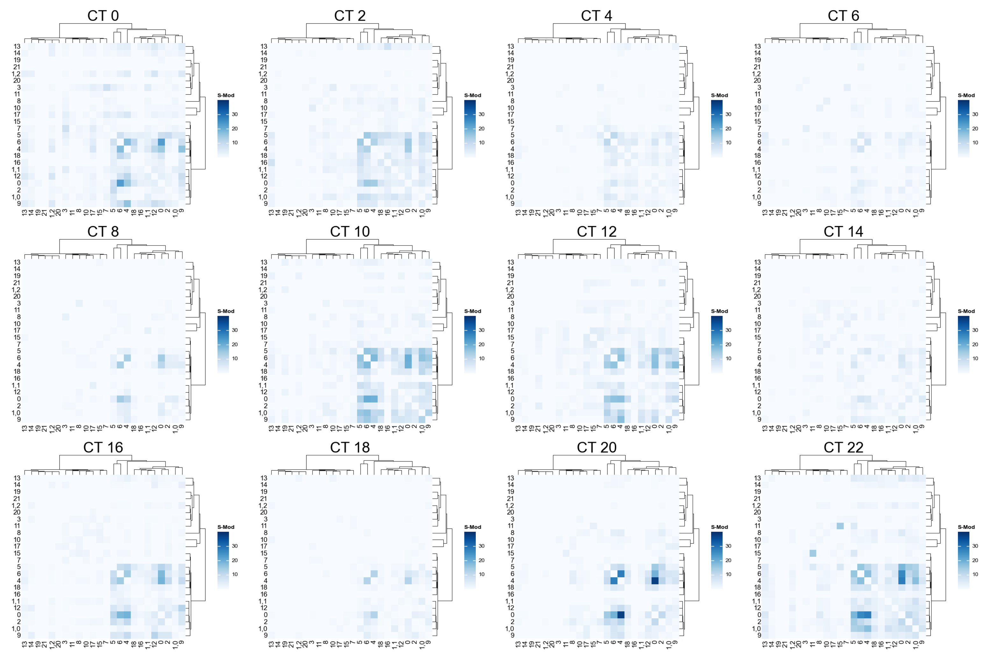

In [197]:
ar_fig.show((20, 20))

# phase compare

In [271]:
import re
dt_cluster2Tissue = {x: re.findall(r"\(([\w\W]+)\)", y)[0] for x,y in dt_anno.items()}
dt_cluster2Tissue = {x:y if y != 'Unknown' else "Stele" for x,y in dt_cluster2Tissue.items()}

In [272]:
df_jtkCpmCoreGene = df_jtkCpm.query("CycID.isin(@dt_plotGenes.values())")
df_jtkCpmCoreGene = df_jtkCpmCoreGene.assign(
        minPhase = lambda _: _.orgPhase - _.stdPhase, 
        maxPhase = lambda _: _.orgPhase + _.stdPhase, 
        CycID=lambda _: _.CycID.map(dt_coreGene), 
        tissue=lambda _: _.cluster.map(dt_cluster2Tissue)
    ).reset_index()

In [273]:
df_jtkCpmCoreGene['groups'] = ''

In [274]:
df_jtkCpmRaw = ad.uns["soupx_jtkCycleCpmLog_leidenSub"]
df_jtkCpmRaw = df_jtkCpmRaw.assign(cluster = lambda _: _.celltype.str.split(':').str[0])

In [275]:
import scipy
def getJtkDiff(df_orgJtk, ls_pubCircadianGenes):
    df_orgJtkForDiff = df_orgJtk.pivot_table(index='CycID', columns='cluster', values=['orgPhase', 'stdPhase', 'ADJ.P', 'AMP'])
    def _getDiff(celltype1, celltype2):
        df_jtkDiff = pd.DataFrame(index=df_orgJtkForDiff.index)
        df_jtkDiff['celltype1'] = celltype1
        df_jtkDiff['celltype2'] = celltype2
        df_jtkDiff['phase1'] = df_orgJtkForDiff['orgPhase'][celltype1]
        df_jtkDiff['phase2'] = df_orgJtkForDiff['orgPhase'][celltype2]
        df_jtkDiff['std1'] = df_orgJtkForDiff['stdPhase'][celltype1]
        df_jtkDiff['std2'] = df_orgJtkForDiff['stdPhase'][celltype2]
        df_jtkDiff['pvalue1'] = df_orgJtkForDiff['ADJ.P'][celltype1]
        df_jtkDiff['pvalue2'] = df_orgJtkForDiff['ADJ.P'][celltype2]
        df_jtkDiff['amp1'] = df_orgJtkForDiff['AMP'][celltype1]
        df_jtkDiff['amp2'] = df_orgJtkForDiff['AMP'][celltype2]

        df_jtkDiff.dropna(subset=['phase1', 'phase2', 'std1', 'std2'], inplace=True)

        df_jtkDiff['diff'] = (df_jtkDiff['phase1'] - df_jtkDiff['phase2']).abs()
        df_jtkDiff['diff'] = np.where(df_jtkDiff['diff'] < 12, df_jtkDiff['diff'], 24-df_jtkDiff['diff'])
        df_jtkDiff['diff_std'] = (df_jtkDiff['std1']**2 + df_jtkDiff['std2']**2)**0.5
        df_jtkDiff['zscore'] = df_jtkDiff['diff'] / df_jtkDiff['diff_std']
        df_jtkDiff['pdiff'] = (1 - scipy.stats.norm.cdf(df_jtkDiff['zscore'])) * 2
        df_jtkDiff['bulk'] = df_jtkDiff.index.isin(ls_pubCircadianGenes)
        return df_jtkDiff
    return _getDiff

In [276]:
from itertools import combinations
for gene in ls_coreGenes:
    _df = df_jtkCpmRaw.query("CycID == @gene & `ADJ.P` < 0.05")
    _fc = getJtkDiff(_df, ls_pubCircadianGenes)
    if _df.empty | _df.shape[0] == 1:
        continue
    df_jtkDIffPvalue = pd.DataFrame(combinations(_df['cluster'].unique(), 2), columns=['row', 'col'])
    df_jtkDIffPvalue = df_jtkDIffPvalue.assign(pdiff=df_jtkDIffPvalue.apply(lambda _: _fc(_['row'], _['col'])['pdiff'].iat[0], axis=1)).rename(columns={'pdiff': 'p-adj'})
    from jpy_tools import otherTools
    _dt = otherTools.cld(df_jtkDIffPvalue, 0.1, _df.sort_values('orgPhase')['cluster'].to_list())
    df_jtkCpmCoreGene.loc[df_jtkCpmCoreGene['CycID'] == dt_coreGene[gene], 'groups'] = df_jtkCpmCoreGene.loc[df_jtkCpmCoreGene['CycID'] == dt_coreGene[gene], 'cluster'].map(_dt)

In [283]:
len(ls_symOrder)

17

In [285]:
df_jtkCpmCoreGene['CycID'] = df_jtkCpmCoreGene['CycID'].astype('category').cat.set_categories(ls_symOrder).cat.remove_unused_categories()

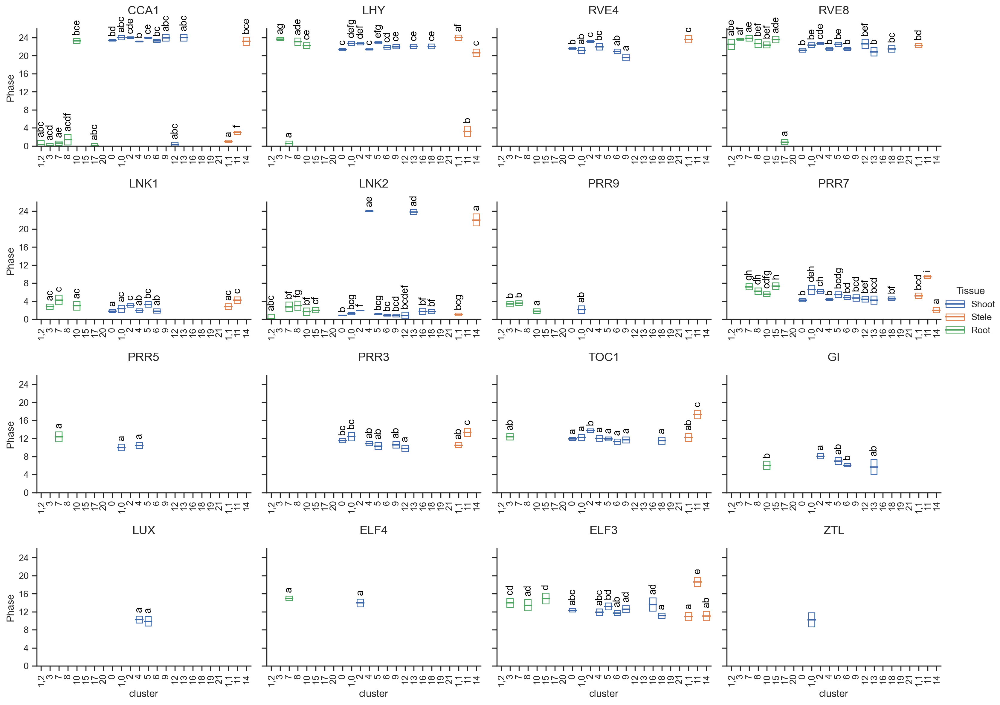

In [289]:
g = (
    so.Plot(df_jtkCpmCoreGene, x='cluster', color='tissue', text='groups')
    .facet(col='CycID', wrap=4)
    .add(Box(fill=False), ymin='minPhase', ymax='maxPhase')
    .add(so.Dash(), y='orgPhase')
    .add(so.Text(valign='bottom', color='black'), y='maxPhase')
    .layout(size=(16,12))
    .scale(
        x=so.Nominal(order=sorted(dt_cluster2Tissue, key=lambda _: dt_cluster2Tissue[_])),
        y=so.Continuous().tick(every=4, between=(0, 24)),
        color={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
    )
    .limit(y=(0, 26))
    .theme(dt_snsStyle)
    .label(y='Phase', color='Tissue')
    .plot()
)
g._repr_png_()
fig = g._figure
for ax in fig.axes:
    ax.tick_params(labelbottom=True)
    ax.texts >> F(map, lambda _: _.set(rotation=90, clip_on=False)) >> F(list)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_title(ax.get_title(), y=1.08)
fig

In [405]:
_df = ad_merge[:, ['AT2G46830', 'AT5G61380']].to_df("normalize").join(ad_merge.obs[['CT', 'recluster_ct']]).melt(['CT', 'recluster_ct'])
_df = _df.assign(recluster_ct=lambda _: _.recluster_ct.str.replace(' \(', '\n('))

In [406]:
dt_snsStyle['legend.frameon'] = False

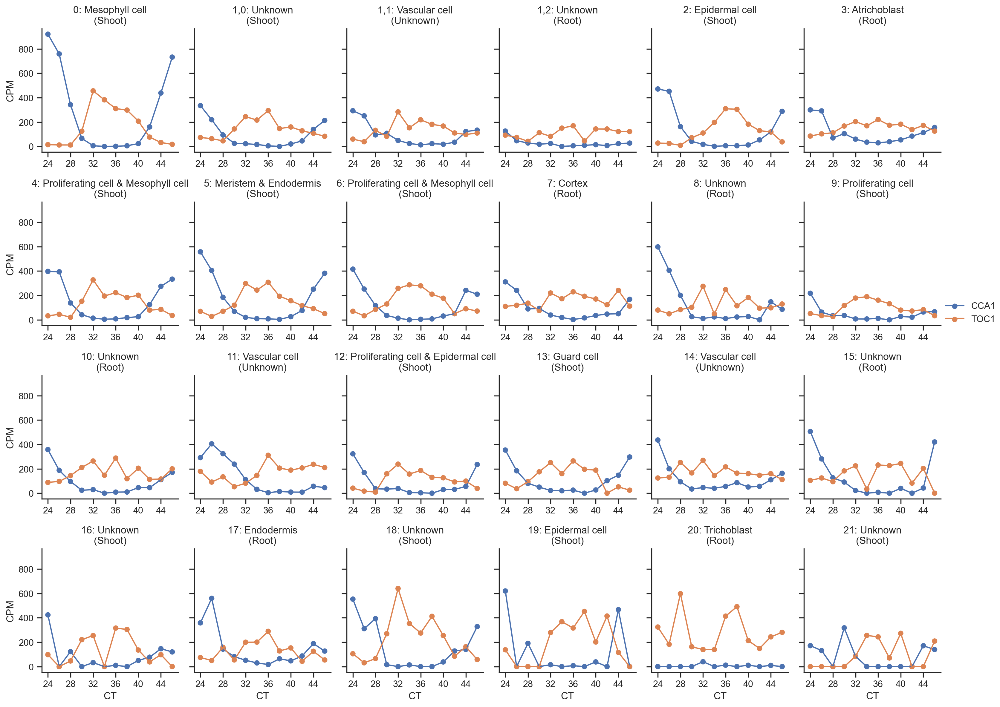

In [407]:
s = (
    so.Plot(_df.assign(CT=lambda _: _.CT.astype(int), variable=lambda _: _.variable.map(dt_coreGene)), x='CT', y='value', color='variable')
    .facet(col='recluster_ct', wrap=6)
    .add(so.Line())
    .add(so.Dot())
    .layout(size=(16, 12))
    .theme(dt_snsStyle)
    .scale(x=so.Continuous().tick(every=4))
    .label(y="CPM", color='')
)
sp = s.plot()
sp._repr_png_()
fig = sp._figure
for ax in fig.get_axes():
    ax.xaxis.set_tick_params(labelbottom=True)
fig

In [389]:
ad_

,CT,Batch
24,24,1
26,26,2
28,28,1
30,30,2
32,32,1
34,34,2
36,36,1
38,38,2
40,40,1
42,42,2


## phase with S-MOD

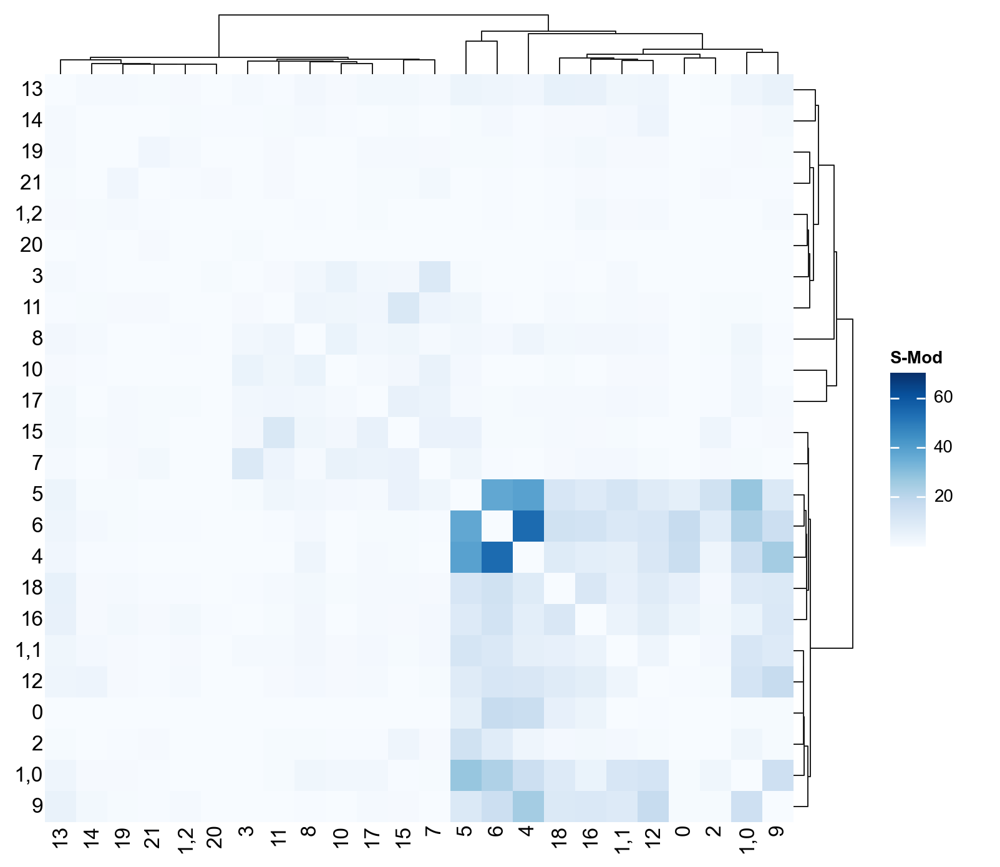

In [ ]:
import scipy
import legendkit
import marsilea as ma
import marsilea.plotter as mp

_linkage = scipy.cluster.hierarchy.linkage(_df, method="ward")

g = ma.Heatmap(_df, cmap="Blues",  label="S-Mod", width=6, height=6, vmax=70)
g.add_left(mp.Labels(_df.index))
g.add_bottom(mp.Labels(_df.columns))
g.add_dendrogram("right", linkage=_linkage)
g.add_dendrogram("top", linkage=_linkage)
g.add_legends()
g.render()

In [371]:
ls_clusterForComparePhase = ['5', '6', '4', '18', '16', '1,1', '12', '0', '2', '1,0', '9']

In [373]:
from itertools import permutations

In [300]:
cluster1 = '0'
cluster2 = '2'

In [323]:
import scipy
def getJtkDiff(df_orgJtk):
    df_orgJtkForDiff = df_orgJtk.pivot_table(index='CycID', columns='cluster', values=['orgPhase', 'stdPhase', 'ADJ.P', 'AMP'])
    def _getDiff(celltype1, celltype2):
        df_jtkDiff = pd.DataFrame(index=df_orgJtkForDiff.index)
        df_jtkDiff['celltype1'] = celltype1
        df_jtkDiff['celltype2'] = celltype2
        df_jtkDiff['phase1'] = df_orgJtkForDiff['orgPhase'][celltype1]
        df_jtkDiff['phase2'] = df_orgJtkForDiff['orgPhase'][celltype2]
        df_jtkDiff['std1'] = df_orgJtkForDiff['stdPhase'][celltype1]
        df_jtkDiff['std2'] = df_orgJtkForDiff['stdPhase'][celltype2]
        df_jtkDiff['pvalue1'] = df_orgJtkForDiff['ADJ.P'][celltype1]
        df_jtkDiff['pvalue2'] = df_orgJtkForDiff['ADJ.P'][celltype2]
        df_jtkDiff['amp1'] = df_orgJtkForDiff['AMP'][celltype1]
        df_jtkDiff['amp2'] = df_orgJtkForDiff['AMP'][celltype2]

        df_jtkDiff.dropna(subset=['phase1', 'phase2', 'std1', 'std2'], inplace=True)

        df_jtkDiff['diff'] = (df_jtkDiff['phase1'] - df_jtkDiff['phase2']).abs()
        df_jtkDiff['diff'] = np.where(df_jtkDiff['diff'] < 12, df_jtkDiff['diff'], 24-df_jtkDiff['diff'])
        df_jtkDiff['diff_std'] = (df_jtkDiff['std1']**2 + df_jtkDiff['std2']**2)**0.5
        df_jtkDiff['zscore'] = df_jtkDiff['diff'] / df_jtkDiff['diff_std']
        df_jtkDiff['pdiff'] = (1 - scipy.stats.norm.cdf(df_jtkDiff['zscore'])) * 2
        return df_jtkDiff
    return _getDiff

In [345]:
import tqdm
def getAllJtkDiff(df_jtkCpm, cluster1, cluster2):
    ls_geneOscInBothCluster = df_jtkCpm.query("cluster == @cluster1 | cluster == @cluster2").value_counts("CycID").loc[lambda _: _>1].index.to_list()
    _ls = []
    for gene in tqdm.tqdm(ls_geneOscInBothCluster):
        _df = df_jtkCpm.query("(cluster == @cluster1 | cluster == @cluster2) & CycID == @gene")
        _fc = getJtkDiff(_df)
        _ls.append(_fc(cluster1, cluster2))
    df_dePhase = pd.concat(_ls).assign(phaseDiff = lambda _: _.phase1 - _.phase2)\
    .assign(phaseTrueDiff = lambda _:np.select(
        [_.phaseDiff>12, _.phaseDiff<-12],
        [_.phaseDiff-24, _.phaseDiff+24],
        _.phaseDiff
        ))
    return df_dePhase

In [375]:
from joblib import Parallel, delayed

In [376]:
_ls = Parallel(12)(delayed(getAllJtkDiff)(df_jtkCpm, cluster1, cluster2) for cluster1, cluster2 in permutations(ls_clusterForComparePhase, 2))

100%|██████████| 469/469 [00:12<00:00, 36.41it/s]

In [377]:
df_comparePhaseAllJtkGenes = pd.concat(_ls)

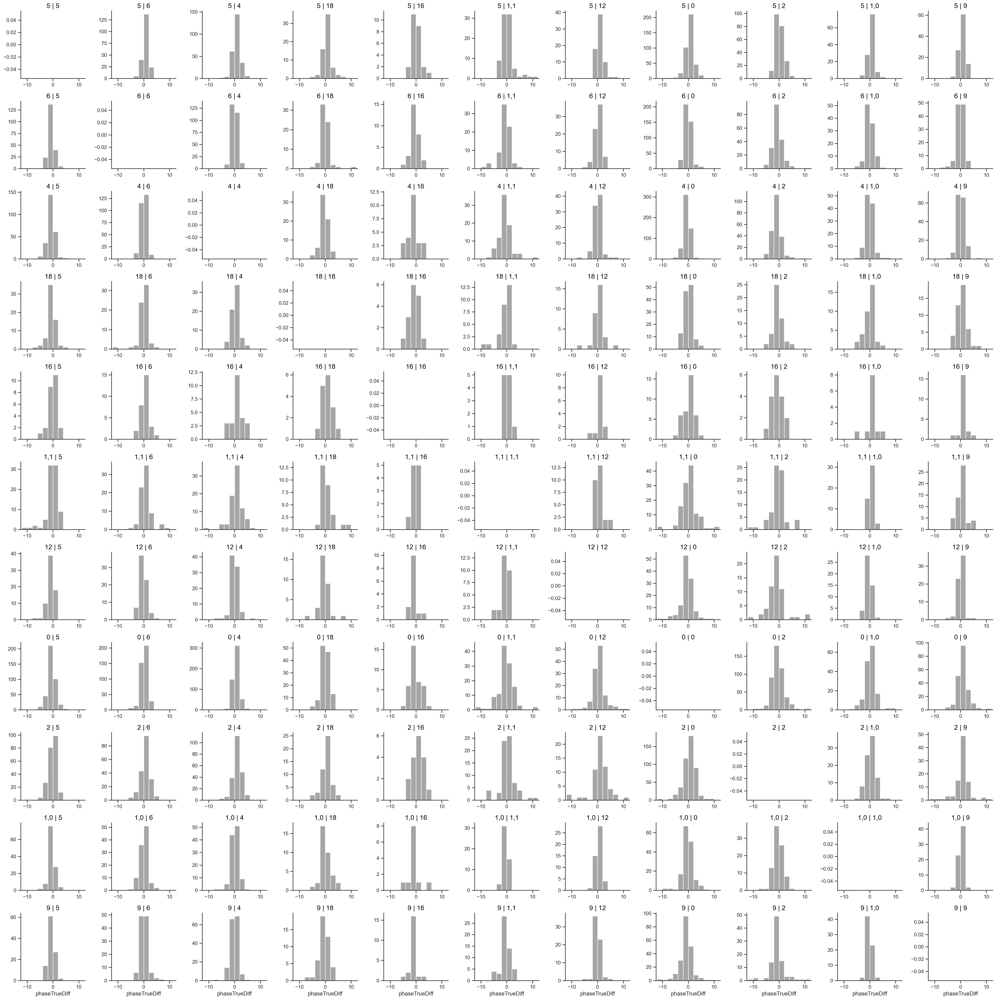

In [420]:
p = (
    so.Plot(df_comparePhaseAllJtkGenes, x='phaseTrueDiff')
    .facet(row='celltype1', col='celltype2', order=dict(col=ls_clusterForComparePhase, row=ls_clusterForComparePhase))
    .share(x=False, y=False)
    .add(so.Bars(), so.Hist(bins=np.arange(-12, 14, 2)))
    .layout(size=(30, 30))
    .limit(x=(-12.5, 12.5))
)
fig = p.plot()._figure
for ax in fig.axes:
    title = ax.get_title()
    x, y = title.split('|')
    x = x.strip()
    y = y.strip()
    ax.set_title(f"{y} | {x}")
fig

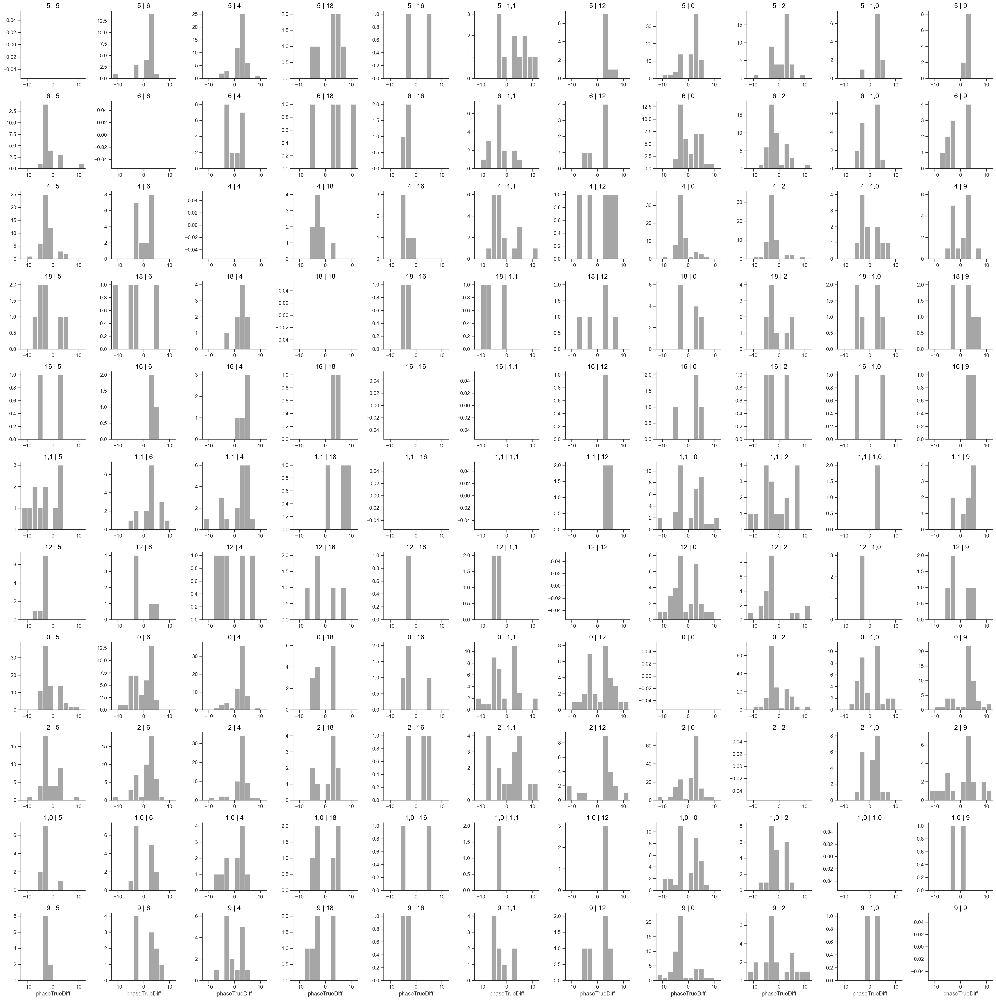

In [419]:
p = (
    so.Plot(df_comparePhaseAllJtkGenes.query("pdiff < 0.05"), x='phaseTrueDiff')
    .facet(row='celltype1', col='celltype2', order=dict(col=ls_clusterForComparePhase, row=ls_clusterForComparePhase))
    .share(x=False, y=False)
    .add(so.Bars(), so.Hist(bins=np.arange(-12, 14, 2)))
    .layout(size=(30, 30))
    .limit(x=(-12.5, 12.5))
)
fig = p.plot()._figure
for ax in fig.axes:
    title = ax.get_title()
    x, y = title.split('|')
    x = x.strip()
    y = y.strip()
    ax.set_title(f"{y} | {x}")
fig

# phase compare new

In [58]:
import re
dt_cluster2Tissue = {x: re.findall(r"\(([\w\W]+)\)", y)[0] for x,y in dt_anno.items()}
dt_cluster2Tissue = {x:y if y != 'Unknown' else "Stele" for x,y in dt_cluster2Tissue.items()}

In [42]:
from jpy_tools.overlapTools import GeneOverlapBase
from itertools import product
from jpy_tools.soExt import Axline
import scipy

In [43]:
class GeneOverlapCircadian(GeneOverlapBase):
    def getDiffPhaseGenes(self, ls_cluster1, ls_cluster2):
        from itertools import product
        def _getDiffPhaseGenes(self, cluster1, cluster2):
            _ls = [cluster1, cluster2]
            df_diff = self.df.query("Cluster in @_ls").pivot_table(["OrgPhase", "StdPhase"], 'Gene', 'Cluster').dropna()
            df_diff = df_diff.rename(columns={cluster1: '1', cluster2: '2'})
            df_diff.columns = ['_'.join(x) for x in df_diff.columns.ravel()]

            df_diff = df_diff.assign(
                diff = lambda _: (_[f"OrgPhase_1"] - _[f"OrgPhase_2"]).abs(),
                diff_std = lambda _: (_[f"StdPhase_1"]**2 + _[f"StdPhase_2"]**2)**0.5
            ).assign(
                diff = lambda _: np.where(_['diff']<12, _['diff'], 24-_['diff'])
            ).assign(
                zscore  = lambda _: _['diff'] / _['diff_std']
            ).assign(
                pdiff = lambda _: (1-scipy.stats.norm.cdf(_['zscore'])) * 2
            ).assign(cluster1 = cluster1, cluster2 = cluster2)
            return df_diff
        
        if isinstance(ls_cluster1, str):
            ls_cluster1 = [ls_cluster1]
        if isinstance(ls_cluster2, str):
            ls_cluster2 = [ls_cluster2]

        _ls = []
        for cluster1, cluster2 in product(ls_cluster1, ls_cluster2):
            _ls.append(_getDiffPhaseGenes(self, cluster1, cluster2))
        df_diff = pd.concat(_ls)
        return df_diff

    def plotDiffPhaseGenes(self, ls_cluster1, ls_cluster2, **kwargs):
        df_diff = self.getDiffPhaseGenes(ls_cluster1, ls_cluster2)
        p = (
            so.Plot(df_diff.query("pdiff <= 0.05"), x=f'OrgPhase_1', y=f'OrgPhase_2')
            .facet(row='cluster1', col='cluster2')
            .add(so.Dot())
            .add(Axline(linestyle='--', color='black'), x=None, y=None, data={})
            .scale(x=so.Continuous().tick(every=4), y=so.Continuous().tick(every=4))
            .layout(size=(5,5))
        )
        pp = p.plot()
        pp._repr_png_()
        fig = pp._figure
        for ax in fig.axes:
            title = ax.get_title()
            y, x = title.split('|')
            x = x.strip()
            y = y.strip()
            ax.set_xlabel(f"Cluster {x}")
            ax.set_ylabel(f"Cluster {y}")
        return p, fig

In [44]:
_ls_gene = df_jtkCpm['CycID'].unique().tolist()
_ls_cluster = ['0', '1,0', '1,1', '1,2', '2', '3', '4', '5', '6', '7', '8', '9',
       '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20',
       '21']

In [45]:
df_jtkResLong = pd.DataFrame([[x,y] for x,y in product(_ls_gene, _ls_cluster)], columns=['Gene', 'Cluster'])
df_jtkResLong = df_jtkResLong.assign(
    Lag = np.nan,
    Amp = np.nan,
    Phase = np.nan,
    OrgPhase = np.nan,
    StdPhase = np.nan,
    Bhq = np.nan,
    AdjP = np.nan
)
df_jtkResLong = df_jtkResLong.merge(df_jtkCpm, how='left', left_on=['Gene', 'Cluster'], right_on=['CycID', 'cluster'])
df_jtkResLong = df_jtkResLong.assign(
    Lag = lambda _: _.LAG,
    Amp = lambda _: _.AMP,
    Phase = lambda _: _.phase,
    OrgPhase = lambda _: _.orgPhase,
    StdPhase = lambda _: _.stdPhase,
    Bhq = lambda _: _['BH.Q'],
    AdjP = lambda _: _['ADJ.P']
).drop(columns=df_jtkCpm.columns)
df_jtkResLong['IsCircadian'] = np.where(np.isnan(df_jtkResLong['Phase']), 'False', 'True')
df_jtkResLong

,Gene,Cluster,Lag,Amp,Phase,OrgPhase,StdPhase,Bhq,AdjP,IsCircadian
0,AT1G01060,0,22.0,4.364806,22.0,21.331633,0.332851,0.017429,0.000530,True
1,AT1G01060,"1,0",0.0,2.822068,22.0,22.741763,0.519526,0.185763,0.000196,True
2,AT1G01060,"1,1",1.0,2.193058,0.0,23.970987,0.720402,0.766520,0.000530,True
3,AT1G01060,"1,2",NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,AT1G01060,2,23.0,3.931844,22.0,22.659124,0.394992,0.064605,0.000530,True
...,...,...,...,...,...,...,...,...,...,...
127099,AT4G13940,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127100,AT4G13940,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127101,AT4G13940,19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127102,AT4G13940,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [46]:
from types import MethodType

In [139]:
# go_jtk.dotplot = MethodType(GeneOverlapBase.dotplot, go_jtk)
# go_jtk.tileplot = MethodType(GeneOverlapBase.tileplot, go_jtk)

In [47]:
go_jtk = GeneOverlapCircadian(df_jtkResLong, 'Gene', groupKey='Cluster', categoryKey='IsCircadian', categoryTarget='True')

In [48]:
go_jtk.getOverlapInfo(diagS=1e-323)

  0%|          | 0/576 [00:00<?, ?it/s]

100%|██████████| 576/576 [01:56<00:00,  4.96it/s]


In [63]:
go_jtk.df_overlapInfo.pivot_table(index='comp1', columns='comp2', values='smod').index.map(dt_cluster2Tissue)

Index(['Shoot', 'Shoot', 'Stele', 'Root', 'Root', 'Stele', 'Shoot', 'Shoot',
       'Stele', 'Root', 'Shoot', 'Root', 'Shoot', 'Shoot', 'Shoot', 'Root',
       'Shoot', 'Root', 'Shoot', 'Shoot', 'Shoot', 'Root', 'Root', 'Shoot'],
      dtype='object', name='comp1')

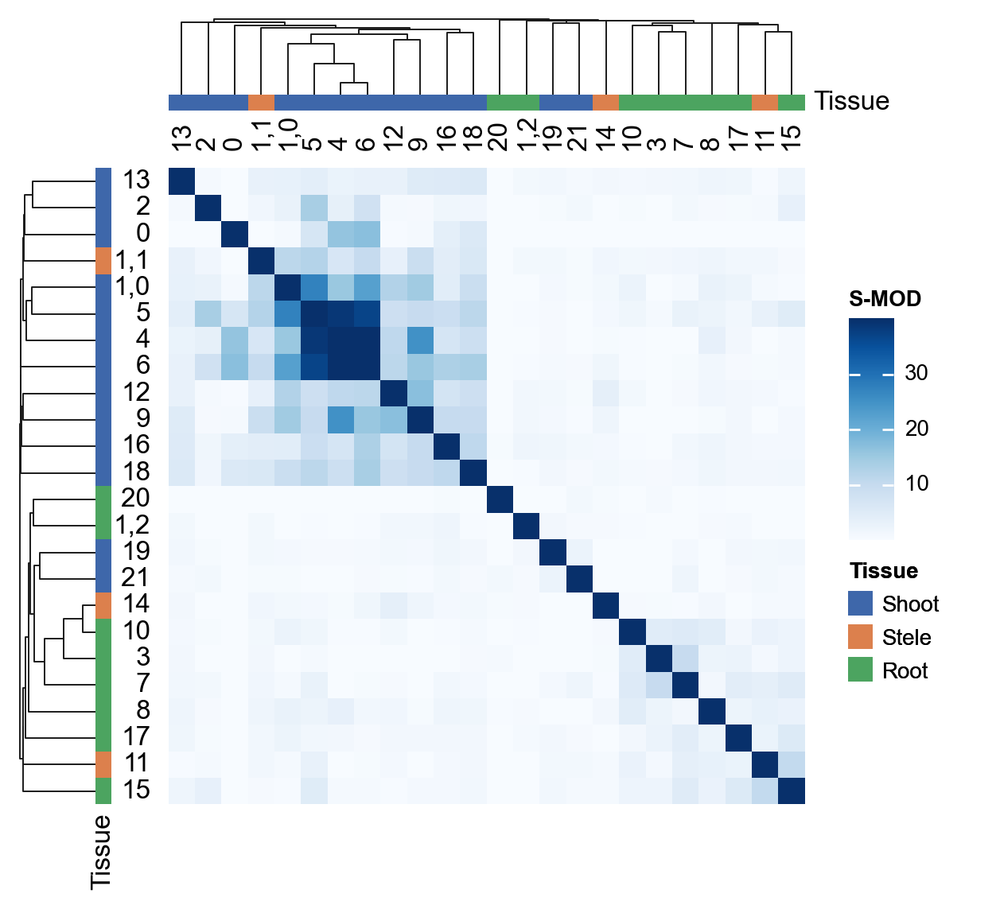

In [79]:
h = go_jtk.tileplot(vmax=40, cmap='Blues', addCounts=False)
linkage = scipy.cluster.hierarchy.linkage(h._deform.get_data(), method='average')
h.add_left(
    mp.Colors(
        go_jtk.df_overlapInfo.pivot_table(index='comp1', columns='comp2', values='smod').index.map(dt_cluster2Tissue), 
        palette={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
        label='Tissue'
    ), size=0.1
)

h.add_top(
    mp.Colors(
        go_jtk.df_overlapInfo.pivot_table(index='comp1', columns='comp2', values='smod').index.map(dt_cluster2Tissue), 
        palette={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
        label='Tissue'
    ), size=0.1, legend=False
)

h.add_dendrogram('left', linkage=linkage)
h.add_dendrogram('top', linkage=linkage)
h.render()

2023-11-22 21:48:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-11-22 21:48:26 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


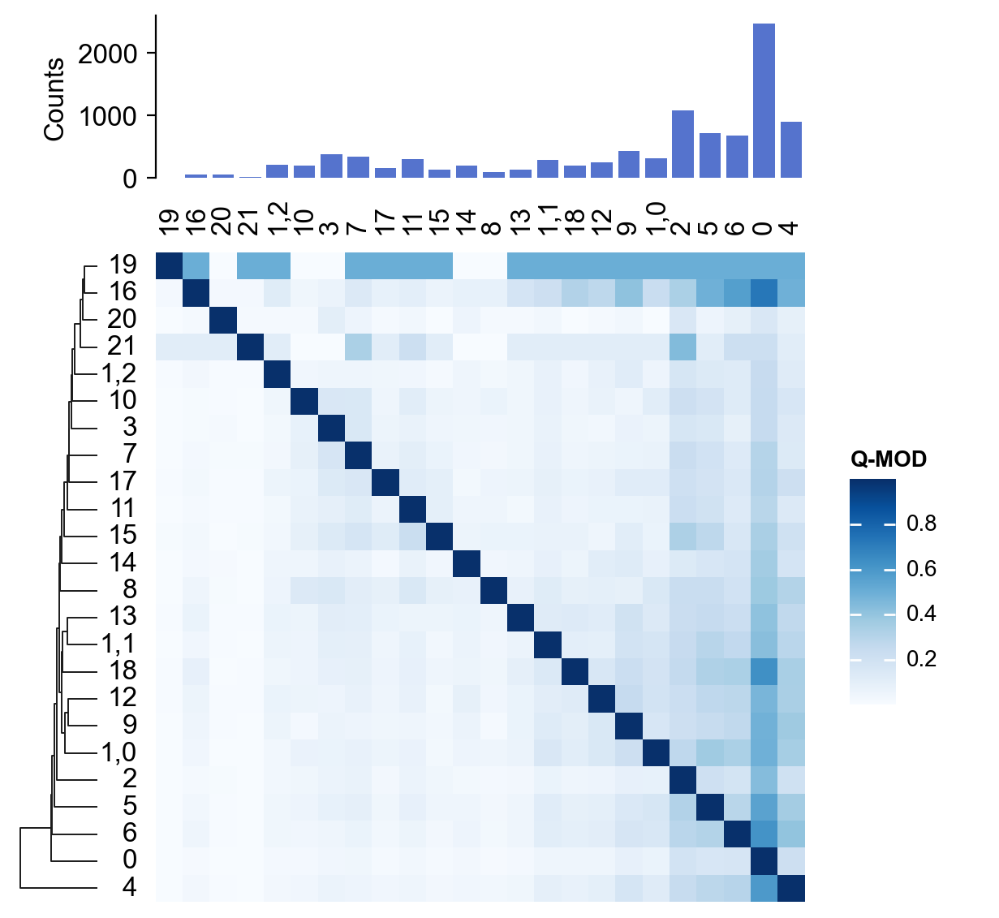

In [56]:
h = go_jtk.tileplot(colorKey='qmod', clusterKey='qmod',vmax=1, cmap='Blues', barColor='royalblue', label='Q-MOD')
linkage = scipy.cluster.hierarchy.linkage(h._deform.get_data(), method='average')
h.add_dendrogram('left', linkage=linkage)
h.add_dendrogram('top', linkage=linkage, add_meta=False, add_base=False)
h.render()

In [286]:
class GeneOverlapCircadian(GeneOverlapBase):
    def getDiffPhaseGenes(self, ls_cluster1, ls_cluster2):
        from itertools import product
        def _getDiffPhaseGenes(self, cluster1, cluster2):
            _ls = [cluster1, cluster2]
            df_diff = self.df.query("Cluster in @_ls").pivot_table(["OrgPhase", "StdPhase"], 'Gene', 'Cluster').dropna()
            df_diff = df_diff.rename(columns={cluster1: '1', cluster2: '2'})
            df_diff.columns = ['_'.join(x) for x in df_diff.columns.ravel()]

            df_diff = df_diff.assign(
                diff = lambda _: (_[f"OrgPhase_1"] - _[f"OrgPhase_2"]).abs(),
                diff_std = lambda _: (_[f"StdPhase_1"]**2 + _[f"StdPhase_2"]**2)**0.5
            ).assign(
                diff = lambda _: np.where(_['diff']<12, _['diff'], 24-_['diff'])
            ).assign(
                zscore  = lambda _: _['diff'] / _['diff_std']
            ).assign(
                pdiff = lambda _: (1-scipy.stats.norm.cdf(_['zscore'])) * 2
            ).assign(cluster1 = cluster1, cluster2 = cluster2)
            return df_diff
        
        if isinstance(ls_cluster1, str):
            ls_cluster1 = [ls_cluster1]
        if isinstance(ls_cluster2, str):
            ls_cluster2 = [ls_cluster2]

        _ls = []
        for cluster1, cluster2 in product(ls_cluster1, ls_cluster2):
            if cluster1 == cluster2:
                continue
            _ls.append(_getDiffPhaseGenes(self, cluster1, cluster2))
        df_diff = pd.concat(_ls)
        return df_diff

    def plotDiffPhaseGenes(self, ls_cluster1, ls_cluster2, figsize=(10, 10), **kwargs):
        df_diff = self.getDiffPhaseGenes(ls_cluster1, ls_cluster2)
        p = (
            so.Plot(df_diff.query("pdiff <= 0.05").reset_index(), x=f'OrgPhase_1', y=f'OrgPhase_2')
            .facet(row='cluster1', col='cluster2', order=dict(col=ls_cluster2, row=ls_cluster1))
            .add(so.Dot())
            .add(Axline(linestyle='--', color='black'), x=None, y=None, data={})
            .scale(x=so.Continuous().tick(every=4), y=so.Continuous().tick(every=4))
            .layout(size=figsize)
        )
        pp = p.plot()
        pp._repr_png_()
        fig = pp._figure
        for ax in fig.axes:
            title = ax.get_title()
            y, x = title.split('|')
            x = x.strip()
            y = y.strip()
            ax.set_xlabel(f"Cluster {x}")
            ax.set_ylabel(f"Cluster {y}")
            ax.axes.get_xaxis().label.set_visible(True)
            ax.axes.get_yaxis().label.set_visible(True)
        return p, fig

In [287]:
go_jtk.getDiffPhaseGenes = MethodType(GeneOverlapCircadian.getDiffPhaseGenes, go_jtk)
go_jtk.plotDiffPhaseGenes = MethodType(GeneOverlapCircadian.plotDiffPhaseGenes, go_jtk)


In [ ]:
['5', '4', '6', '1,1', '1,0', '12', '9', '0', '13', '16', '18']

In [293]:
go_jtk.df.query("Cluster in ['5', '4']").query("AdjP < 0.05")

,Gene,Cluster,Lag,Amp,Phase,OrgPhase,StdPhase,Bhq,AdjP,IsCircadian
6,AT1G01060,4,22.0,3.264955,22.0,21.434409,0.288637,0.063335,0.000196,True
7,AT1G01060,5,0.0,3.338056,22.0,22.899676,0.360953,0.038354,0.000064,True
30,AT1G01220,4,6.0,0.528924,4.0,4.701456,0.843052,0.596075,0.038180,True
126,AT1G01520,4,22.0,1.689075,22.0,21.656952,0.646231,0.333232,0.011694,True
127,AT1G01520,5,23.0,1.945325,22.0,22.490563,0.521766,0.099894,0.000530,True
...,...,...,...,...,...,...,...,...,...,...
100735,AT5G65920,5,2.0,0.641213,0.0,0.067195,1.004534,0.740897,0.038180,True
100759,AT5G66380,5,7.0,0.804054,6.0,5.744838,1.203366,0.562587,0.021639,True
100783,AT5G67110,5,4.0,0.703672,2.0,2.562723,0.983813,0.154909,0.001289,True
100807,AT5G67280,5,5.0,0.687014,4.0,4.229967,0.742741,0.419708,0.011694,True


In [299]:
go_jtk.df_overlapInfo.query("comp1 == '0' & comp2 == '4'")

,comp1,comp2,N,m,n1,n2,smod,jaccard,qmod
6,0,4,5296,532,2468,900,15.991628,0.187588,0.215559


In [301]:
go_jtk.getDiffPhaseGenes("0", "4").query("pdiff < 0.05")

,OrgPhase_1,OrgPhase_2,StdPhase_1,StdPhase_2,diff,diff_std,zscore,pdiff,cluster1,cluster2
Gene,,,,,,,,,,
AT1G01220,7.665633,4.701456,1.013252,0.843052,2.964177,1.318111,2.248807,2.452475e-02,0,4
AT1G01820,9.381042,6.311295,0.569265,0.857242,3.069747,1.029042,2.983111,2.853342e-03,0,4
AT1G05870,21.329605,19.970769,0.522192,0.381174,1.358836,0.646512,2.101796,3.557115e-02,0,4
AT1G10200,8.707199,12.866231,0.599381,0.927257,4.159032,1.104112,3.766858,1.653149e-04,0,4
AT1G21080,20.053046,15.642496,1.265893,1.062288,4.410551,1.652556,2.668926,7.609412e-03,0,4
...,...,...,...,...,...,...,...,...,...,...
AT5G46580,6.776738,2.540366,1.009411,1.210166,4.236372,1.575885,2.688249,7.182782e-03,0,4
AT5G47455,9.119568,5.130944,0.663227,0.691703,3.988624,0.958292,4.162221,3.151675e-05,0,4
AT5G48150,19.439674,14.025294,0.658848,0.808252,5.414380,1.042761,5.192349,2.076578e-07,0,4


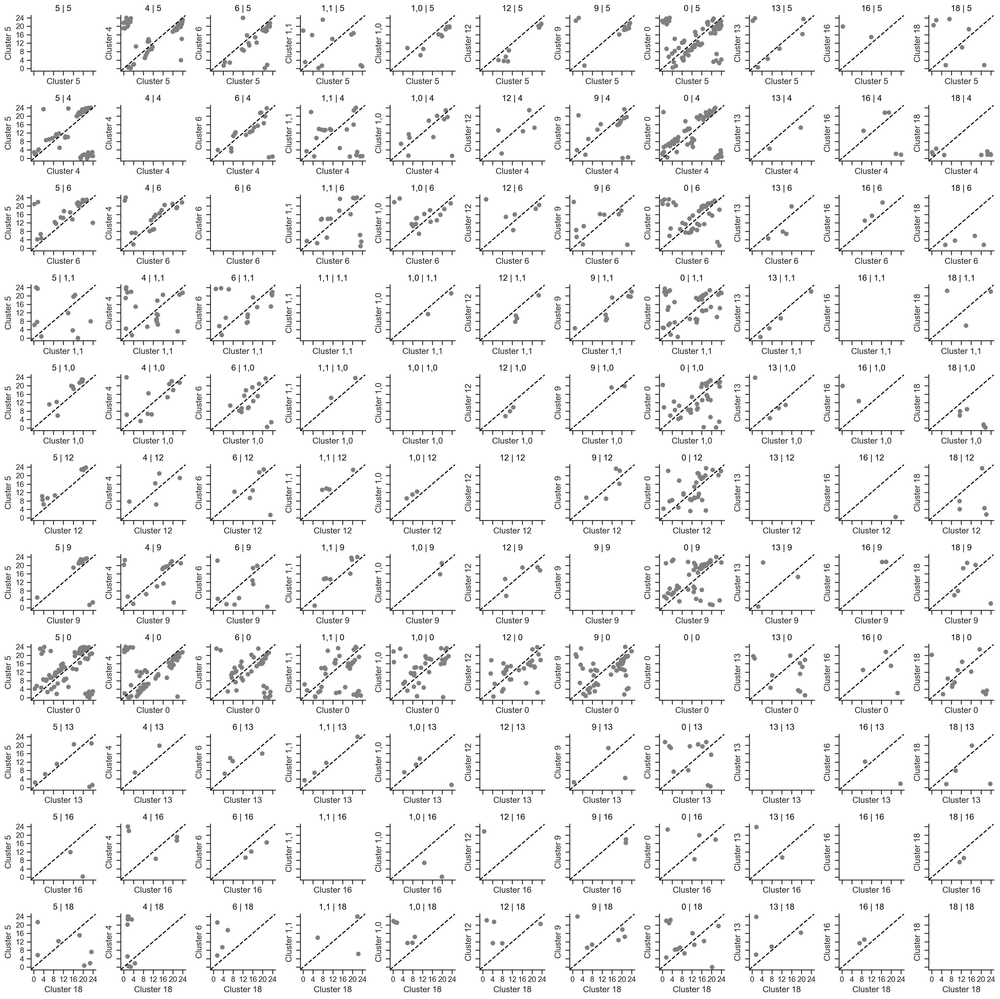

In [289]:
p, fig = go_jtk.plotDiffPhaseGenes(['5', '4', '6', '1,1', '1,0', '12', '9', '0', '13', '16', '18'], ['5', '4', '6', '1,1', '1,0', '12', '9', '0', '13', '16', '18'], figsize=(20, 20))
fig

In [235]:
df_diff = go_jtk.df.query("Cluster in @_ls").pivot_table(["OrgPhase", "StdPhase"], 'Gene', 'Cluster').dropna()
df_diff = df_diff.rename(columns={cluster1: '1', cluster2: '2'})
df_diff.columns = ['_'.join(x) for x in df_diff.columns.ravel()]

In [236]:

df_diff = df_diff.assign(
    diff = lambda _: (_[f"OrgPhase_1"] - _[f"OrgPhase_2"]).abs(),
    diff_std = lambda _: (_[f"StdPhase_1"]**2 + _[f"StdPhase_2"]**2)**0.5
).assign(
    diff = lambda _: np.where(_['diff']<12, _['diff'], 24-_['diff'])
).assign(
    zscore  = lambda _: _['diff'] / _['diff_std']
).assign(
    pdiff = lambda _: (1-scipy.stats.norm.cdf(_['zscore'])) * 2
).assign(cluster1 = cluster1, cluster2 = cluster2)

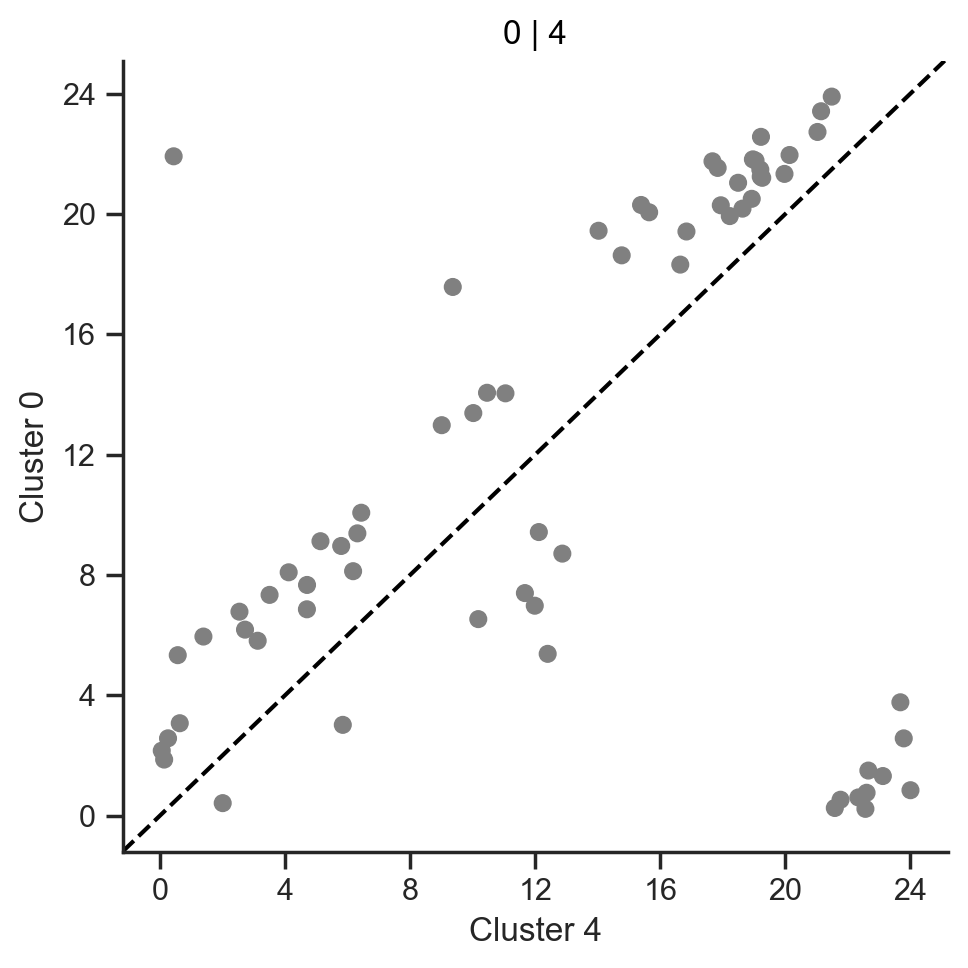

In [245]:
p = (
    so.Plot(df_diff.query("pdiff <= 0.05"), x=f'OrgPhase_1', y=f'OrgPhase_2')
    .facet(row='cluster1', col='cluster2')
    .add(so.Dot())
    .add(Axline(linestyle='--', color='black'), x=None, y=None, data={})
    .scale(x=so.Continuous().tick(every=4), y=so.Continuous().tick(every=4))
    .layout(size=(5,5))
)
pp = p.plot()
pp._repr_png_()
fig = pp._figure
for ax in fig.axes:
    title = ax.get_title()
    y, x = title.split('|')
    x = x.strip()
    y = y.strip()
    ax.set_xlabel(f"Cluster {x}")
    ax.set_ylabel(f"Cluster {y}")
fig

In [239]:
df_diff.query("pdiff <= 0.05")

,OrgPhase_2,OrgPhase_1,StdPhase_2,StdPhase_1,diff,diff_std,zscore,pdiff,cluster1,cluster2
Gene,,,,,,,,,,
AT1G01220,7.665633,4.701456,1.013252,0.843052,2.964177,1.318111,2.248807,2.452475e-02,4,0
AT1G01820,9.381042,6.311295,0.569265,0.857242,3.069747,1.029042,2.983111,2.853342e-03,4,0
AT1G05870,21.329605,19.970769,0.522192,0.381174,1.358836,0.646512,2.101796,3.557115e-02,4,0
AT1G10200,8.707199,12.866231,0.599381,0.927257,4.159032,1.104112,3.766858,1.653149e-04,4,0
AT1G21080,20.053046,15.642496,1.265893,1.062288,4.410551,1.652556,2.668926,7.609412e-03,4,0
...,...,...,...,...,...,...,...,...,...,...
AT5G46580,6.776738,2.540366,1.009411,1.210166,4.236372,1.575885,2.688249,7.182782e-03,4,0
AT5G47455,9.119568,5.130944,0.663227,0.691703,3.988624,0.958292,4.162221,3.151675e-05,4,0
AT5G48150,19.439674,14.025294,0.658848,0.808252,5.414380,1.042761,5.192349,2.076578e-07,4,0


Cluster,0,"1,1"
Gene,,
AT1G01060,21.331633,23.970987
AT1G01540,22.660756,19.261211
AT1G04620,11.608479,9.976590
AT1G06040,2.341543,2.383106
AT1G07010,21.227532,23.840049
...,...,...
AT5G61380,11.898552,12.184315
AT5G62720,8.776921,14.127985
AT5G64170,1.792188,2.771244


In [ ]:
0, 1,1

In [147]:
go_jtk.df

,Gene,Cluster,Lag,Amp,Phase,OrgPhase,StdPhase,Bhq,AdjP,IsCircadian
0,AT1G01060,0,22.0,4.364806,22.0,21.331633,0.332851,0.017429,0.000530,True
1,AT1G01060,"1,0",0.0,2.822068,22.0,22.741763,0.519526,0.185763,0.000196,True
2,AT1G01060,"1,1",1.0,2.193058,0.0,23.970987,0.720402,0.766520,0.000530,True
3,AT1G01060,"1,2",NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,AT1G01060,2,23.0,3.931844,22.0,22.659124,0.394992,0.064605,0.000530,True
...,...,...,...,...,...,...,...,...,...,...
127099,AT4G13940,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127100,AT4G13940,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127101,AT4G13940,19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127102,AT4G13940,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


In [145]:
go_jtk.df

,Gene,Cluster,Lag,Amp,Phase,OrgPhase,StdPhase,Bhq,AdjP,IsCircadian
0,AT1G01060,0,22.0,4.364806,22.0,21.331633,0.332851,0.017429,0.000530,True
1,AT1G01060,"1,0",0.0,2.822068,22.0,22.741763,0.519526,0.185763,0.000196,True
2,AT1G01060,"1,1",1.0,2.193058,0.0,23.970987,0.720402,0.766520,0.000530,True
3,AT1G01060,"1,2",NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
4,AT1G01060,2,23.0,3.931844,22.0,22.659124,0.394992,0.064605,0.000530,True
...,...,...,...,...,...,...,...,...,...,...
127099,AT4G13940,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127100,AT4G13940,18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127101,AT4G13940,19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False
127102,AT4G13940,20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False


# AMP compare

In [290]:
import re
dt_cluster2Tissue = {x: re.findall(r"\(([\w\W]+)\)", y)[0] for x,y in dt_anno.items()}

In [291]:
dt_cluster2Tissue = {x:y if y != 'Unknown' else "Stele" for x,y in dt_cluster2Tissue.items()}

In [292]:
df_jtkCpmCoreGene = df_jtkCpm.query("CycID.isin(@dt_plotGenes.values())")
df_jtkCpmCoreGene = df_jtkCpmCoreGene.assign(
        minPhase = lambda _: _.orgPhase - _.stdPhase, 
        maxPhase = lambda _: _.orgPhase + _.stdPhase, 
        CycID=lambda _: _.CycID.map(dt_coreGene), 
        minAmp = lambda _: _.orgAmpli - _.stdAmpli,
        maxAmp = lambda _: _.orgAmpli + _.stdAmpli,
        tissue=lambda _: _.cluster.map(dt_cluster2Tissue)
    ).reset_index()

In [293]:
df_jtkCpmCoreGene['groups'] = ''

In [294]:
import scipy
def getJtkDiff(df_orgJtk, ls_pubCircadianGenes):
    df_orgJtkForDiff = df_orgJtk.pivot_table(index='CycID', columns='cluster', values=['orgAmpli', 'stdAmpli', 'ADJ.P', 'AMP'])
    def _getDiff(celltype1, celltype2):
        df_jtkDiff = pd.DataFrame(index=df_orgJtkForDiff.index)
        df_jtkDiff['celltype1'] = celltype1
        df_jtkDiff['celltype2'] = celltype2
        df_jtkDiff['amp1'] = df_orgJtkForDiff['orgAmpli'][celltype1]
        df_jtkDiff['amp2'] = df_orgJtkForDiff['orgAmpli'][celltype2]
        df_jtkDiff['std1'] = df_orgJtkForDiff['stdAmpli'][celltype1]
        df_jtkDiff['std2'] = df_orgJtkForDiff['stdAmpli'][celltype2]
        df_jtkDiff['pvalue1'] = df_orgJtkForDiff['ADJ.P'][celltype1]
        df_jtkDiff['pvalue2'] = df_orgJtkForDiff['ADJ.P'][celltype2]

        df_jtkDiff.dropna(subset=['amp1', 'amp2', 'std1', 'std2'], inplace=True)

        df_jtkDiff['diff'] = (df_jtkDiff['amp1'] - df_jtkDiff['amp2']).abs()
        df_jtkDiff['diff'] = np.where(df_jtkDiff['diff'] < 12, df_jtkDiff['diff'], 24-df_jtkDiff['diff'])
        df_jtkDiff['diff_std'] = (df_jtkDiff['std1']**2 + df_jtkDiff['std2']**2)**0.5
        df_jtkDiff['zscore'] = df_jtkDiff['diff'] / df_jtkDiff['diff_std']
        df_jtkDiff['pdiff'] = (1 - scipy.stats.norm.cdf(df_jtkDiff['zscore'])) * 2
        df_jtkDiff['bulk'] = df_jtkDiff.index.isin(ls_pubCircadianGenes)
        return df_jtkDiff
    return _getDiff

In [295]:
df_jtkCpmRaw

,CycID,BH.Q,ADJ.P,PER,LAG,AMP,celltype,idxMax,phase,orgPhase,stdPhase,orgAmpli,stdAmpli,orgBase,stdBase,cluster
1,AT1G01010,0.503996,0.165249,24.0,17.0,0.610370,0,42,18,17.196291,1.469477,0.910064,0.350109,2.408522,0.247565,0
2,AT1G01020,0.276139,0.064564,24.0,3.0,0.182425,0,24,2,2.030677,1.094005,0.271154,0.077661,6.042417,0.054915,0
3,AT1G01030,0.144430,0.021639,24.0,2.0,0.546171,0,26,0,0.664587,1.004117,0.745856,0.196068,6.228289,0.138641,0
4,AT1G01040,0.663390,0.251764,24.0,2.0,0.183981,0,30,2,1.327044,1.396896,0.200359,0.073272,7.858951,0.051811,0
5,AT1G01050,0.376885,0.105093,24.0,17.0,0.289637,0,42,18,17.483223,1.112334,0.362252,0.105491,6.155100,0.074593,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
845,AT5G66558,1.000000,1.000000,24.0,22.0,1.089883,21,34,0,23.255951,7.347098,0.745963,1.434835,6.543134,1.014581,21
846,AT5G66760,1.000000,0.208507,24.0,18.0,0.298834,21,42,18,17.176863,1.552767,2.365397,0.961565,5.854617,0.679929,21
847,AT5G66930,1.000000,1.000000,24.0,14.0,0.644647,21,40,18,17.515082,3.122274,1.182951,0.966956,6.996793,0.683741,21
848,AT5G67320,1.000000,1.000000,24.0,20.0,0.233221,21,24,22,22.103970,2.831943,0.298215,0.221097,8.379979,0.156339,21


In [296]:
from itertools import combinations
for gene in ls_coreGenes:
    _df = df_jtkCpmRaw.query("CycID == @gene & `ADJ.P` < 0.05")
    _fc = getJtkDiff(_df, ls_pubCircadianGenes)
    if _df.empty | _df.shape[0] == 1:
        continue
    df_jtkDIffPvalue = pd.DataFrame(combinations(_df['cluster'].unique(), 2), columns=['row', 'col'])
    df_jtkDIffPvalue = df_jtkDIffPvalue.assign(pdiff=df_jtkDIffPvalue.apply(lambda _: _fc(_['row'], _['col'])['pdiff'].iat[0], axis=1)).rename(columns={'pdiff': 'p-adj'})
    from jpy_tools import otherTools
    _dt = otherTools.cld(df_jtkDIffPvalue, 0.1, _df.sort_values('orgAmpli')['cluster'].to_list())
    df_jtkCpmCoreGene.loc[df_jtkCpmCoreGene['CycID'] == dt_coreGene[gene], 'groups'] = df_jtkCpmCoreGene.loc[df_jtkCpmCoreGene['CycID'] == dt_coreGene[gene], 'cluster'].map(_dt)

In [297]:
from jpy_tools.soExt import Box

In [304]:
df_jtkCpmCoreGene['CycID'] = df_jtkCpmCoreGene['CycID'].astype('category').cat.set_categories(ls_symOrder).cat.remove_unused_categories()

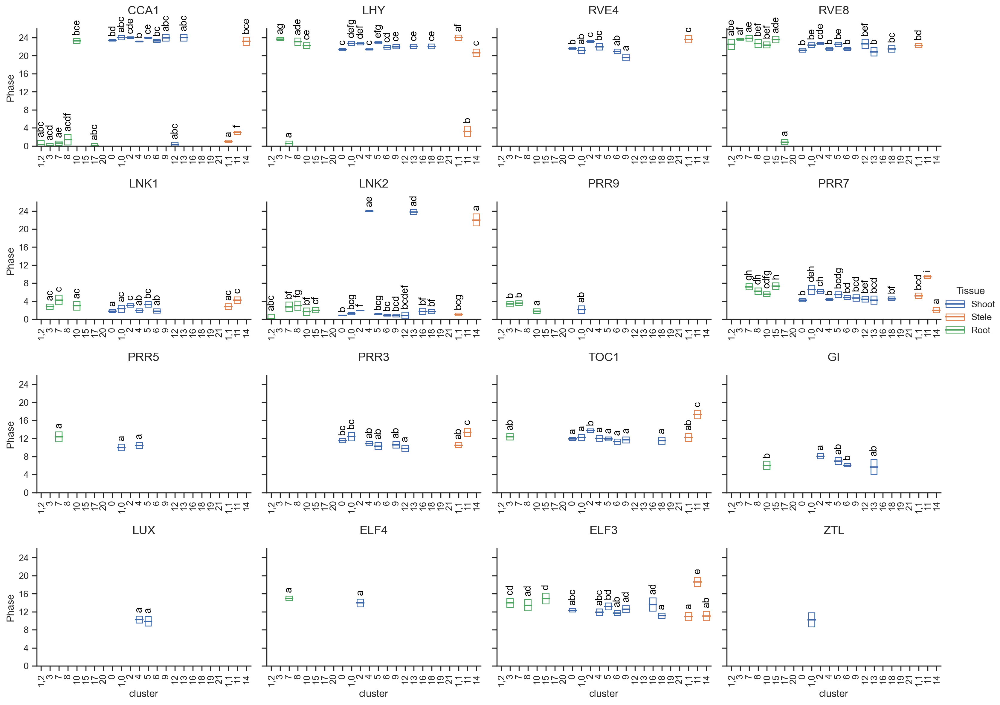

In [ ]:
g = (
    so.Plot(df_jtkCpmCoreGene, x='cluster', color='tissue', text='groups')
    .facet(col='CycID', wrap=4)
    .add(Box(fill=False), ymin='minPhase', ymax='maxPhase')
    .add(so.Dash(), y='orgPhase')
    .add(so.Text(valign='bottom', color='black'), y='maxPhase')
    .layout(size=(16,12))
    .scale(
        x=so.Nominal(order=sorted(dt_cluster2Tissue, key=lambda _: dt_cluster2Tissue[_])),
        y=so.Continuous().tick(every=4, between=(0, 24)),
        color={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
    )
    .limit(y=(0, 26))
    .theme(dt_snsStyle)
    .label(y='Phase', color='Tissue')
    .plot()
)
g._repr_png_()
fig = g._figure
for ax in fig.axes:
    ax.tick_params(labelbottom=True)
    ax.texts >> F(map, lambda _: _.set(rotation=90, clip_on=False)) >> F(list)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.set_title(ax.get_title(), y=1.08)
fig

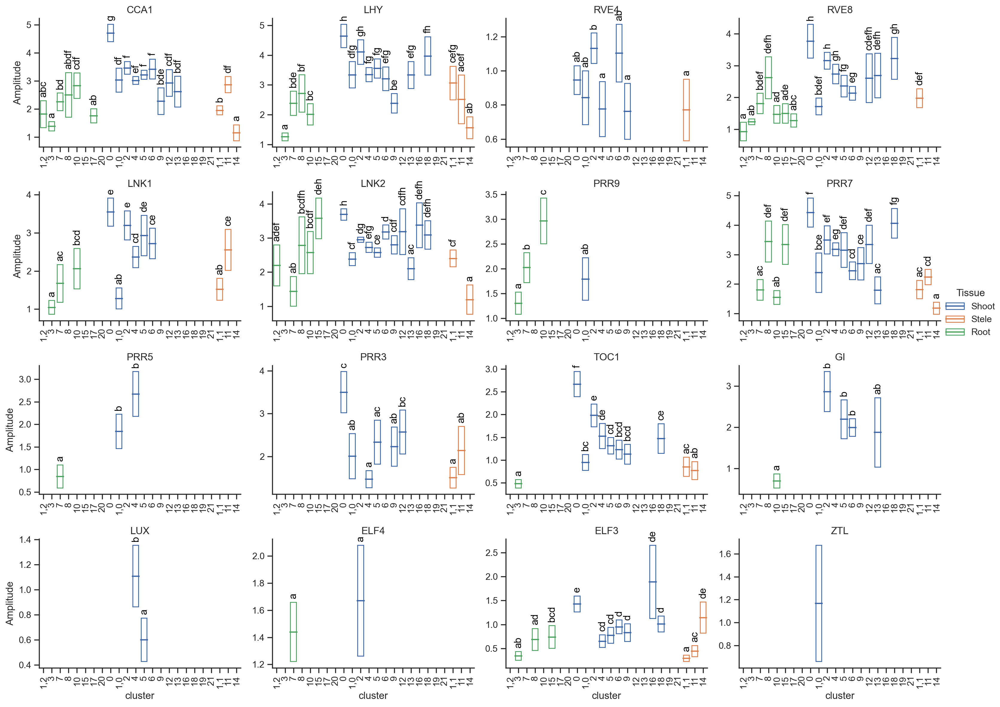

In [305]:
g = (
    so.Plot(df_jtkCpmCoreGene, x='cluster', color='tissue', text='groups')
    .facet(col='CycID', wrap=4)
    .share(y=False)
    .add(Box(fill=False), ymin='minAmp', ymax='maxAmp')
    .add(so.Dash(), y='orgAmpli')
    .add(so.Text(valign='bottom', color='black'), y='maxAmp')
    .layout(size=(16,12))
    .scale(
        x=so.Nominal(order=sorted(dt_cluster2Tissue, key=lambda _: dt_cluster2Tissue[_])),
        color={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
    )
    .theme(dt_snsStyle)
    .label(y='Amplitude', color='Tissue')
    .plot()
)
g._repr_png_()
fig = g._figure
for ax in fig.axes:
    ax.tick_params(labelbottom=True)
    ax.texts >> F(map, lambda _: _.set(rotation=90)) >> F(list)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.texts >> F(map, lambda _: _.set(clip_on=False)) >> F(list)
fig

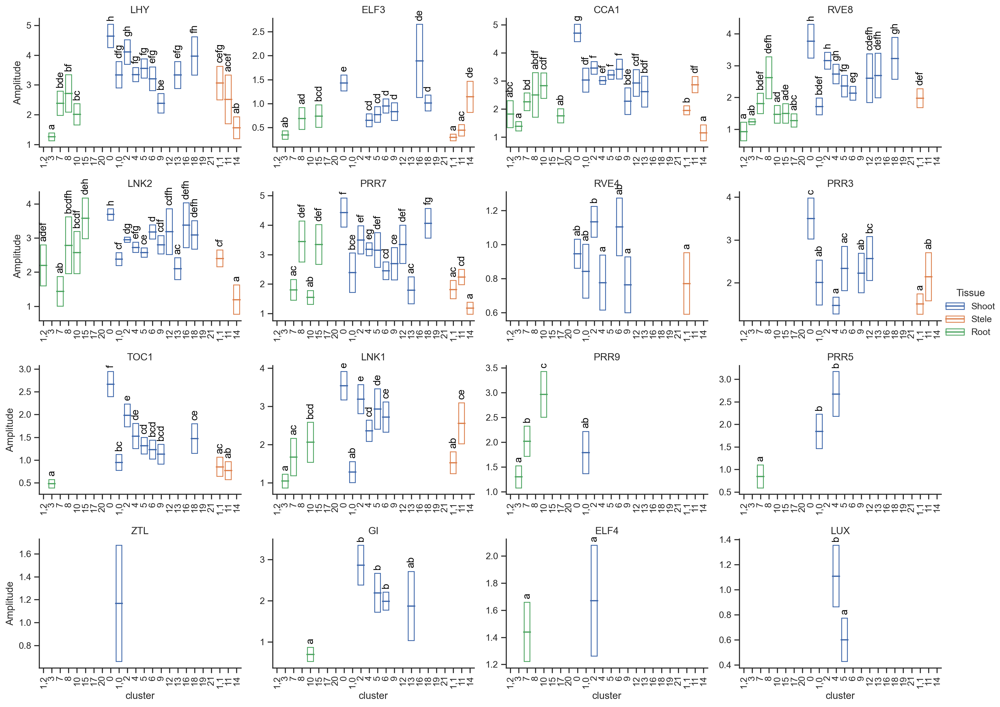

In [298]:
g = (
    so.Plot(df_jtkCpmCoreGene, x='cluster', color='tissue', text='groups')
    .facet(col='CycID', wrap=4)
    .share(y=False)
    .add(Box(fill=False), ymin='minAmp', ymax='maxAmp')
    .add(so.Dash(), y='orgAmpli')
    .add(so.Text(valign='bottom', color='black'), y='maxAmp')
    .layout(size=(16,12))
    .scale(
        x=so.Nominal(order=sorted(dt_cluster2Tissue, key=lambda _: dt_cluster2Tissue[_])),
        color={'Shoot':"#3e67aa", 'Stele':"#dc804d", 'Root':"#4ca460"},
    )
    .theme(dt_snsStyle)
    .label(y='Amplitude', color='Tissue')
    .plot()
)
g._repr_png_()
fig = g._figure
for ax in fig.axes:
    ax.tick_params(labelbottom=True)
    ax.texts >> F(map, lambda _: _.set(rotation=90)) >> F(list)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.texts >> F(map, lambda _: _.set(clip_on=False)) >> F(list)
fig

In [318]:
ad.var.index.to_series().sample(n=100)

AT3G61880    AT3G61880
AT2G07687    AT2G07687
AT4G17243    AT4G17243
AT5G02605    AT5G02605
AT5G16715    AT5G16715
               ...    
AT3G58190    AT3G58190
AT3G13320    AT3G13320
AT2G37130    AT2G37130
AT1G04150    AT1G04150
AT1G54870    AT1G54870
Length: 100, dtype: object

# CDFs analysis

In [312]:
df_cdf = """AT1G22770	GI
AT1G68050	FKF1
AT5G62430	CDF1
AT5G39660	CDF2
AT3G47500	CDF3
AT2G34140	CDF4
AT1G69570	CDF5
AT1G26790	CDF6
AT1G69572	FLORE
AT5G15840	CO
AT1G65480	FT""".split('\n') >> F(map, lambda x: x.split('\t')) >> F(list) >> F(pd.DataFrame, columns=['CycID', 'name']) 
# AT1G65480 Not Found
# df_cdf = df_cdf.iloc[:-1, ]

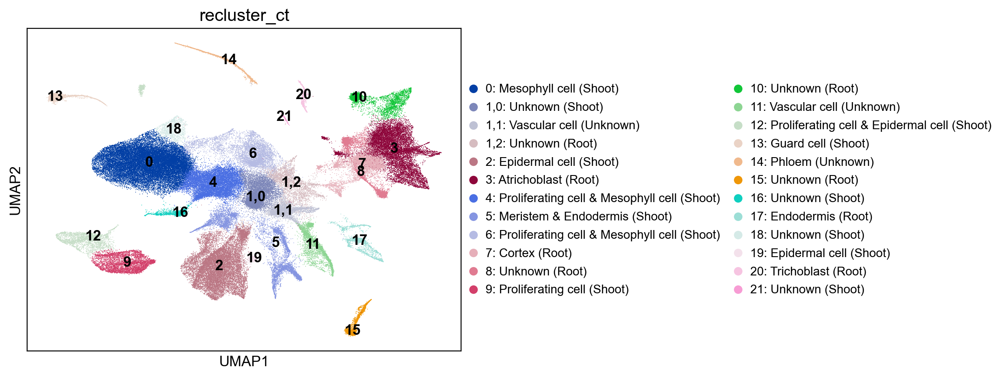

In [313]:
ax = sc.pl.umap(ad, color='leiden_subcluster', show=False, legend_loc='on data')
sc.pl.umap(ad, color='recluster_ct', ax=ax)

In [331]:
df_cdf

,CycID,name
0,AT1G22770,GI
1,AT1G68050,FKF1
2,AT5G62430,CDF1
3,AT5G39660,CDF2
4,AT3G47500,CDF3
5,AT2G34140,CDF4
6,AT1G69570,CDF5
7,AT1G26790,CDF6
8,AT1G69572,FLORE
9,AT5G15840,CO


In [ ]:
for _ad in singleCellTools.basic.splitAdata(ad_pub, 'tissue', copy=False):
    sc.pl.umap(_ad, color='celltype')
    sc.pl.umap(_ad, color=df_cdf['CycID'], title=df_cdf['name'], ncols=4, layer='normalize_log', cmap='Reds')

In [315]:
singleCellTools.geneEnrichInfo.getAUCellScore(ad, {'cdf': df_cdf['CycID']}, label='AUCell_cdf', chunksize=20000, layer='raw')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 7/7 [14:41<00:00, 125.88s/it]


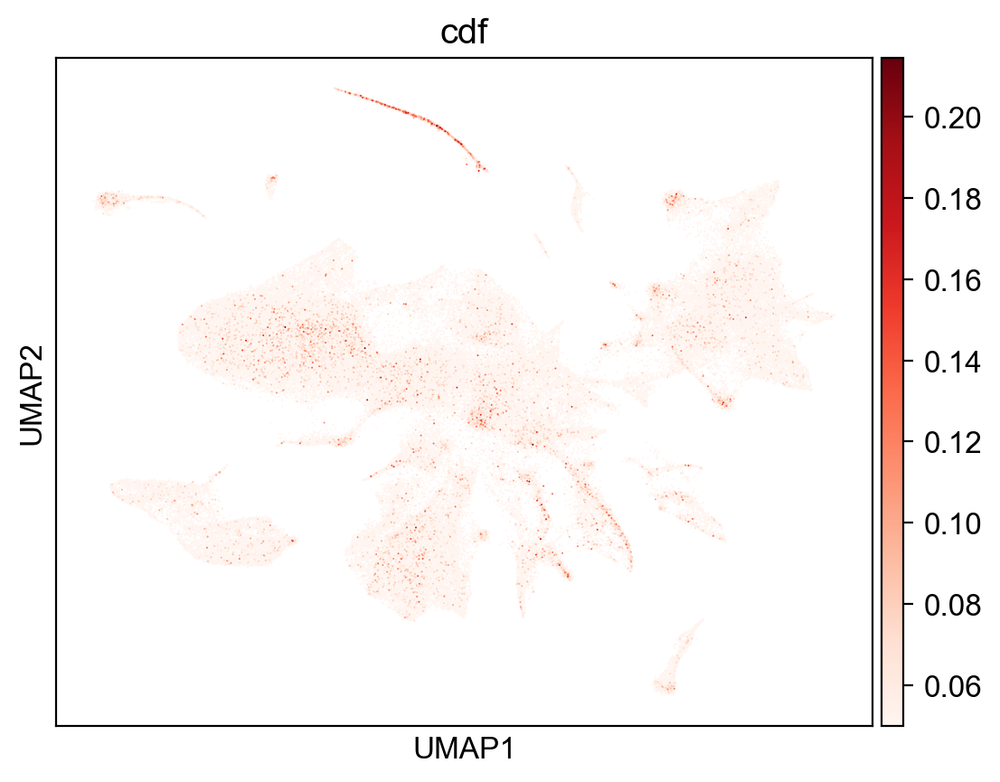

In [318]:
sc.pl.umap(singleCellTools.plotting.obsmToObs(ad, 'AUCell_cdf'), color='cdf', cmap='Reds', vmin=0.05, size=2)

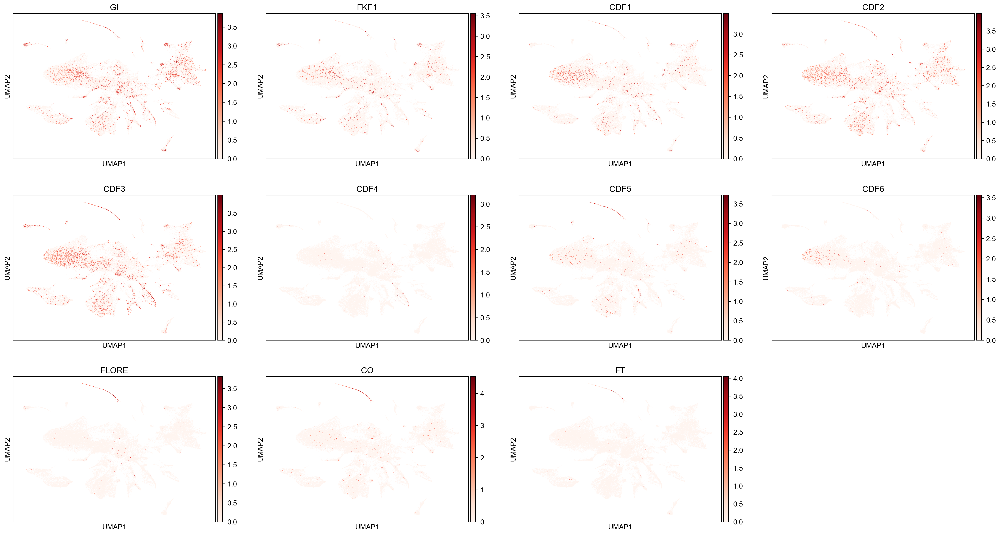

In [319]:
import scanpy as sc

sc.pl.umap(ad, color=df_cdf['CycID'], title=df_cdf['name'], ncols=4, layer='normalize_log', cmap='Reds')

In [143]:
ad_c14Agg = singleCellTools.geneEnrichInfo._mergeData(ad[ad.obs.eval("leiden_subcluster == '14'")],  'CT')

In [146]:
singleCellTools.basic.initLayer(ad_c14Agg, total=1e6, logbase=2)

In [186]:
importlib.reload(utils)

<module 'utils' from '/public/home/liuzj/notebooks/circadian/20221122/soupX/utils.py'>

<Figure size 640x480 with 0 Axes>

In [320]:
from jpy_tools import otherTools

In [321]:

ls_fig = []
for gene, name in zip(df_cdf['CycID'], df_cdf['name']):
    h = utils.heatmapSingleGeneMultiCluster(ad_merge, 'normalize_log', gene, '', 'Cluster', 'Min-max scaled log2 CPM', 'bottom', 'cluster', scale=True, cmap='Blues', cbar_kws=dict(orientation="horizontal", alignment="center"))
    h.add_dendrogram('left', method='ward', add_divider=False)
    ar_linkage = scipy.cluster.hierarchy.linkage(h.get_deform().data, method='ward', optimal_ordering=True)
    # h.add_dendrogram('left', linkage=ar_linkage, add_divider=False, name='dendro')
    _df = (
        ad_mergeAllCt[:, [gene]]
        .to_df("normalize_log")
        .join(ad_mergeAllCt.obs[["CT"]])
    )

    _df = _df.melt("CT", var_name="gene", value_name="CPM")
    _df["name"] = name


    h.add_top(
        utils.SoLineForMa(np.zeros((12, 12)), _df, f"Pseudo-bulk\n(log$_{2}$CPM)", gene, name), legend=False
    )

    h.add_legends(side="bottom")
    # fig = plt.figure(figsize=(3.3, 6))
    h.add_top(mp.Title(name, fontsize=16))
    plt.close()
    h.add_right(
    utils.SoMarkForJtkAnno(
            np.array([ad.obs['leiden_subcluster'].cat.categories,]), 
            'jtkAnno',df_jtkCpm.query("CycID == @gene")['cluster'].to_list(),
        ), size=0.3, name='jtkAnno'
    )
    h.render()
    h._legend_box.loc = 8
    # h.get_main_ax().invert_yaxis()
    h.get_ax('clusterLabel').invert_yaxis()
    # h.get_ax("dendro").invert_yaxis()
    # h.get_ax("jtkAnno").invert_yaxis()
    ls_fig.append(h.figure >> F(otherTools.FigConcate))
    plt.close()

2023-09-27 14:26:30 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:30 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:30 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:30 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 2.0, '2'), Text(0, 4.0, '4'), Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18'), Text(0, 20.0, '20')]


2023-09-27 14:26:32 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:32 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:32 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:32 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 11.0, '11'), Text(0, 12.0, '12'), Text(0, 13.0, '13'), Text(0, 14.0, '14'), Text(0, 15.0, '15'), Text(0, 16.0, '16'), Text(0, 17.0, '17'), Text(0, 18.0, '18'), Text(0, 19.0, '19'), Text(0, 20.0, '20'), Text(0, 21.0, '21')]


2023-09-27 14:26:35 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:35 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:35 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:35 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 16.0, '16'), Text(0, 17.0, '17'), Text(0, 18.0, '18'), Text(0, 19.0, '19'), Text(0, 20.0, '20'), Text(0, 21.0, '21'), Text(0, 22.0, '22'), Text(0, 23.0, '23')]


2023-09-27 14:26:37 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:37 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:37 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:37 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 4.0, '4'), Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18')]


2023-09-27 14:26:40 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:40 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:40 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:40 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 6.0, '6'), Text(0, 8.0, '8'), Text(0, 10.0, '10'), Text(0, 12.0, '12'), Text(0, 14.0, '14'), Text(0, 16.0, '16'), Text(0, 18.0, '18')]


2023-09-27 14:26:42 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:42 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:42 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:42 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]


2023-09-27 14:26:45 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:45 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:45 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:45 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 16.0, '16.00'), Text(0, 16.25, '16.25'), Text(0, 16.5, '16.50'), Text(0, 16.75, '16.75'), Text(0, 17.0, '17.00'), Text(0, 17.25, '17.25'), Text(0, 17.5, '17.50'), Text(0, 17.75, '17.75'), Text(0, 18.0, '18.00')]


2023-09-27 14:26:47 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:47 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:47 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:47 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]


2023-09-27 14:26:50 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:50 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:50 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:50 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]


2023-09-27 14:26:55 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:55 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:55 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:55 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]


2023-09-27 14:26:57 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:57 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:57 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2023-09-27 14:26:57 - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[Text(0, 0.0, '0.0'), Text(0, 0.2, '0.2'), Text(0, 0.4, '0.4'), Text(0, 0.6000000000000001, '0.6'), Text(0, 0.8, '0.8'), Text(0, 1.0, '1.0')]


In [322]:
from more_itertools import sliced

In [323]:
fig = sliced(ls_fig, 6) >> F(map, lambda x: reduce(lambda x, y: x | y, x)) >> F(list) >> F(lambda _: reduce(lambda x,y : x/y, _))

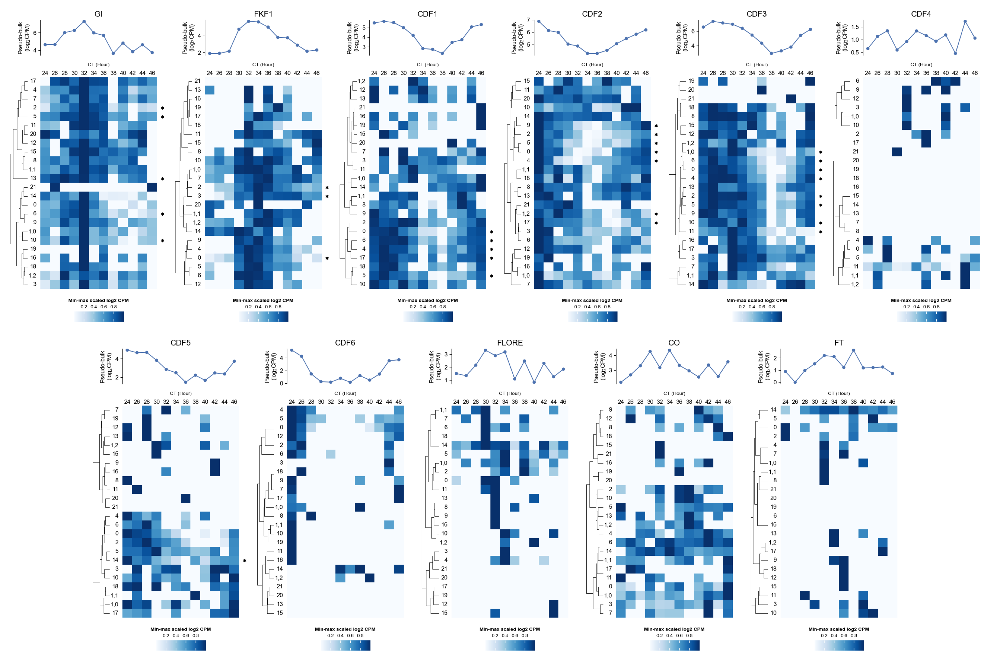

In [324]:
fig.show((20, 20))

In [325]:
_df = ad.obs[['leiden_subcluster']].assign(umap1=lambda _: ad.obsm['X_umap'][:, 0], umap2=lambda _: ad.obsm['X_umap'][:, 1])

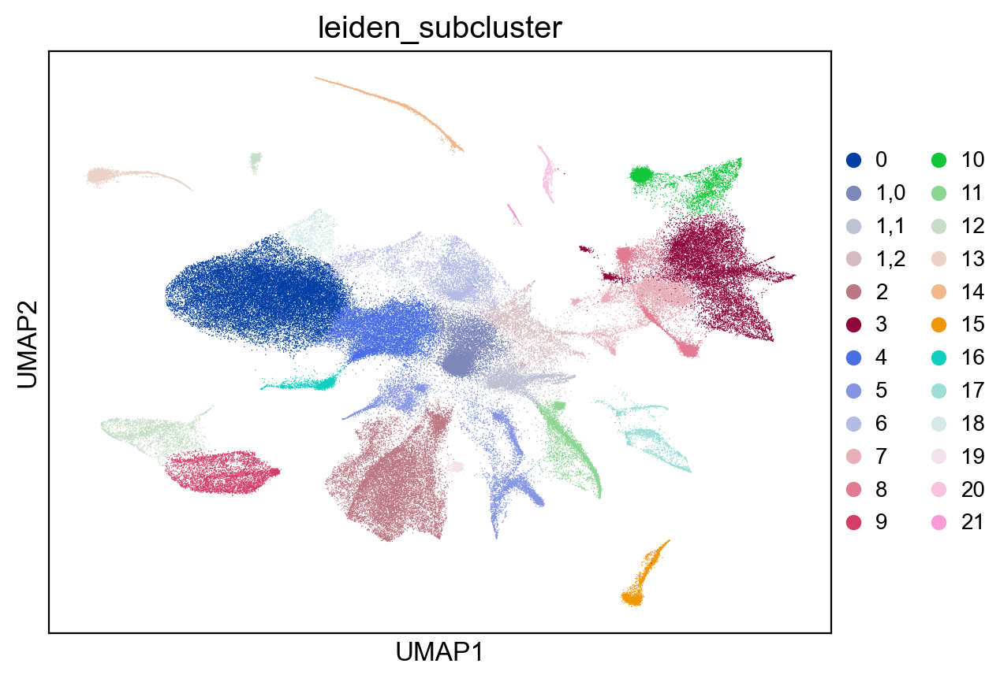

In [326]:
sc.pl.umap(ad, color='leiden_subcluster')

[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, -0.1, '−0.10'), Text(0, -0.05, '−0.05'), Text(0, 0.0, '0.00'), Text(0, 0.05000000000000002, '0.05'), Text(0, 0.1, '0.10')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]
[Text(0, 0.0, '0'), Text(0, 1.0, '1')]


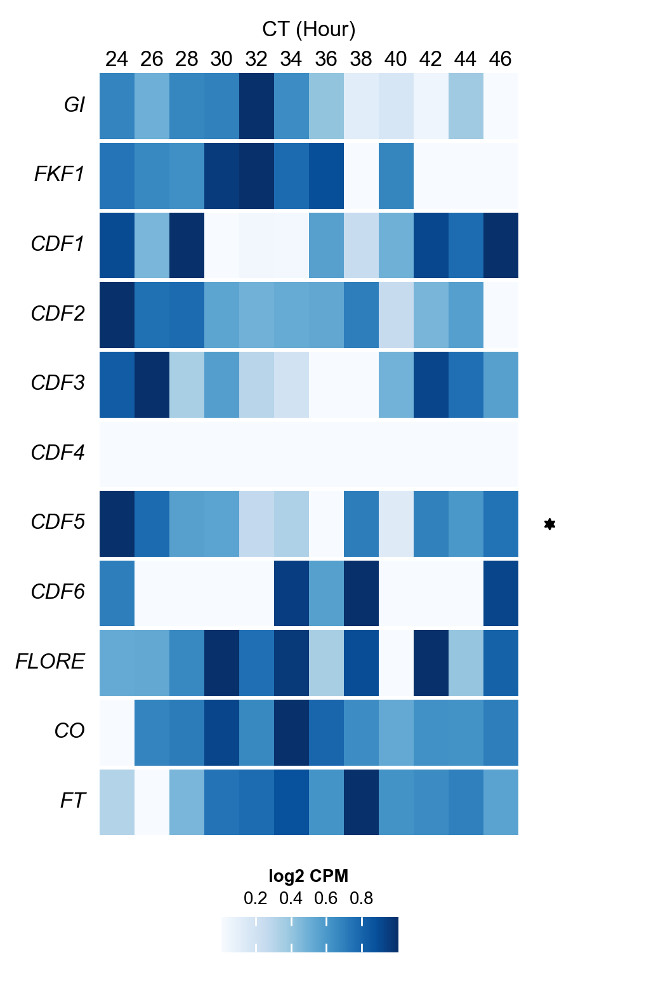

In [327]:
h = utils.heatmapMultiGeneInDifferentTime(
    ad_c14Agg, 'normalize_log', df_cdf['CycID'], df_cdf['name'], 'log2 CPM', cmap='Blues', scale=True, cbSide='bottom', cbar_kws=dict(orientation="horizontal", alignment="center")
)
plt.close()
h.add_right(
    utils.SoMarkForJtkAnno(
            np.array([df_cdf['CycID']]), 
            'jtkAnno',df_jtkCpm.query("CycID in @df_cdf.CycID & cluster == '14'")['CycID'].to_list(),
        ), pad=0.2, size=0.9, name='jtkAnno'
)
h.add_legends(side='bottom')
h.render()
h._legend_box.loc = 8

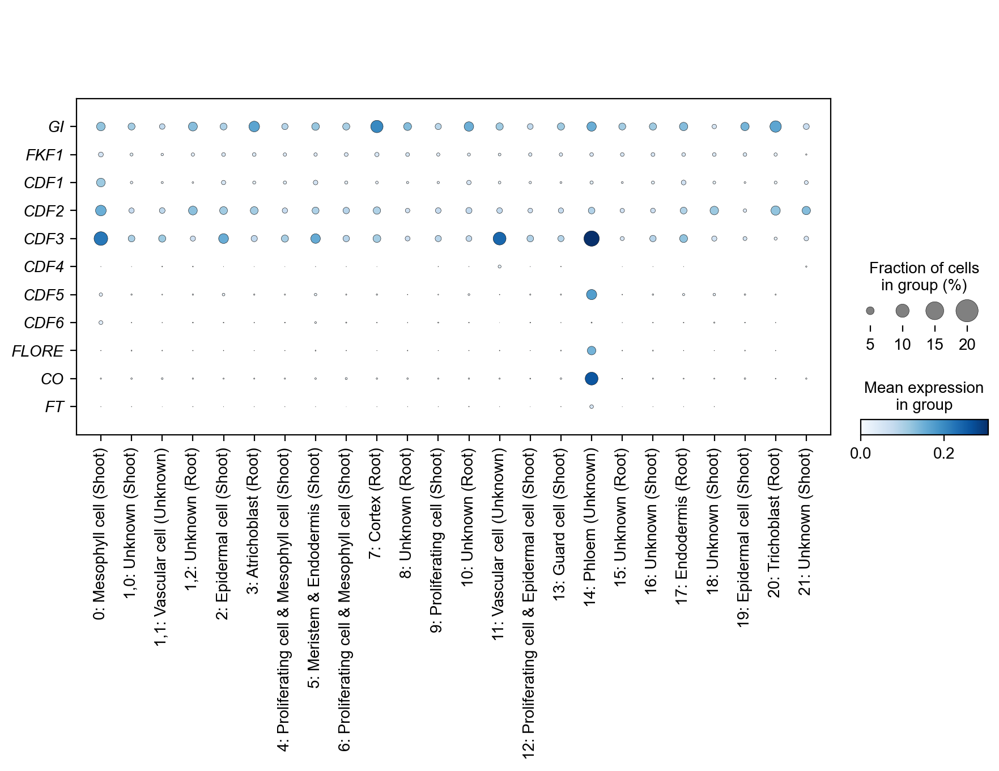

In [328]:
axs = sc.pl.dotplot(
    ad, df_cdf['CycID'], 'recluster_ct', layer='normalize_log', swap_axes=True, show=False, cmap='Blues'
)
ax = axs['mainplot_ax']
ax.set_yticklabels(df_cdf['name'], fontstyle='italic')
plt.show()

# fine tune pysenic

In [37]:
df = pd.read_feather("/data/Zhaijx/liuzj/data/Araport11/scenicUsed/cistarget_database/arab.motifs_vs_regions.scores.feather")

In [47]:
df.set_index("regions")

,AT1G01060,AT1G01250,AT1G01260,AT1G01720,AT1G02065,AT1G02230,AT1G02250,AT1G03800,AT1G03840,AT1G06070,...,AT5G65510,AT5G66300,AT5G66700,AT5G66730,AT5G66940,AT5G67000,AT5G67190,AT5G67300,AT5G67450,AT5G67580
regions,,,,,,,,,,,,,,,,,,,,,
AT1G01010,0.146,2.840,0.000,1.19,2.68,5.460,4.040,2.810,5.78,0.0000,...,1.960,2.2200,2.460,4.960,13.10,4.110,3.510,4.6700,5.50,0.000
AT1G01020,0.394,0.000,2.500,2.29,3.99,3.890,5.760,0.000,0.00,0.0000,...,1.870,4.9000,7.310,0.167,4.38,2.110,0.000,0.0848,2.57,5.130
AT1G01030,0.255,2.530,2.810,3.57,1.64,6.730,2.130,0.261,2.56,1.0400,...,2.790,0.0764,4.050,3.940,12.90,0.131,1.240,0.2230,1.67,4.540
AT1G01040,0.859,0.615,1.540,4.44,3.09,0.000,1.280,0.000,1.06,0.0000,...,4.490,5.4600,6.420,1.610,11.00,0.806,0.134,3.2100,1.92,7.760
AT1G01050,0.000,1.160,0.345,1.12,4.59,0.839,0.843,0.000,6.19,0.2040,...,2.100,1.3800,4.000,6.600,6.14,1.450,2.580,0.7380,4.37,5.760
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ATMG01350,0.320,0.137,1.850,1.93,2.54,1.380,0.864,1.150,0.00,0.0000,...,2.050,2.3800,0.793,0.000,7.59,3.440,0.750,1.3600,4.04,0.000
ATMG01360,0.194,0.000,0.150,1.94,1.06,0.399,0.000,0.298,0.00,0.0000,...,1.050,0.2370,4.450,0.038,4.12,0.690,0.000,0.3450,2.81,0.555
ATMG01370,0.000,1.250,5.460,2.12,1.64,0.267,0.000,5.230,0.00,0.0954,...,4.570,0.8260,0.310,1.240,3.36,4.300,4.500,0.2660,3.63,0.754


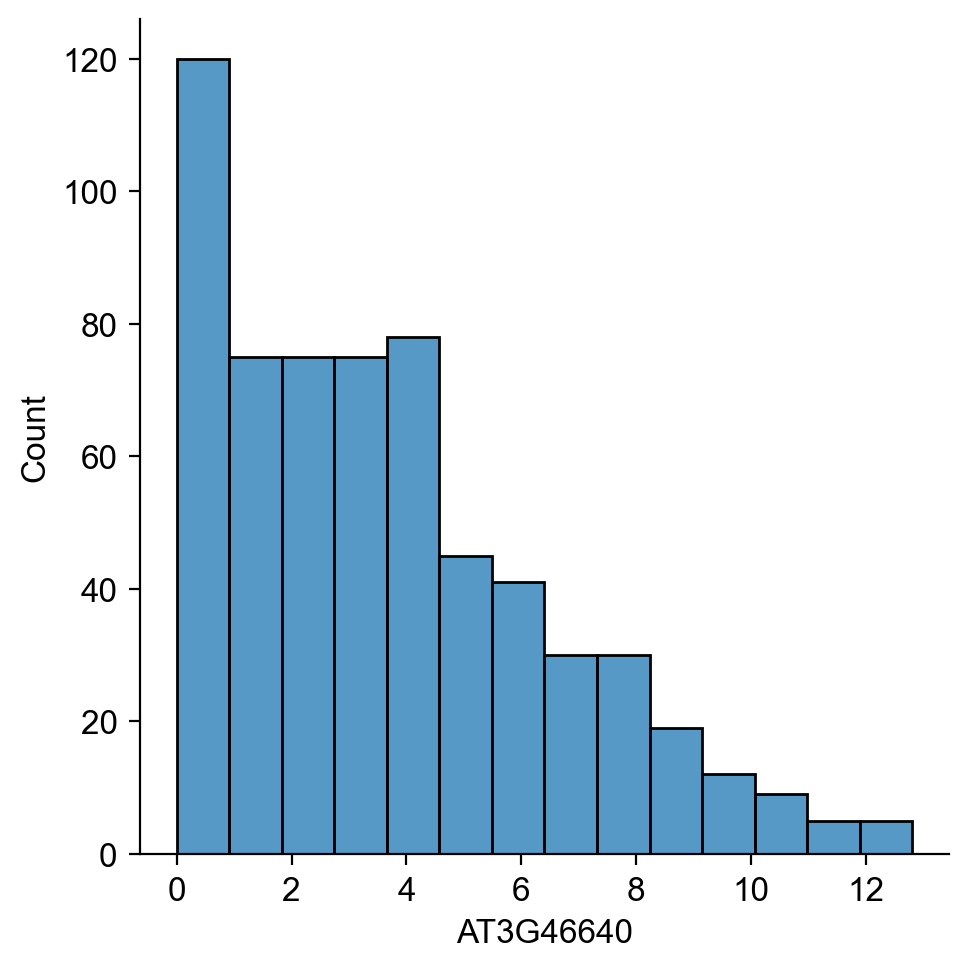

In [45]:
sns.displot(df.set_index("regions").loc['AT3G46640'])

In [46]:
df.set_index("regions").loc['AT3G46640']

AT1G01060    10.60
AT1G01250     3.14
AT1G01260     3.73
AT1G01720     7.55
AT1G02065     5.00
             ...  
AT5G67000    10.80
AT5G67190     8.75
AT5G67300     5.42
AT5G67450     4.10
AT5G67580     5.85
Name: AT3G46640, Length: 619, dtype: float32

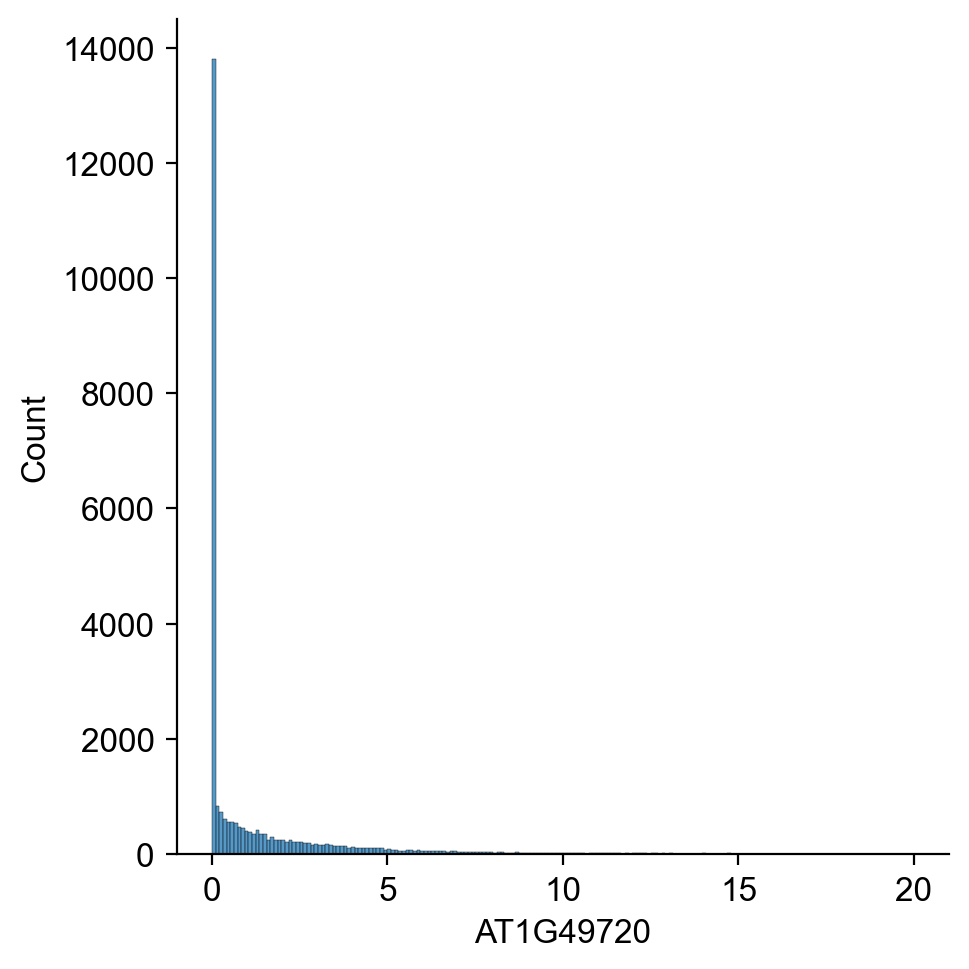

In [27]:
sns.displot(df.set_index("motifs").loc["AT1G49720"])

In [33]:
df.set_index("motifs").loc["AT1G49720"].loc[lambda _: _>2]

AT1G01100    6.54
AT1G01140    5.00
AT1G01160    2.20
AT1G01200    3.24
AT1G01210    3.81
             ... 
ATMG01060    2.88
ATMG01200    3.23
ATMG01210    2.71
ATMG01220    2.89
ATMG01330    3.70
Name: AT1G49720, Length: 5872, dtype: float32

In [26]:
df.set_index("motifs").loc["AT1G49720"].sort_values(ascending=False)

AT4G36590    20.000000
AT4G36600    19.700001
AT5G22190    18.900000
AT1G18100    18.700001
AT1G14205    18.700001
               ...    
AT3G11165     0.000000
AT3G11170     0.000000
AT3G11200     0.000000
AT3G11220     0.000000
ATMG01410     0.000000
Name: AT1G49720, Length: 27655, dtype: float32